In [133]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from textblob import TextBlob
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import nltk
import string
from tabulate import tabulate
from wordcloud import WordCloud

# Dataset

In [134]:
first_df = pd.read_csv(r"C:\Users\gabri\Documents\final_reddit_dataset.csv")
second_df = pd.read_csv(r"C:\Users\gabri\Documents\personal_finance_reddit_dataset.csv")

In [135]:
df = pd.concat([first_df, second_df])

In [136]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 211765 entries, 0 to 60329
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   title                  211765 non-null  object 
 1   post_id                211765 non-null  object 
 2   author                 211765 non-null  object 
 3   submission_date        211765 non-null  object 
 4   score                  211765 non-null  int64  
 5   upvote_ratio           211765 non-null  float64
 6   url                    211765 non-null  object 
 7   num_comments           211765 non-null  int64  
 8   subreddit_subscribers  211765 non-null  int64  
 9   link_flair_text        165257 non-null  object 
 10  submission_comment     209609 non-null  object 
 11  comment_link           211765 non-null  object 
 12  comment                211763 non-null  object 
 13  comment_score          211765 non-null  int64  
 14  comment_created_date   211765 non-null  ob

In [137]:
df.drop_duplicates(inplace=True)

In [138]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 211765 entries, 0 to 60329
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   title                  211765 non-null  object 
 1   post_id                211765 non-null  object 
 2   author                 211765 non-null  object 
 3   submission_date        211765 non-null  object 
 4   score                  211765 non-null  int64  
 5   upvote_ratio           211765 non-null  float64
 6   url                    211765 non-null  object 
 7   num_comments           211765 non-null  int64  
 8   subreddit_subscribers  211765 non-null  int64  
 9   link_flair_text        165257 non-null  object 
 10  submission_comment     209609 non-null  object 
 11  comment_link           211765 non-null  object 
 12  comment                211763 non-null  object 
 13  comment_score          211765 non-null  int64  
 14  comment_created_date   211765 non-null  ob

In [139]:
df2 = df.copy()

In [140]:
df2.head()

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
0,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,"> I have an 800k mortgage, abt 900k self direc...",21,2024-01-06 19:27:20
1,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Sadly with what you have listed you are not a ...,24,2024-01-06 21:54:10
2,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,It’s worth it for the banks.,6,2024-01-06 20:03:49
3,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,My cousin worked in private banking at Scotia....,6,2024-01-06 19:06:26
4,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Private banking could be free if you have all ...,3,2024-01-06 19:06:50


# Cleaning Data

In [141]:
# Assuming df2 is your DataFrame
df2['url'] = df2['url'].astype(str)

# Optionally, fill NaN values with a specific string
df2['url'].fillna('missing_url', inplace=True)

In [142]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 211765 entries, 0 to 60329
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   title                  211765 non-null  object 
 1   post_id                211765 non-null  object 
 2   author                 211765 non-null  object 
 3   submission_date        211765 non-null  object 
 4   score                  211765 non-null  int64  
 5   upvote_ratio           211765 non-null  float64
 6   url                    211765 non-null  object 
 7   num_comments           211765 non-null  int64  
 8   subreddit_subscribers  211765 non-null  int64  
 9   link_flair_text        165257 non-null  object 
 10  submission_comment     209609 non-null  object 
 11  comment_link           211765 non-null  object 
 12  comment                211763 non-null  object 
 13  comment_score          211765 non-null  int64  
 14  comment_created_date   211765 non-null  ob

In [143]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 211765 entries, 0 to 60329
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   title                  211765 non-null  object 
 1   post_id                211765 non-null  object 
 2   author                 211765 non-null  object 
 3   submission_date        211765 non-null  object 
 4   score                  211765 non-null  int64  
 5   upvote_ratio           211765 non-null  float64
 6   url                    211765 non-null  object 
 7   num_comments           211765 non-null  int64  
 8   subreddit_subscribers  211765 non-null  int64  
 9   link_flair_text        165257 non-null  object 
 10  submission_comment     209609 non-null  object 
 11  comment_link           211765 non-null  object 
 12  comment                211763 non-null  object 
 13  comment_score          211765 non-null  int64  
 14  comment_created_date   211765 non-null  ob

# Convert Comment Variables

In [144]:
# Assuming df2 is your DataFrame
df2['comment'] = df2['comment'].astype(str)
df2['submission_comment'] = df2['submission_comment'].astype(str)

In [145]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 211765 entries, 0 to 60329
Data columns (total 15 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   title                  211765 non-null  object 
 1   post_id                211765 non-null  object 
 2   author                 211765 non-null  object 
 3   submission_date        211765 non-null  object 
 4   score                  211765 non-null  int64  
 5   upvote_ratio           211765 non-null  float64
 6   url                    211765 non-null  object 
 7   num_comments           211765 non-null  int64  
 8   subreddit_subscribers  211765 non-null  int64  
 9   link_flair_text        165257 non-null  object 
 10  submission_comment     211765 non-null  object 
 11  comment_link           211765 non-null  object 
 12  comment                211765 non-null  object 
 13  comment_score          211765 non-null  int64  
 14  comment_created_date   211765 non-null  ob

## NLP Process

In [146]:
# Download NLTK resources
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\gabri\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\gabri\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [147]:
# Sample documents
documents = df2['comment'].tolist()

# Sentiment Analysis (Comments to Posts)

In [148]:
def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,118982
1,Neutral,52468
2,Negative,40315


# Sentiment Analysis (Initial Posts)

In [149]:
documents2 = df2['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,3361
1,Negative,747
2,Neutral,222


# Comment to Posts, Running LDA

In [150]:
# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Process

In [151]:
# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create Pipeline

In [152]:
# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['people','just','like','http','did','know','need','make', 'luck', 'gon', 'na', 'doe'], 
                             ngram_range=(2, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the Pipeline

In [153]:
# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

Pipeline(steps=[('vect',
                 CountVectorizer(ngram_range=(2, 3),
                                 stop_words=['people', 'just', 'like', 'http',
                                             'did', 'know', 'need', 'make',
                                             'luck', 'gon', 'na', 'doe'])),
                ('lda',
                 LatentDirichletAllocation(n_components=1, random_state=42))])

# Get the Topic Words

In [154]:
# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

# Determine the Topic Words

In [155]:
for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Create Visualizations

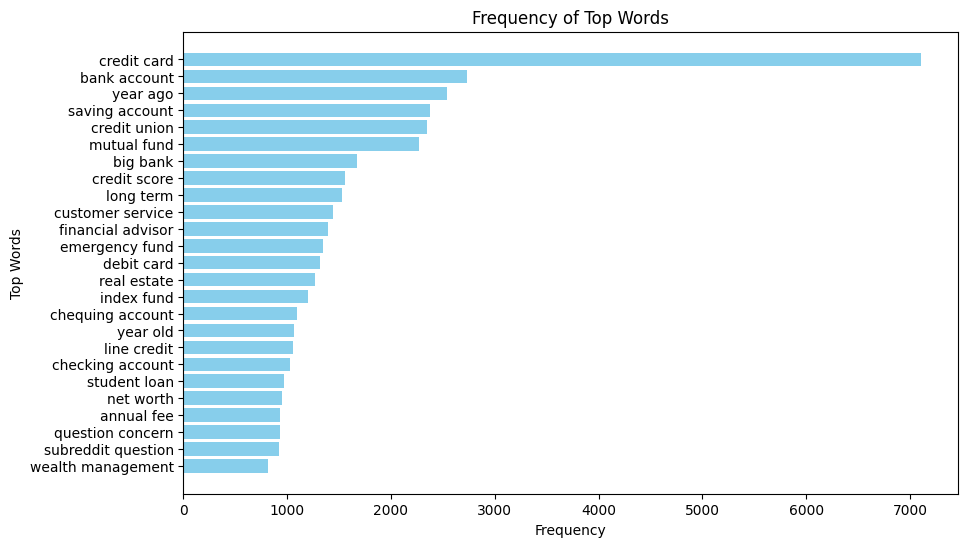

Top Words             Frequency
------------------  -----------
credit card                7111
bank account               2732
year ago                   2537
saving account             2375
credit union               2343
mutual fund                2274
big bank                   1670
credit score               1556
long term                  1525
customer service           1437
financial advisor          1396
emergency fund             1343
debit card                 1314
real estate                1269
index fund                 1200
chequing account           1096
year old                   1068
line credit                1054
checking account           1031
student loan                965
net worth                   954
annual fee                  928
question concern            926
subreddit question          917
wealth management           819


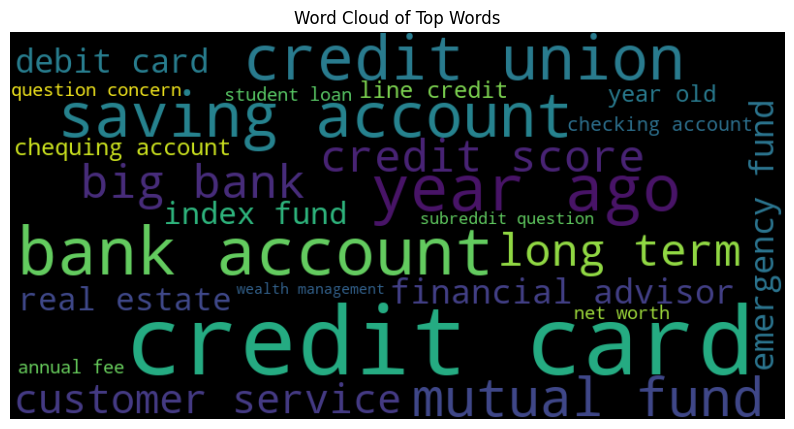

In [156]:
# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

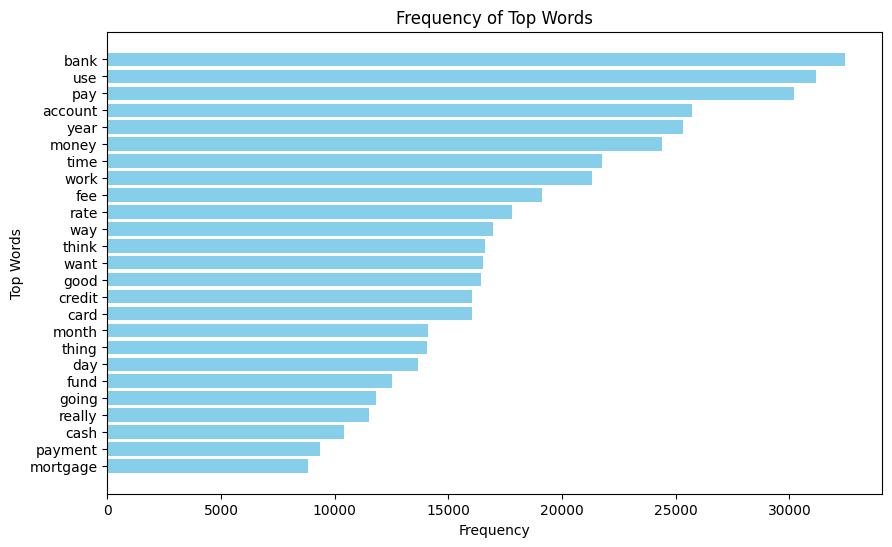

Top Words      Frequency
-----------  -----------
bank               32467
use                31154
pay                30220
account            25714
year               25335
money              24392
time               21743
work               21309
fee                19098
rate               17782
way                16972
think              16618
want               16532
good               16415
credit             16052
card               16037
month              14091
thing              14065
day                13660
fund               12515
going              11800
really             11500
cash               10398
payment             9360
mortgage            8836


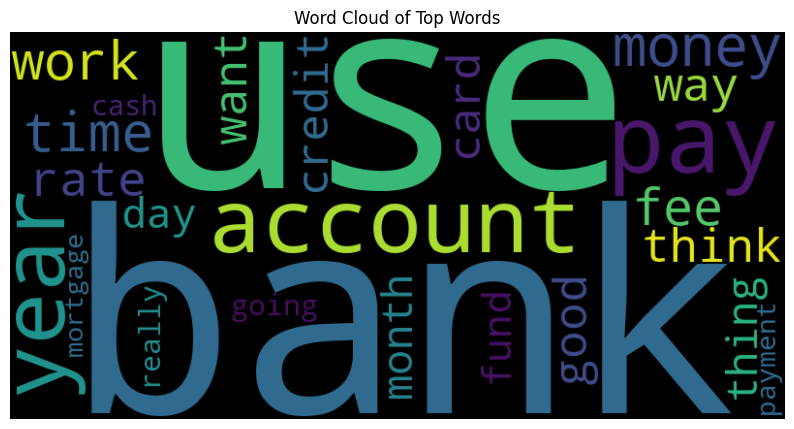

In [157]:
# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['people','just','like','http','did','know','need','make', 'luck', 'gon', 'na', 'doe'], 
                             ngram_range=(1, 1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

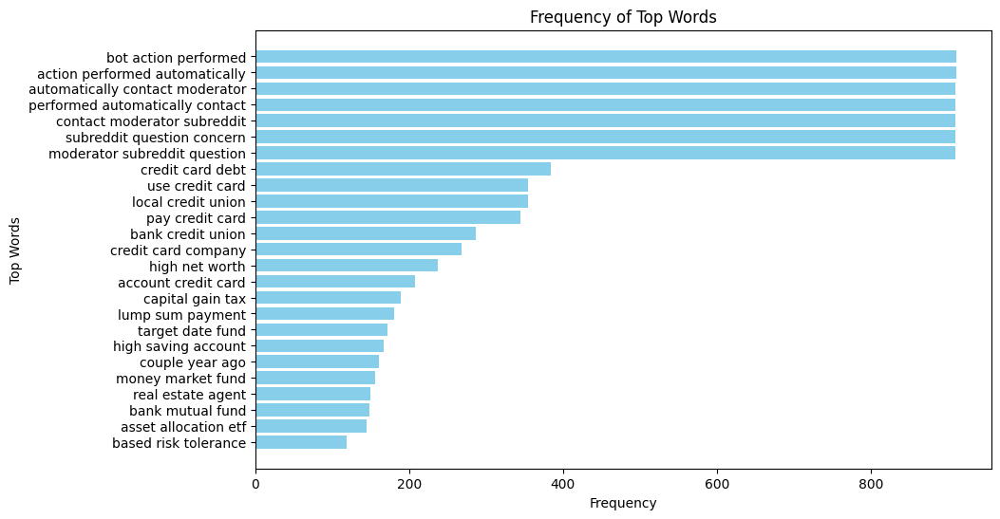

Top Words                          Frequency
-------------------------------  -----------
bot action performed                     911
action performed automatically           911
automatically contact moderator          910
performed automatically contact          910
contact moderator subreddit              910
subreddit question concern               910
moderator subreddit question             910
credit card debt                         384
use credit card                          355
local credit union                       354
pay credit card                          345
bank credit union                        287
credit card company                      268
high net worth                           237
account credit card                      208
capital gain tax                         189
lump sum payment                         180
target date fund                         172
high saving account                      167
couple year ago                          161
money mark

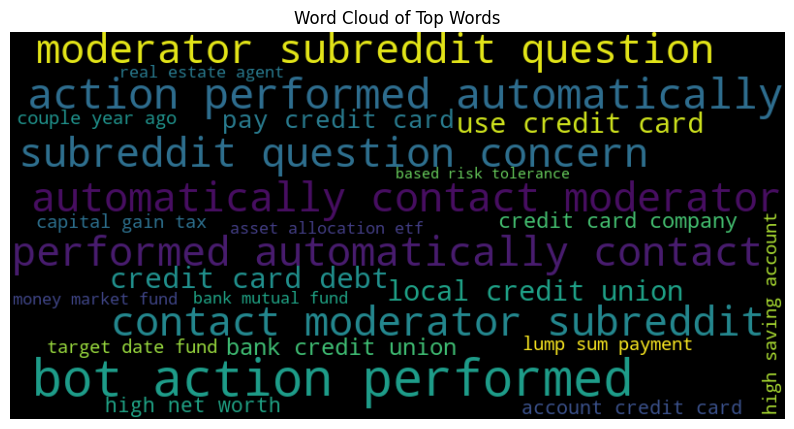

In [158]:
# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['people','just','like','http','did','know','need','make', 'luck', 'gon', 'na', 'doe'], 
                             ngram_range=(3, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

# Same Model for Initial Post

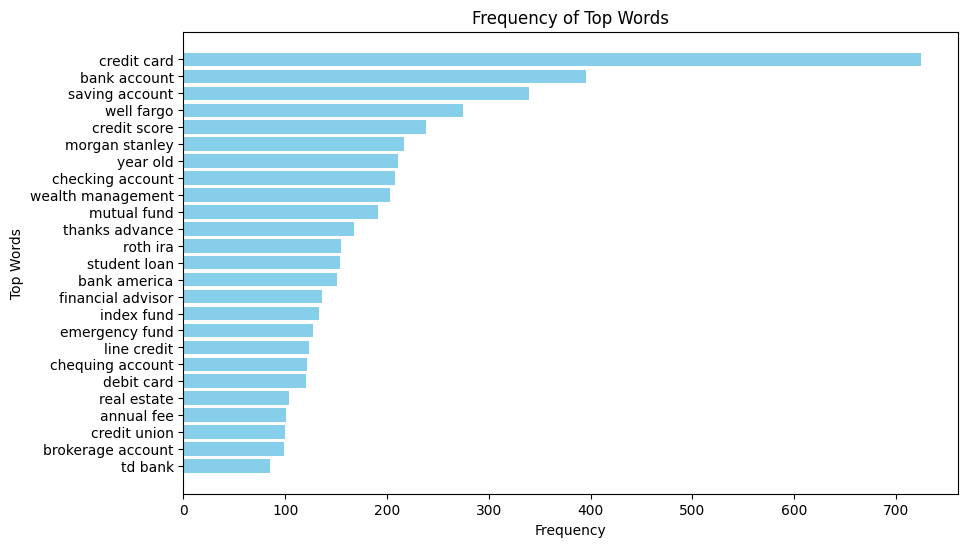

Top Words            Frequency
-----------------  -----------
credit card                725
bank account               395
saving account             339
well fargo                 275
credit score               238
morgan stanley             217
year old                   211
checking account           208
wealth management          203
mutual fund                191
thanks advance             168
roth ira                   155
student loan               154
bank america               151
financial advisor          136
index fund                 133
emergency fund             127
line credit                123
chequing account           121
debit card                 120
real estate                104
annual fee                 101
credit union               100
brokerage account           99
td bank                     85


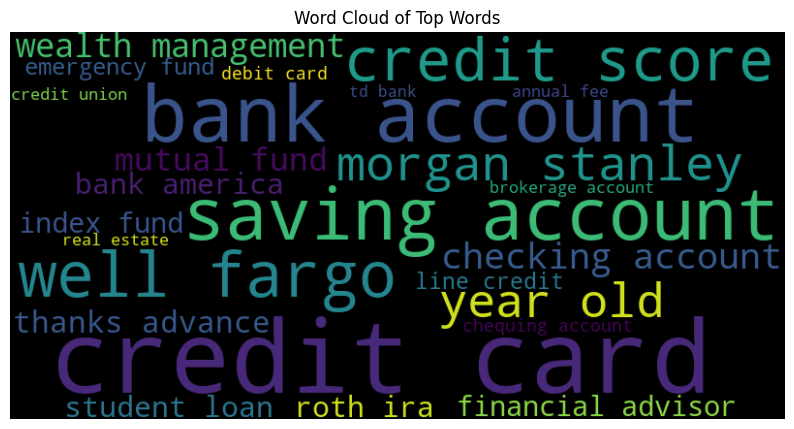

In [159]:
# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['people','just','like','http','did','know','need','make', 'ago', 'past'], 
                             ngram_range=(2, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

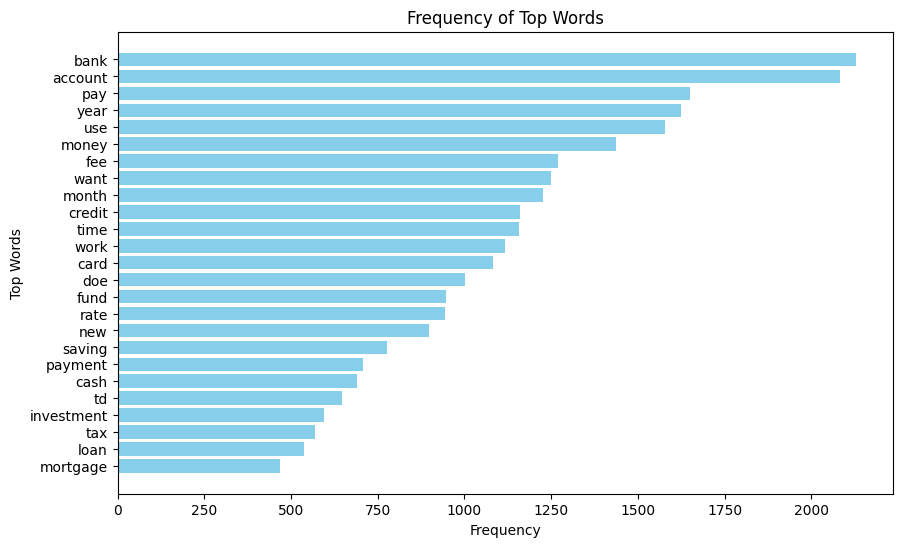

Top Words      Frequency
-----------  -----------
bank                2128
account             2082
pay                 1650
year                1625
use                 1577
money               1438
fee                 1271
want                1251
month               1226
credit              1160
time                1158
work                1117
card                1082
doe                 1002
fund                 946
rate                 943
new                  899
saving               777
payment              707
cash                 690
td                   648
investment           595
tax                  568
loan                 538
mortgage             469


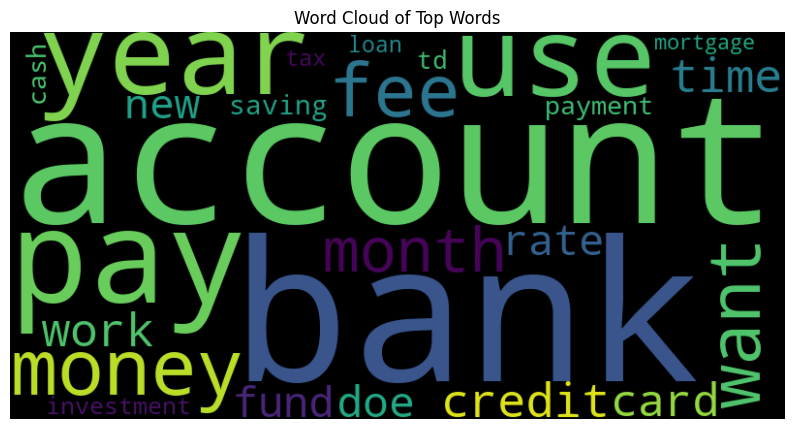

In [160]:
# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['people','just','like','http','did','know','need','make', 'ago', 'past'], 
                             ngram_range=(1, 1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

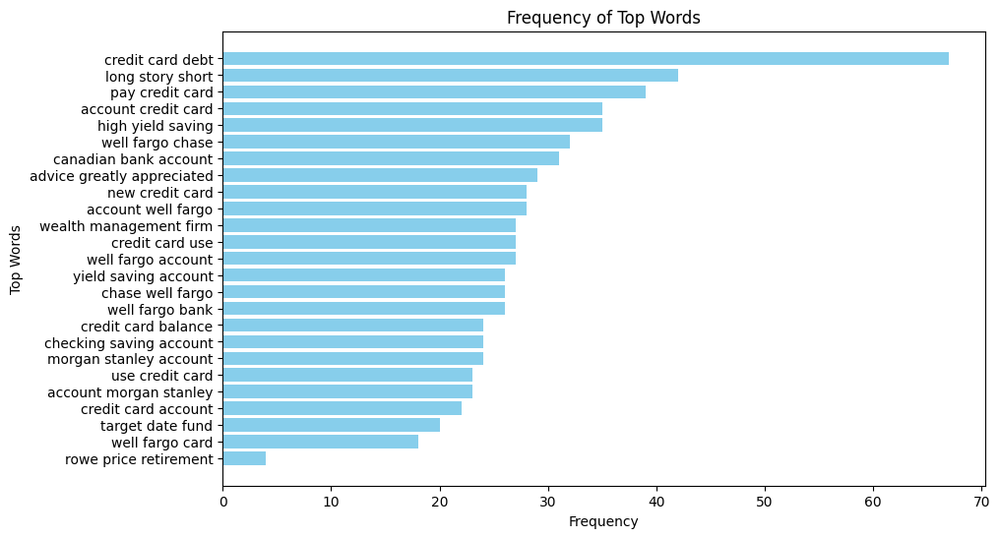

Top Words                     Frequency
--------------------------  -----------
credit card debt                     67
long story short                     42
pay credit card                      39
account credit card                  35
high yield saving                    35
well fargo chase                     32
canadian bank account                31
advice greatly appreciated           29
new credit card                      28
account well fargo                   28
wealth management firm               27
credit card use                      27
well fargo account                   27
yield saving account                 26
chase well fargo                     26
well fargo bank                      26
credit card balance                  24
checking saving account              24
morgan stanley account               24
use credit card                      23
account morgan stanley               23
credit card account                  22
target date fund                     20


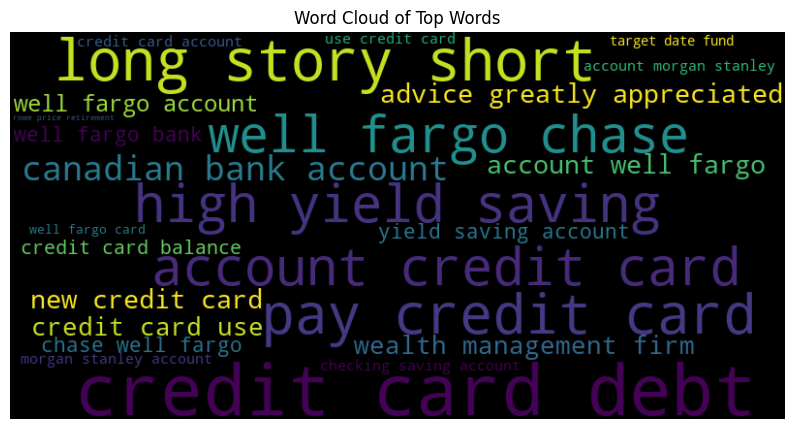

In [161]:
# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['people','just','like','http','did','know','need','make', 'ago', 'past'], 
                             ngram_range=(3, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## CIBC Data

In [162]:
df3 = df2.copy()

# Specify the element you want to filter for in the link
target_element = 'CIBC'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
cibc_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
cibc_df = df3[cibc_values]

# Display the result
cibc_df


,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
9,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Your banking should be free. I have a lower ne...,1,2024-01-07 16:35:26
19,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,No Canadian banks have incoming free wire tran...,1,2023-08-01 20:15:08
20,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,RBC. They have online transfers and their priv...,1,2023-08-01 20:29:15
21,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,[Wise.com](https://Wise.com) is your best bet....,1,2023-09-13 02:30:06
22,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,"i dont need free wire transfers, i need the ab...",1,2023-08-01 21:00:58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197446,"Hey guys, looking for advice on a new bank acc...",15d06aj,LGMatter,2023-07-29 15:08:28,1,0.67,https://www.reddit.com/r/personalfinance/comme...,3,18717073,Saving,"18 years old located in Canada, would like to ...",https://www.reddit.com/r/personalfinance/comme...,America’s unaffordable top hat: /r/PersonalFin...,1,2023-07-29 15:16:52
197447,"Hey guys, looking for advice on a new bank acc...",15d06aj,LGMatter,2023-07-29 15:08:28,1,0.67,https://www.reddit.com/r/personalfinance/comme...,3,18717073,Saving,"18 years old located in Canada, would like to ...",https://www.reddit.com/r/personalfinance/comme...,Just make sure you’re aware that those promos ...,1,2023-07-29 22:57:05
197448,"Hey guys, looking for advice on a new bank acc...",15d06aj,LGMatter,2023-07-29 15:08:28,1,0.67,https://www.reddit.com/r/personalfinance/comme...,3,18717073,Saving,"18 years old located in Canada, would like to ...",https://www.reddit.com/r/personalfinance/comme...,I didn’t even know this existed. Thank you,1,2023-07-29 15:18:46
209861,Transferring Money to a US account from a Cana...,19dxrcy,canakiwi,2024-01-23 15:14:38,1,1.00,https://www.reddit.com/r/personalfinance/comme...,9,18717204,Saving,"I admit, I am confused. \nI have to fund an ...",https://www.reddit.com/r/personalfinance/comme...,I am using Simplii the online part of CIBC. I ...,1,2024-01-23 19:48:00


In [163]:
# Sample documents
documents = cibc_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,14479
1,Neutral,7698
2,Negative,5968


In [164]:
documents2 = cibc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,499
1,Negative,143
2,Neutral,47


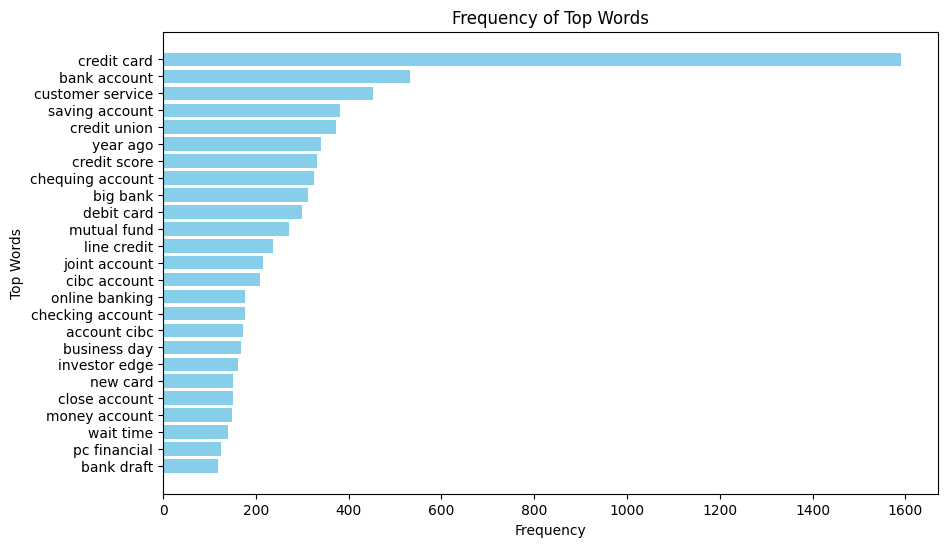

Top Words           Frequency
----------------  -----------
credit card              1591
bank account              533
customer service          452
saving account            382
credit union              372
year ago                  340
credit score              331
chequing account          325
big bank                  313
debit card                300
mutual fund               271
line credit               237
joint account             215
cibc account              210
online banking            177
checking account          176
account cibc              173
business day              168
investor edge             161
new card                  151
close account             150
money account             149
wait time                 140
pc financial              124
bank draft                118


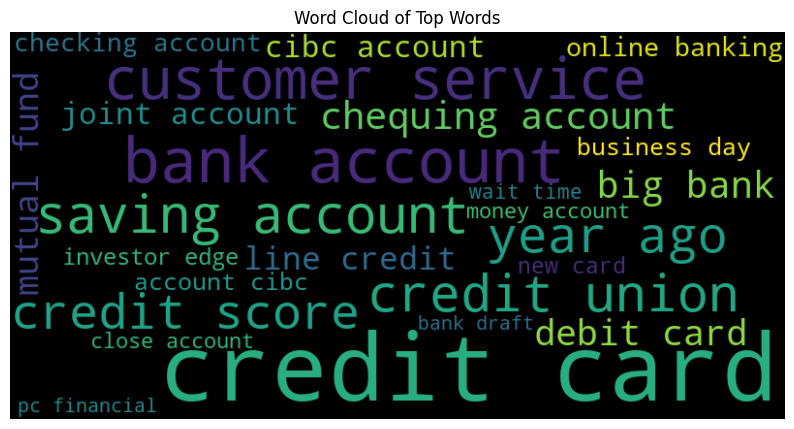

In [165]:
# Sample documents
documents = cibc_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'make','need', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

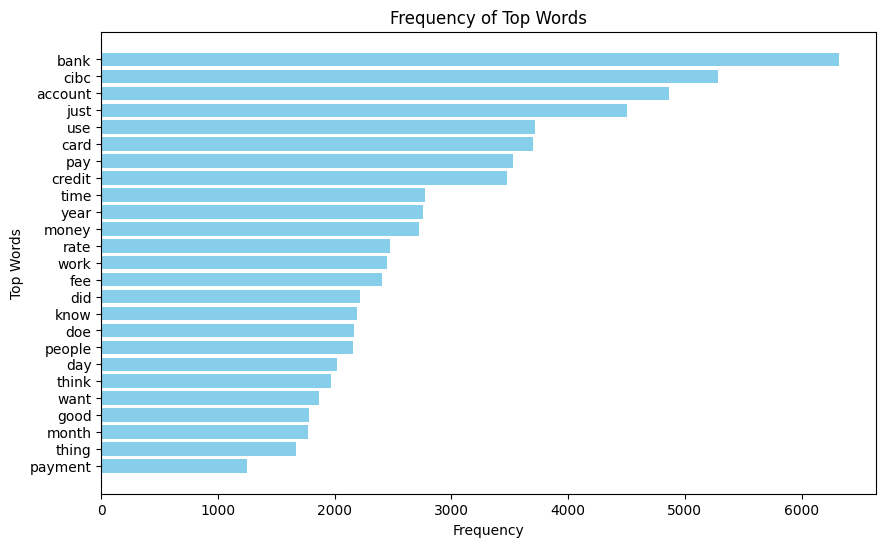

Top Words      Frequency
-----------  -----------
bank                6323
cibc                5284
account             4860
just                4502
use                 3716
card                3699
pay                 3525
credit              3472
time                2775
year                2758
money               2724
rate                2474
work                2450
fee                 2402
did                 2215
know                2191
doe                 2164
people              2157
day                 2021
think               1969
want                1868
good                1783
month               1769
thing               1666
payment             1250


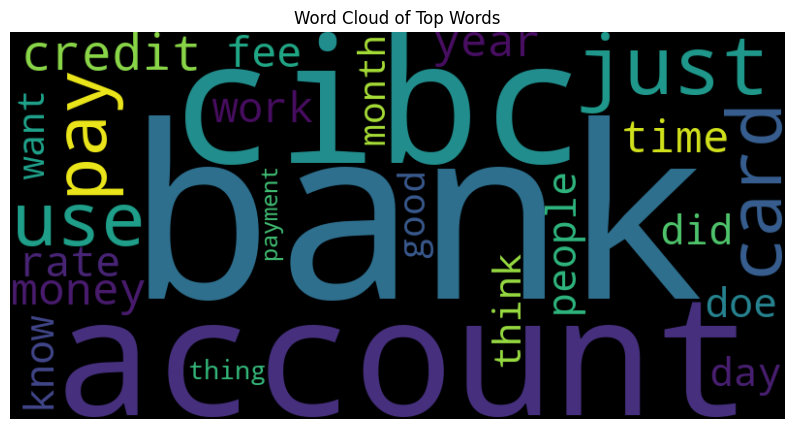

In [166]:
# Sample documents
documents = cibc_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'make','need', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

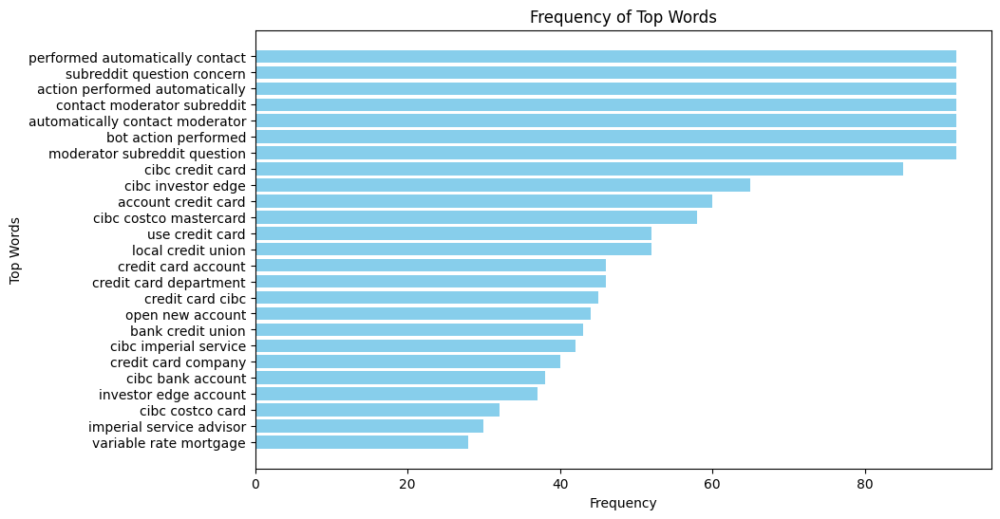

Top Words                          Frequency
-------------------------------  -----------
performed automatically contact           92
subreddit question concern                92
action performed automatically            92
contact moderator subreddit               92
automatically contact moderator           92
bot action performed                      92
moderator subreddit question              92
cibc credit card                          85
cibc investor edge                        65
account credit card                       60
cibc costco mastercard                    58
use credit card                           52
local credit union                        52
credit card account                       46
credit card department                    46
credit card cibc                          45
open new account                          44
bank credit union                         43
cibc imperial service                     42
credit card company                       40
cibc bank 

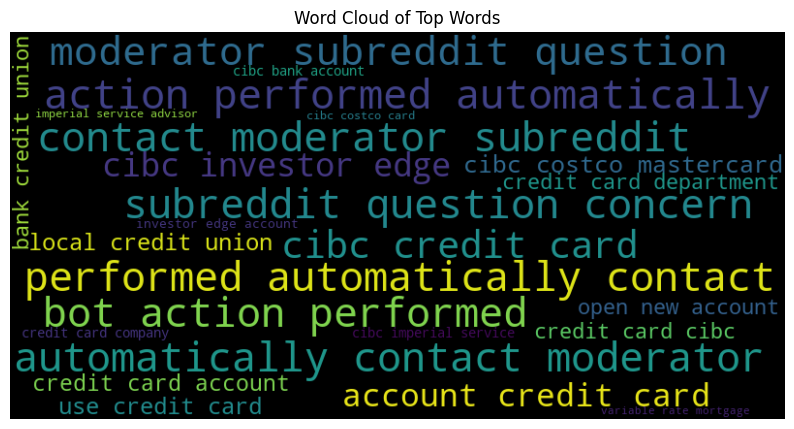

In [167]:
# Sample documents
documents = cibc_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'make','need', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

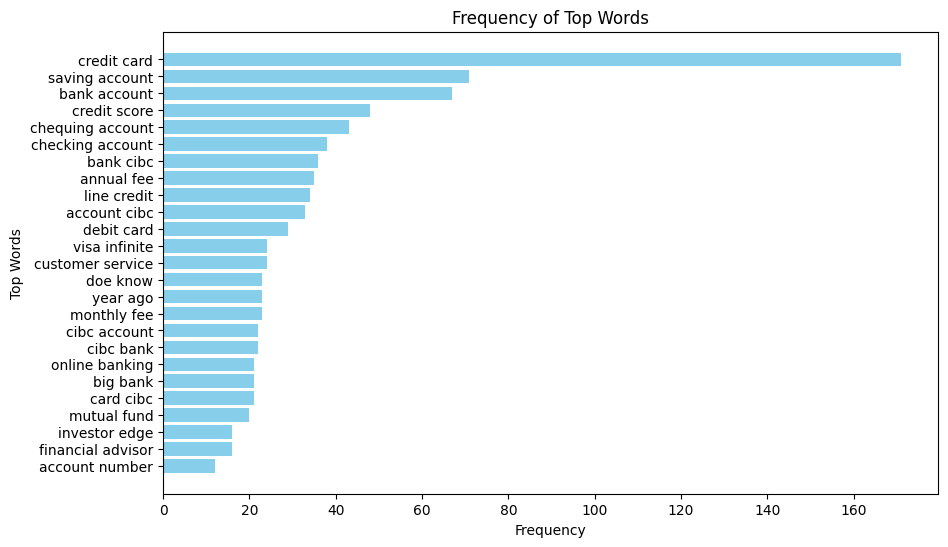

Top Words            Frequency
-----------------  -----------
credit card                171
saving account              71
bank account                67
credit score                48
chequing account            43
checking account            38
bank cibc                   36
annual fee                  35
line credit                 34
account cibc                33
debit card                  29
visa infinite               24
customer service            24
doe know                    23
year ago                    23
monthly fee                 23
cibc account                22
cibc bank                   22
online banking              21
big bank                    21
card cibc                   21
mutual fund                 20
investor edge               16
financial advisor           16
account number              12


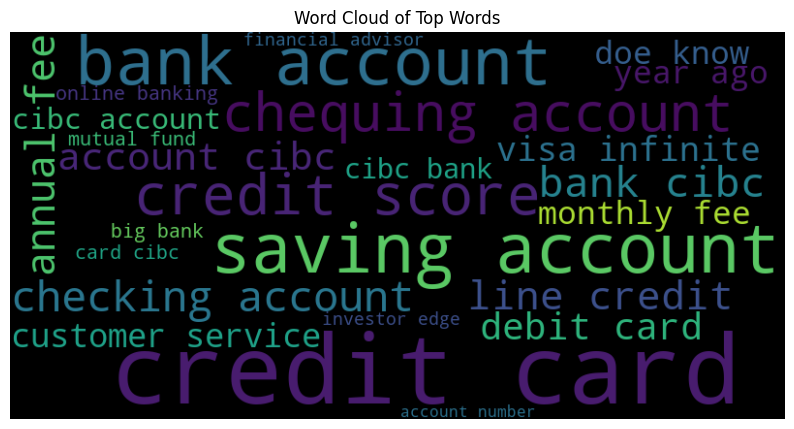

In [168]:
documents2 = cibc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

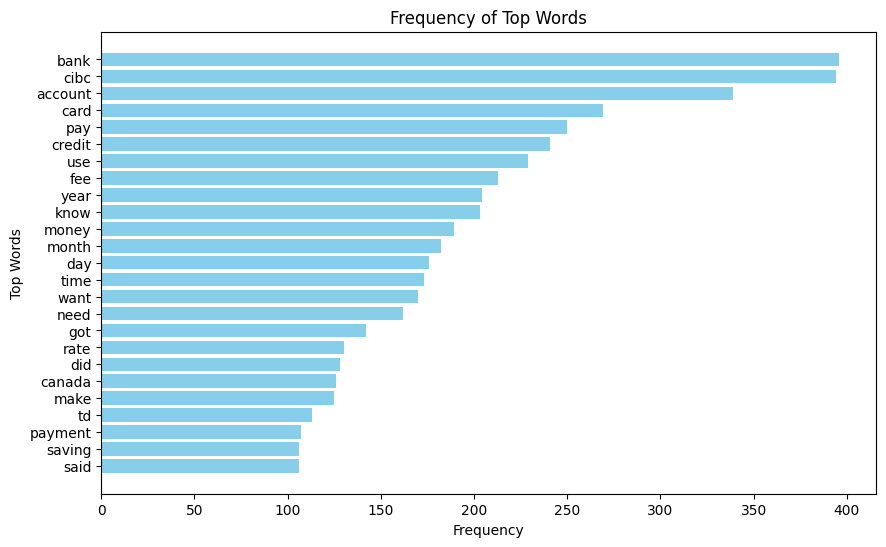

Top Words      Frequency
-----------  -----------
bank                 396
cibc                 394
account              339
card                 269
pay                  250
credit               241
use                  229
fee                  213
year                 204
know                 203
money                189
month                182
day                  176
time                 173
want                 170
need                 162
got                  142
rate                 130
did                  128
canada               126
make                 125
td                   113
payment              107
saving               106
said                 106


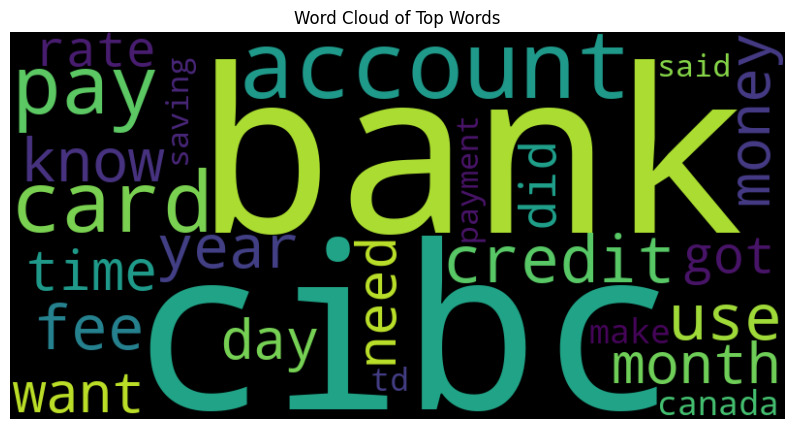

In [169]:
documents2 = cibc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

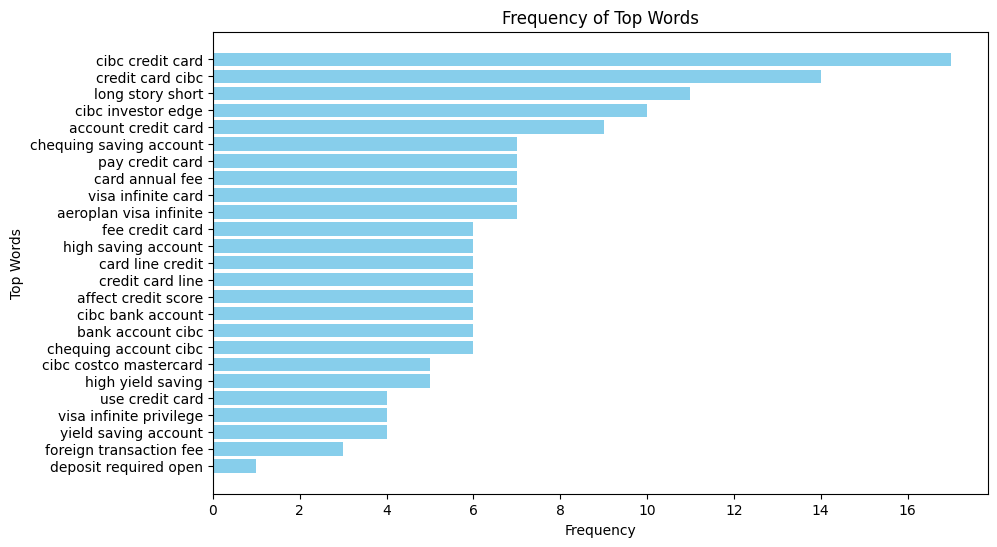

Top Words                  Frequency
-----------------------  -----------
cibc credit card                  17
credit card cibc                  14
long story short                  11
cibc investor edge                10
account credit card                9
chequing saving account            7
pay credit card                    7
card annual fee                    7
visa infinite card                 7
aeroplan visa infinite             7
fee credit card                    6
high saving account                6
card line credit                   6
credit card line                   6
affect credit score                6
cibc bank account                  6
bank account cibc                  6
chequing account cibc              6
cibc costco mastercard             5
high yield saving                  5
use credit card                    4
visa infinite privilege            4
yield saving account               4
foreign transaction fee            3
deposit required open              1


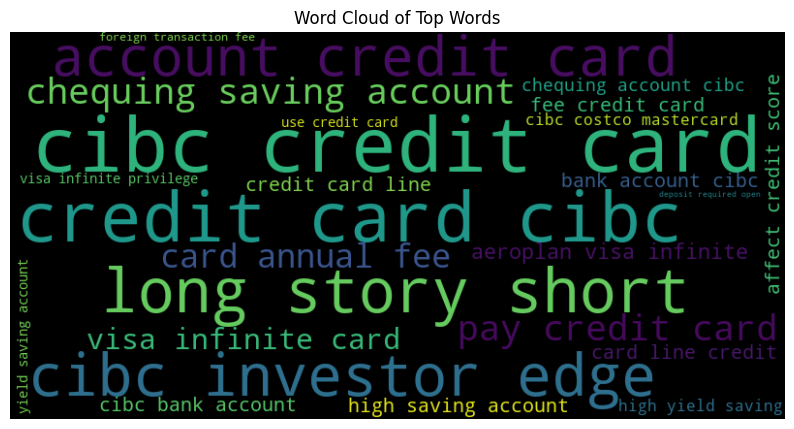

In [170]:
documents2 = cibc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## RBC Dataset

In [171]:
# Specify the element you want to filter for in the link
target_element = 'rbc'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
rbc_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
rbc_df = df3[rbc_values]

# Display the result
rbc_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
0,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,"> I have an 800k mortgage, abt 900k self direc...",21,2024-01-06 19:27:20
1,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Sadly with what you have listed you are not a ...,24,2024-01-06 21:54:10
2,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,It’s worth it for the banks.,6,2024-01-06 20:03:49
3,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,My cousin worked in private banking at Scotia....,6,2024-01-06 19:06:26
4,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Private banking could be free if you have all ...,3,2024-01-06 19:06:50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209493,The CFP Board is expanding fiduciary duty for ...,9uendp,dequeued,2018-11-05 10:51:31,3415,0.94,https://www.reddit.com/r/personalfinance/comme...,316,18717204,Planning,# What's Happening with Certified Financial Pl...,https://www.reddit.com/r/personalfinance/comme...,"I thought there were two fees, one at the fund...",1,2018-11-06 00:06:31
209494,The CFP Board is expanding fiduciary duty for ...,9uendp,dequeued,2018-11-05 10:51:31,3415,0.94,https://www.reddit.com/r/personalfinance/comme...,316,18717204,Planning,# What's Happening with Certified Financial Pl...,https://www.reddit.com/r/personalfinance/comme...,"While my request was meant in jest, I apprecia...",1,2018-11-06 07:09:23
209495,The CFP Board is expanding fiduciary duty for ...,9uendp,dequeued,2018-11-05 10:51:31,3415,0.94,https://www.reddit.com/r/personalfinance/comme...,316,18717204,Planning,# What's Happening with Certified Financial Pl...,https://www.reddit.com/r/personalfinance/comme...,Here's three from a 10-second Google Scholar s...,1,2018-11-07 08:51:57
209496,The CFP Board is expanding fiduciary duty for ...,9uendp,dequeued,2018-11-05 10:51:31,3415,0.94,https://www.reddit.com/r/personalfinance/comme...,316,18717204,Planning,# What's Happening with Certified Financial Pl...,https://www.reddit.com/r/personalfinance/comme...,"That would be an advisory fee, which you can o...",2,2018-11-06 00:19:32


In [172]:
# Sample documents
documents = rbc_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,13871
1,Neutral,6588
2,Negative,4989


In [173]:
documents2 = rbc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,659
1,Negative,185
2,Neutral,69


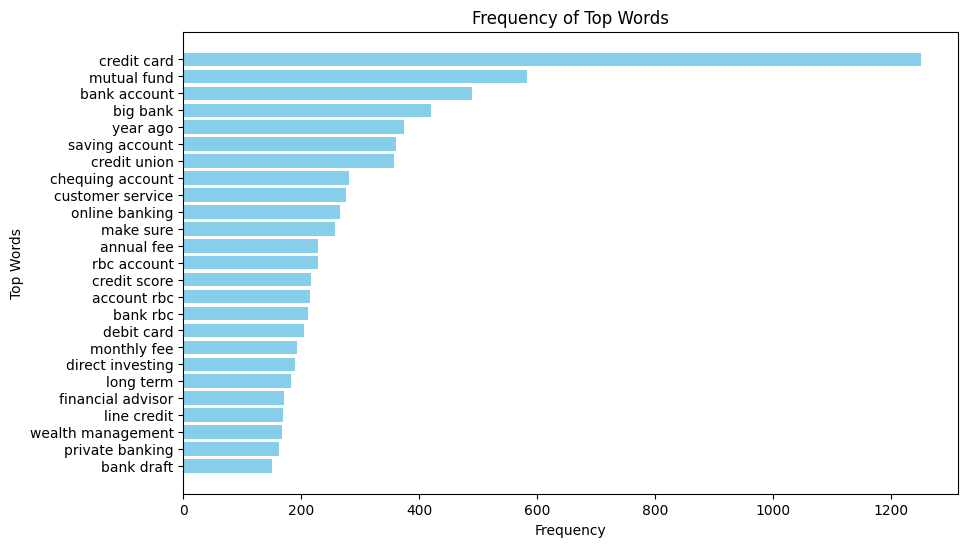

Top Words            Frequency
-----------------  -----------
credit card               1252
mutual fund                583
bank account               489
big bank                   420
year ago                   375
saving account             361
credit union               358
chequing account           281
customer service           276
online banking             266
make sure                  257
annual fee                 228
rbc account                228
credit score               216
account rbc                214
bank rbc                   211
debit card                 204
monthly fee                193
direct investing           190
long term                  182
financial advisor          171
line credit                169
wealth management          167
private banking            163
bank draft                 150


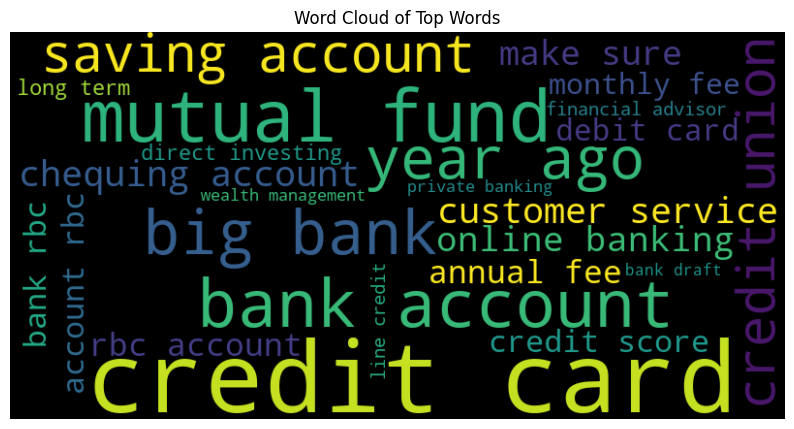

In [174]:
# Sample documents
documents = rbc_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

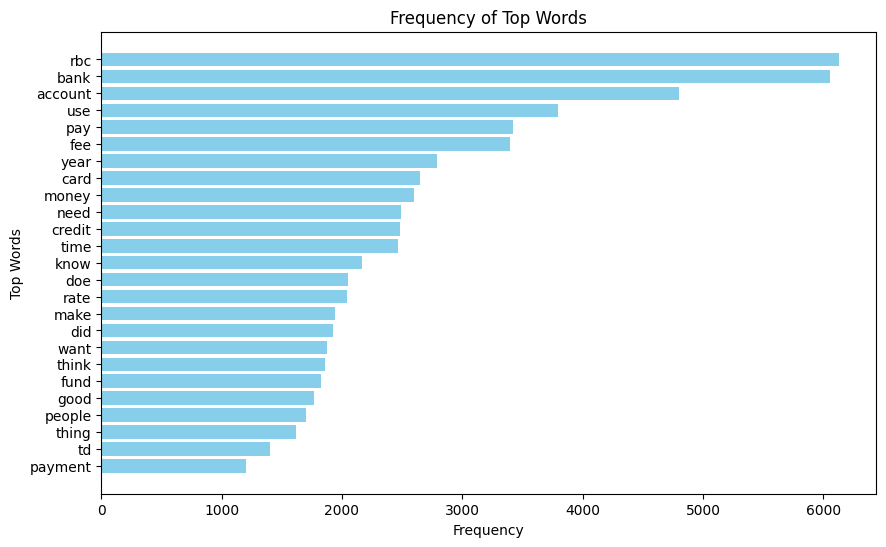

Top Words      Frequency
-----------  -----------
rbc                 6133
bank                6052
account             4799
use                 3795
pay                 3417
fee                 3398
year                2789
card                2650
money               2596
need                2490
credit              2479
time                2469
know                2169
doe                 2046
rate                2040
make                1939
did                 1929
want                1876
think               1858
fund                1822
good                1765
people              1702
thing               1622
td                  1402
payment             1201


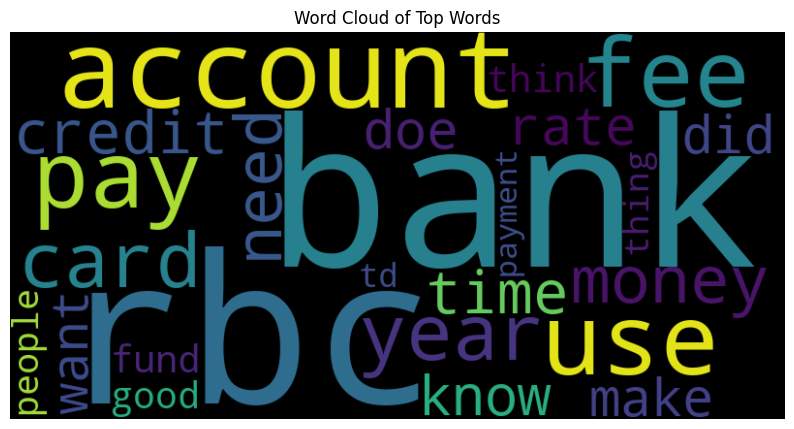

In [175]:
# Sample documents
documents = rbc_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

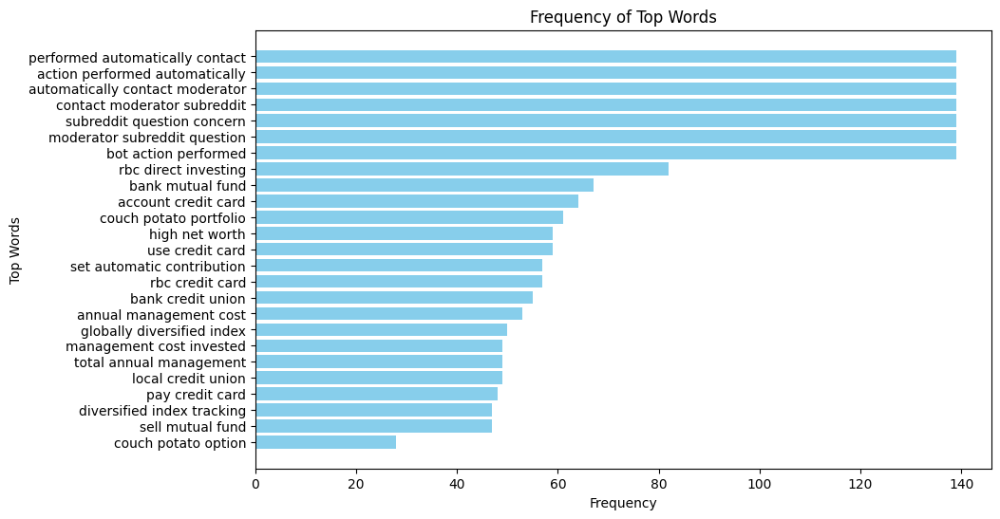

Top Words                          Frequency
-------------------------------  -----------
performed automatically contact          139
action performed automatically           139
automatically contact moderator          139
contact moderator subreddit              139
subreddit question concern               139
moderator subreddit question             139
bot action performed                     139
rbc direct investing                      82
bank mutual fund                          67
account credit card                       64
couch potato portfolio                    61
high net worth                            59
use credit card                           59
set automatic contribution                57
rbc credit card                           57
bank credit union                         55
annual management cost                    53
globally diversified index                50
management cost invested                  49
total annual management                   49
local cred

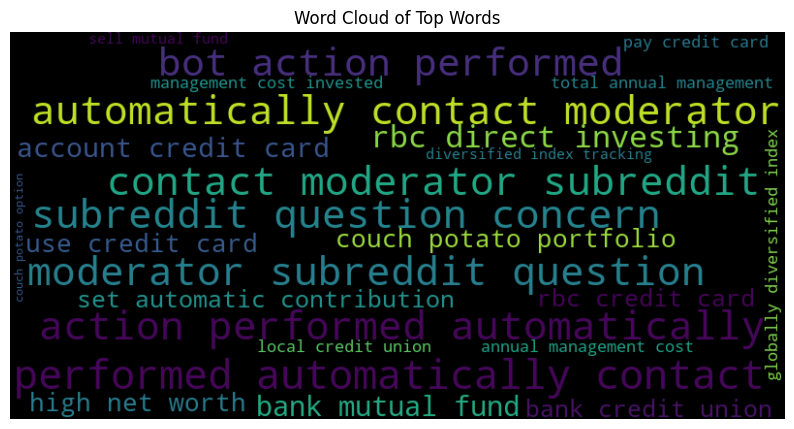

In [176]:
# Sample documents
documents = rbc_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

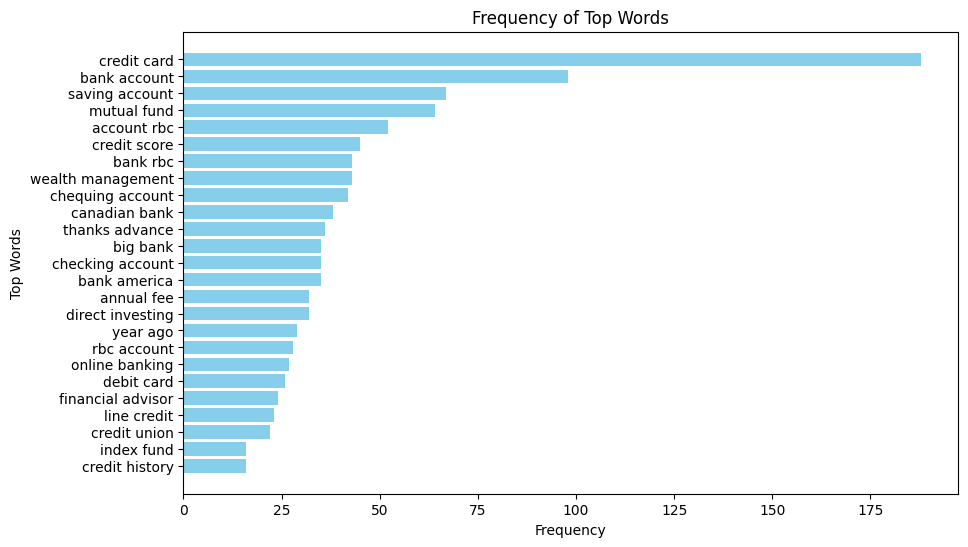

Top Words            Frequency
-----------------  -----------
credit card                188
bank account                98
saving account              67
mutual fund                 64
account rbc                 52
credit score                45
bank rbc                    43
wealth management           43
chequing account            42
canadian bank               38
thanks advance              36
big bank                    35
checking account            35
bank america                35
annual fee                  32
direct investing            32
year ago                    29
rbc account                 28
online banking              27
debit card                  26
financial advisor           24
line credit                 23
credit union                22
index fund                  16
credit history              16


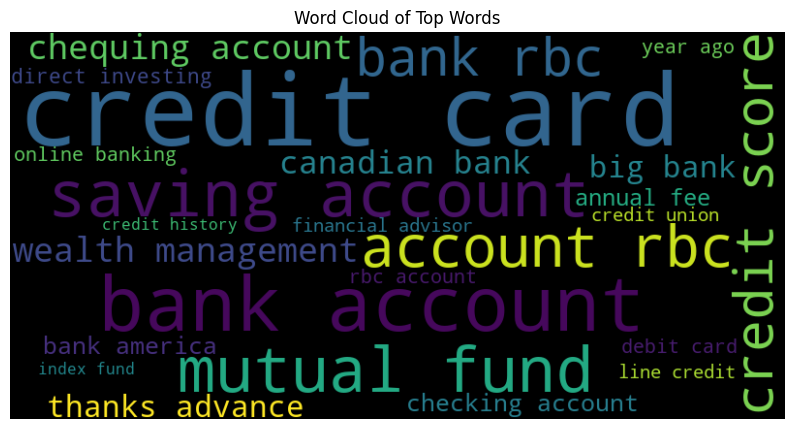

In [177]:
documents2 = rbc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

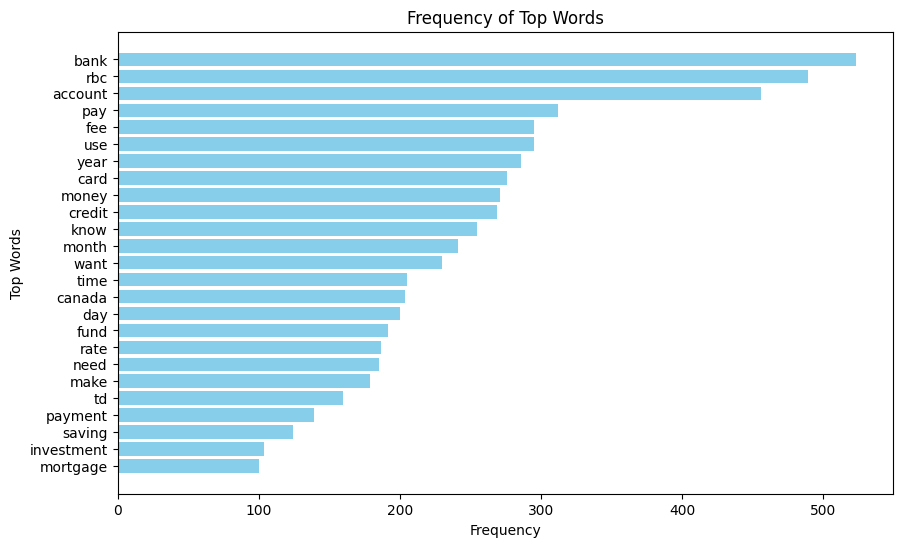

Top Words      Frequency
-----------  -----------
bank                 523
rbc                  489
account              456
pay                  312
fee                  295
use                  295
year                 286
card                 276
money                271
credit               269
know                 255
month                241
want                 230
time                 205
canada               204
day                  200
fund                 192
rate                 187
need                 185
make                 179
td                   160
payment              139
saving               124
investment           104
mortgage             100


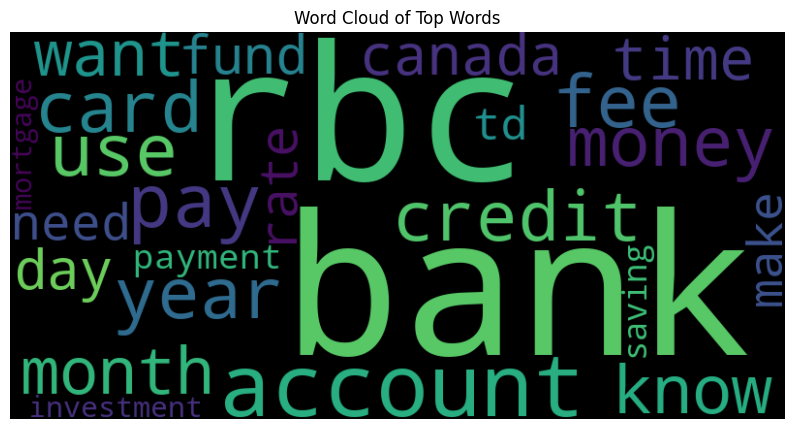

In [178]:
documents2 = rbc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

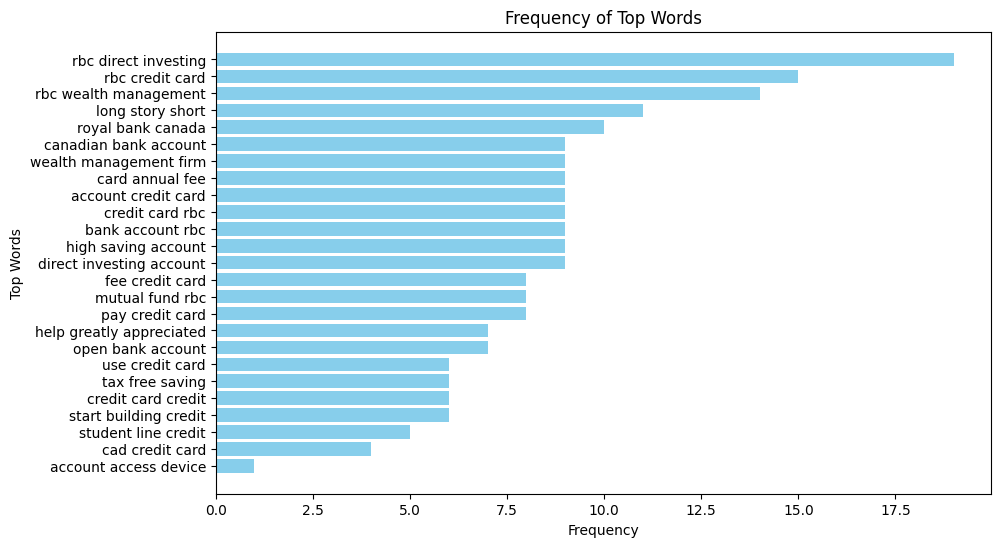

Top Words                   Frequency
------------------------  -----------
rbc direct investing               19
rbc credit card                    15
rbc wealth management              14
long story short                   11
royal bank canada                  10
canadian bank account               9
wealth management firm              9
card annual fee                     9
account credit card                 9
credit card rbc                     9
bank account rbc                    9
high saving account                 9
direct investing account            9
fee credit card                     8
mutual fund rbc                     8
pay credit card                     8
help greatly appreciated            7
open bank account                   7
use credit card                     6
tax free saving                     6
credit card credit                  6
start building credit               6
student line credit                 5
cad credit card                     4
account acce

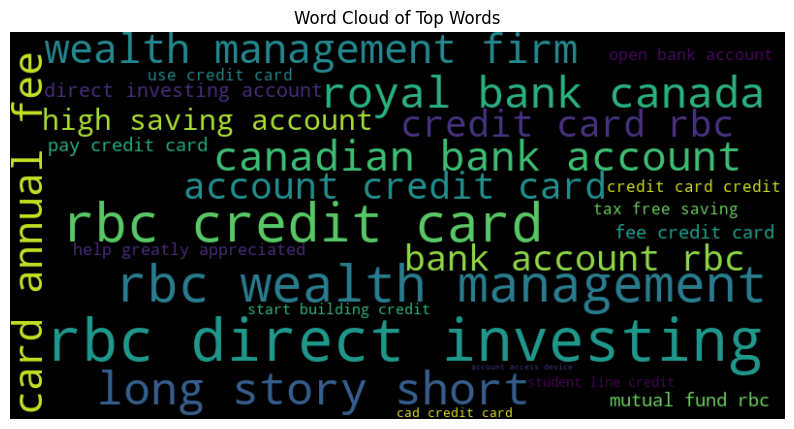

In [179]:
documents2 = rbc_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## TD Dataset

In [180]:
# Specify the element you want to filter for in the link
target_element = 'tdbank'
target = 'TD'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
TD_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target, case=False) | df3['submission_comment'].str.contains(target, case=False)

# Apply the mask to subset the DataFrame
TD_df = df3[TD_values]

# Display the result
TD_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
19,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,No Canadian banks have incoming free wire tran...,1,2023-08-01 20:15:08
20,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,RBC. They have online transfers and their priv...,1,2023-08-01 20:29:15
21,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,[Wise.com](https://Wise.com) is your best bet....,1,2023-09-13 02:30:06
22,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,"i dont need free wire transfers, i need the ab...",1,2023-08-01 21:00:58
23,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,thanks ill check them out,1,2023-08-01 21:01:11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211405,Where the heck are my capital gains to date in...,n2mps0,lydiajanewilliams,2021-05-01 13:15:15,0,0.33,https://www.reddit.com/r/personalfinance/comme...,4,18717209,Investing,Can someone please guide me where I can find m...,https://www.reddit.com/r/personalfinance/comme...,Thank you!! That’s the one! 🙌🏻,2,2021-05-01 13:19:52
211459,Why invest in s&p 500 index and other market f...,p7nvg8,hinsonan,2021-08-19 17:16:41,0,0.48,https://www.reddit.com/r/personalfinance/comme...,27,18717209,Retirement,This investment would be for a retirement acco...,https://www.reddit.com/r/personalfinance/comme...,Fidelity blue chip has lagged the s&p500 YTD.,2,2021-08-19 17:46:18
211547,Live-in boyfriend started at a hedge fund. Can...,75sjjh,fuckinghedgefunds,2017-10-11 18:07:33,69,0.80,https://www.reddit.com/r/personalfinance/comme...,54,18717209,Investing,Hi! Throwaway because I don't like talking abo...,https://www.reddit.com/r/personalfinance/comme...,You should ask your boyfriend for a printed co...,10,2017-10-11 19:21:52
211560,Live-in boyfriend started at a hedge fund. Can...,75sjjh,fuckinghedgefunds,2017-10-11 18:07:33,69,0.80,https://www.reddit.com/r/personalfinance/comme...,54,18717209,Investing,Hi! Throwaway because I don't like talking abo...,https://www.reddit.com/r/personalfinance/comme...,Work in the industry. There are two big parts ...,1,2017-10-12 10:33:08


In [181]:
# Sample documents
documents = TD_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,15983
1,Neutral,6837
2,Negative,5473


In [182]:
documents2 = TD_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,941
1,Negative,243
2,Neutral,75


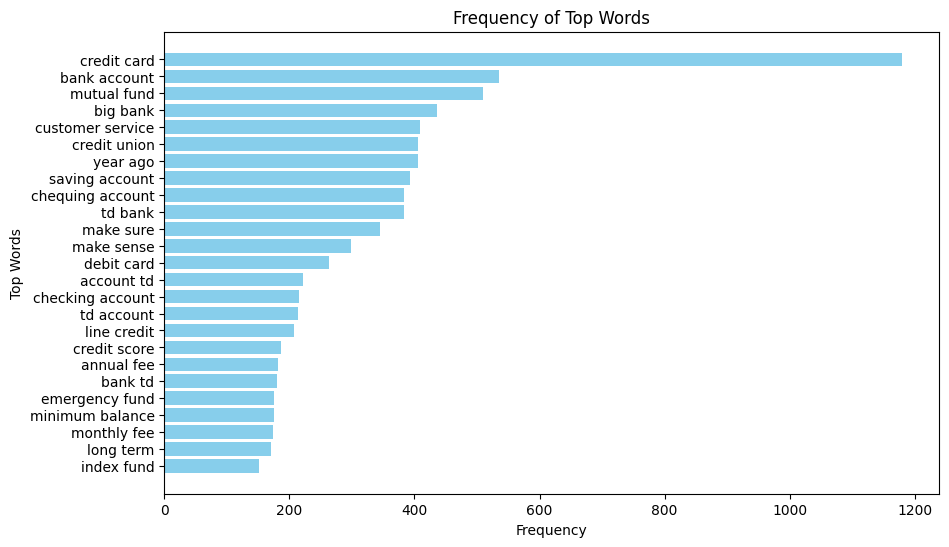

Top Words           Frequency
----------------  -----------
credit card              1180
bank account              535
mutual fund               509
big bank                  436
customer service          409
credit union              405
year ago                  405
saving account            393
chequing account          384
td bank                   383
make sure                 345
make sense                299
debit card                264
account td                222
checking account          216
td account                214
line credit               207
credit score              187
annual fee                182
bank td                   181
emergency fund            175
minimum balance           175
monthly fee               174
long term                 170
index fund                152


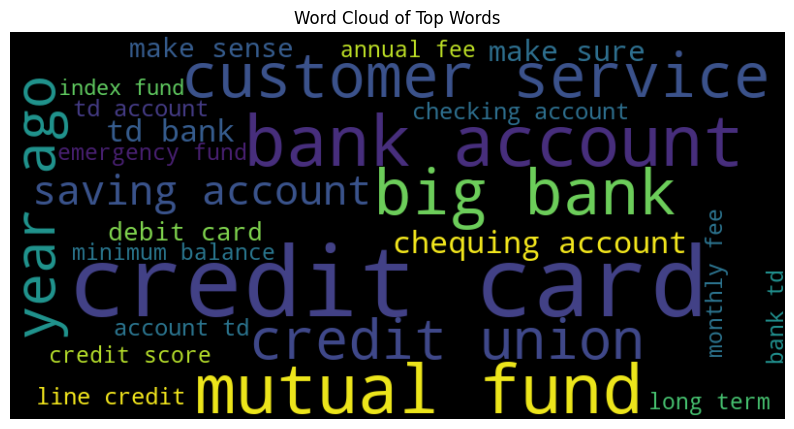

In [183]:
# Sample documents
documents = TD_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

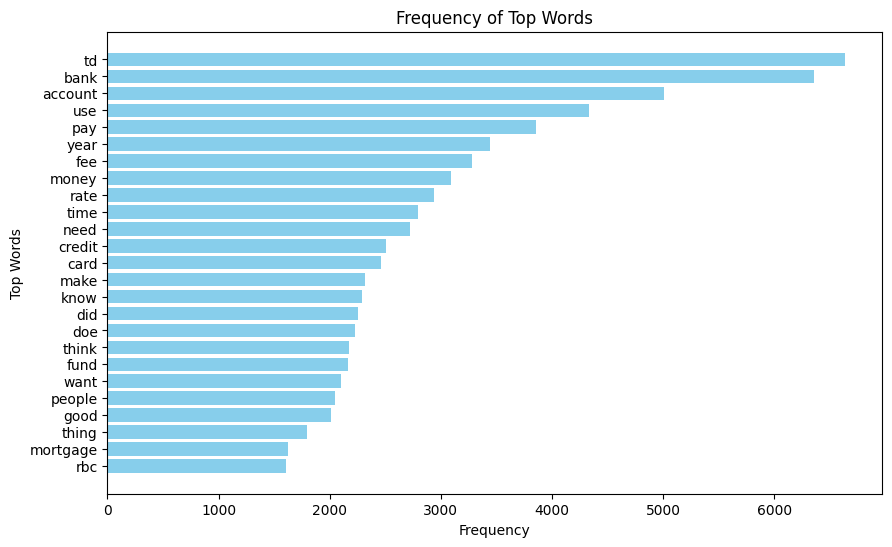

Top Words      Frequency
-----------  -----------
td                  6642
bank                6363
account             5013
use                 4334
pay                 3857
year                3443
fee                 3281
money               3090
rate                2941
time                2797
need                2723
credit              2505
card                2461
make                2321
know                2290
did                 2257
doe                 2231
think               2176
fund                2167
want                2100
people              2048
good                2011
thing               1795
mortgage            1628
rbc                 1611


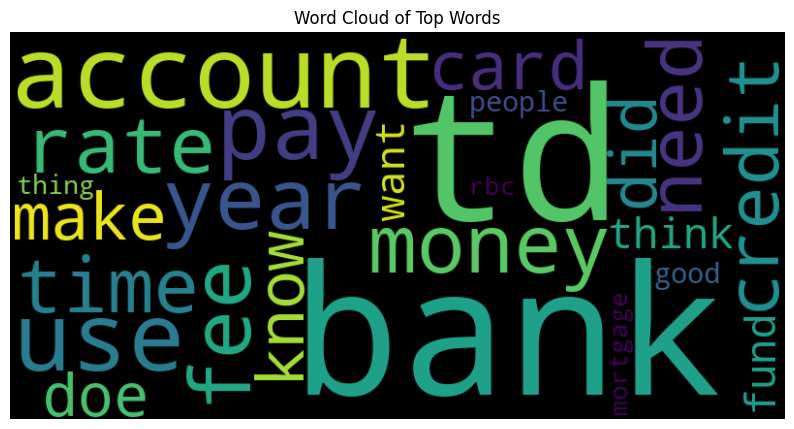

In [184]:
# Sample documents
documents = TD_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

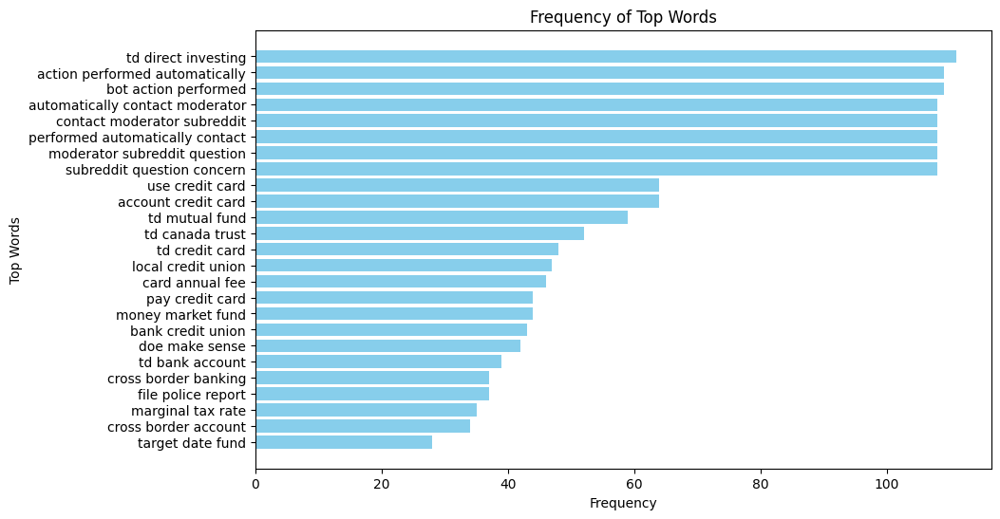

Top Words                          Frequency
-------------------------------  -----------
td direct investing                      111
action performed automatically           109
bot action performed                     109
automatically contact moderator          108
contact moderator subreddit              108
performed automatically contact          108
moderator subreddit question             108
subreddit question concern               108
use credit card                           64
account credit card                       64
td mutual fund                            59
td canada trust                           52
td credit card                            48
local credit union                        47
card annual fee                           46
pay credit card                           44
money market fund                         44
bank credit union                         43
doe make sense                            42
td bank account                           39
cross bord

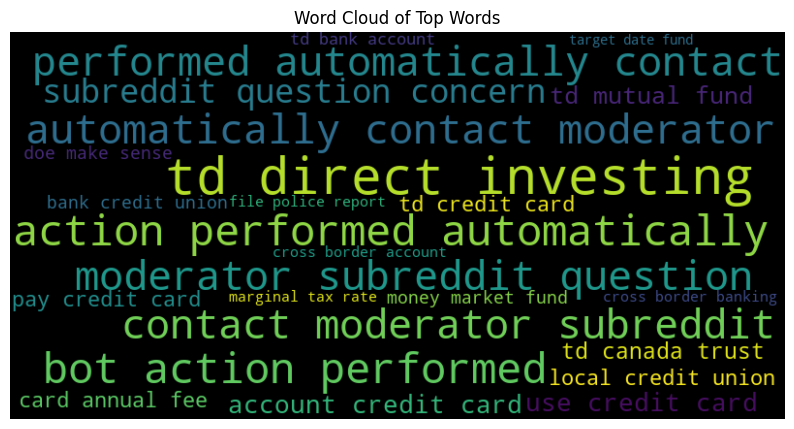

In [185]:
# Sample documents
documents = TD_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

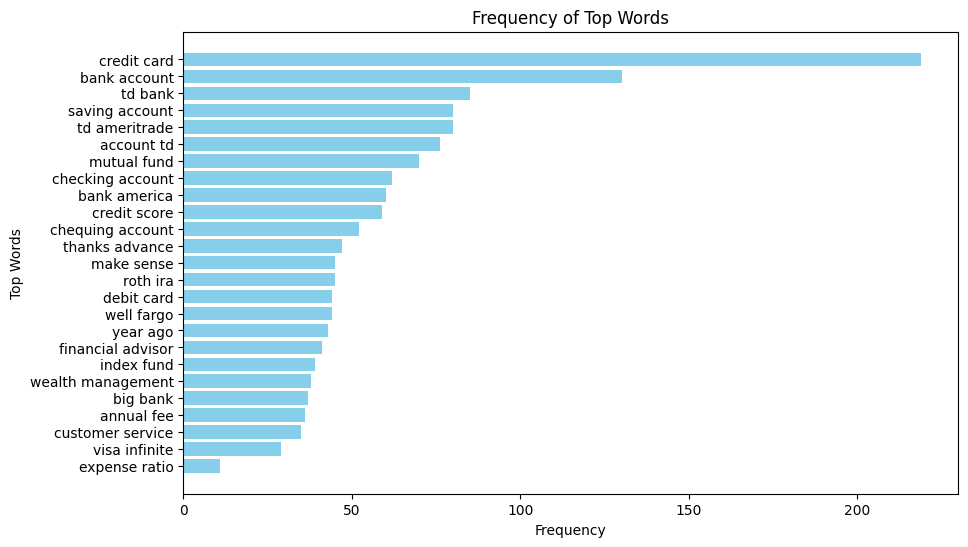

Top Words            Frequency
-----------------  -----------
credit card                219
bank account               130
td bank                     85
saving account              80
td ameritrade               80
account td                  76
mutual fund                 70
checking account            62
bank america                60
credit score                59
chequing account            52
thanks advance              47
make sense                  45
roth ira                    45
debit card                  44
well fargo                  44
year ago                    43
financial advisor           41
index fund                  39
wealth management           38
big bank                    37
annual fee                  36
customer service            35
visa infinite               29
expense ratio               11


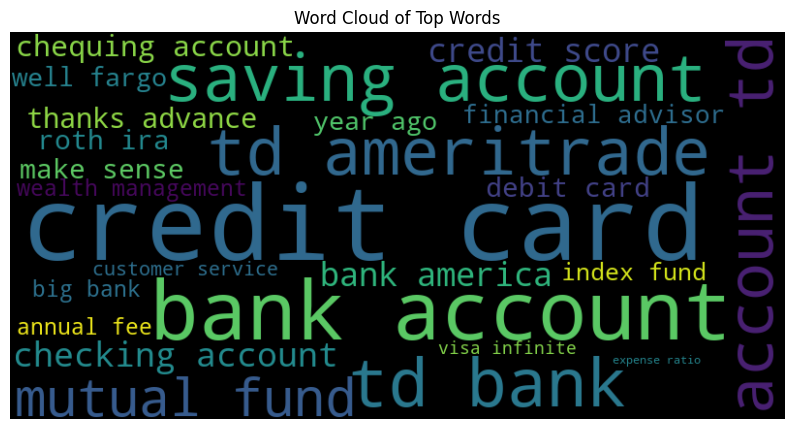

In [186]:
documents2 = TD_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

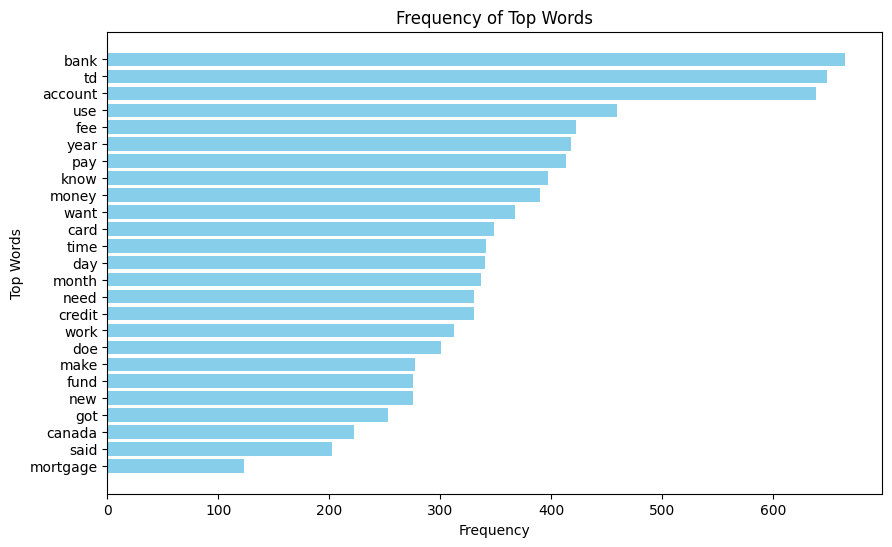

Top Words      Frequency
-----------  -----------
bank                 665
td                   648
account              638
use                  459
fee                  422
year                 418
pay                  413
know                 397
money                390
want                 367
card                 348
time                 341
day                  340
month                337
need                 330
credit               330
work                 312
doe                  301
make                 277
fund                 275
new                  275
got                  253
canada               222
said                 202
mortgage             123


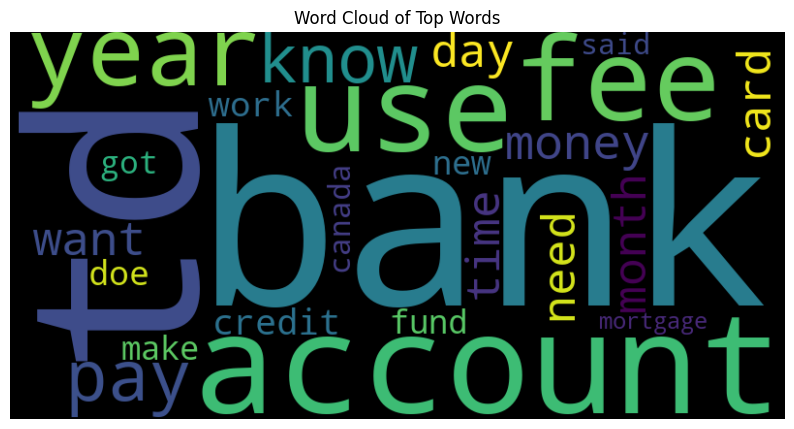

In [187]:
documents2 = TD_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

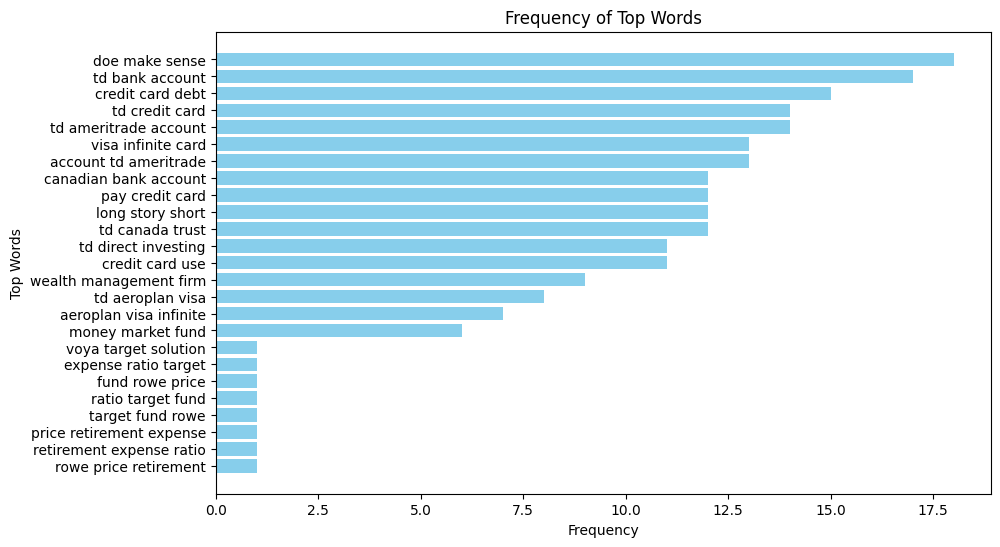

Top Words                   Frequency
------------------------  -----------
doe make sense                     18
td bank account                    17
credit card debt                   15
td credit card                     14
td ameritrade account              14
visa infinite card                 13
account td ameritrade              13
canadian bank account              12
pay credit card                    12
long story short                   12
td canada trust                    12
td direct investing                11
credit card use                    11
wealth management firm              9
td aeroplan visa                    8
aeroplan visa infinite              7
money market fund                   6
voya target solution                1
expense ratio target                1
fund rowe price                     1
ratio target fund                   1
target fund rowe                    1
price retirement expense            1
retirement expense ratio            1
rowe price r

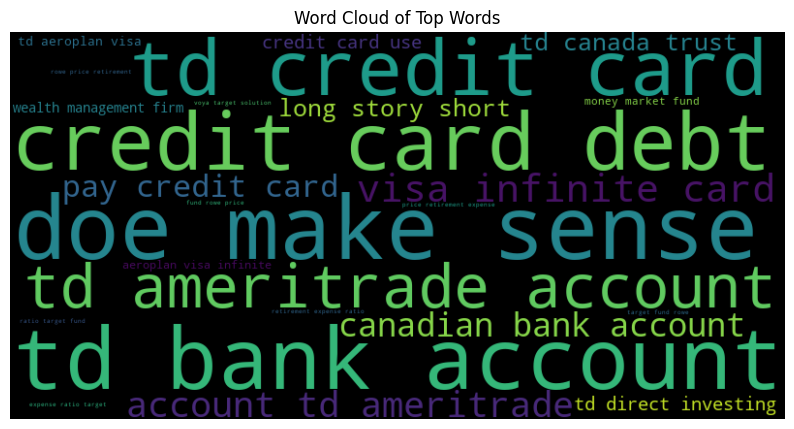

In [188]:
documents2 = TD_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## BMO Dataset

In [189]:
# Specify the element you want to filter for in the link
target_element = 'bmo'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
bmo_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
bmo_df = df3[bmo_values]

# Display the result
bmo_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
66,Recent Private Banking experiences - CIBC vs S...,yggt1g,tradinghumble,2022-10-29 07:06:26,11,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,36,1334214,Banking,I was offered CIBC and Scotia Private Banking...,https://www.reddit.com/r/PersonalFinanceCanada...,BMO is behind with technology? \n\nI guess you...,1,2023-04-02 03:07:44
322,Are private banking firms like RBC considered ...,conx4f,WiseShepherd,2019-08-10 17:28:10,2,1.00,https://www.reddit.com/r/PersonalFinanceCanada...,21,1334214,NaN,And do they have a fiduciary duty to their cli...,https://www.reddit.com/r/PersonalFinanceCanada...,BMO and RBC do.,1,2019-08-10 20:12:40
627,Should I use a bank or a private company to he...,tq0pg0,Opening_Wafer_3952,2022-03-27 23:59:12,0,0.50,https://www.reddit.com/r/PersonalFinanceCanada...,9,1334214,Investing,"I want to start investing, and I think I'm goi...",https://www.reddit.com/r/PersonalFinanceCanada...,"If you want a cheap way to set, contribute & f...",5,2022-03-28 00:10:49
1051,Consolidating bank accounts... who to go with?...,3vqjau,buppybup,2015-12-06 21:12:22,4,1.00,https://www.reddit.com/r/PersonalFinanceCanada...,1,1334214,NaN,"Hi folks, hoping to get some help picking a ba...",https://www.reddit.com/r/PersonalFinanceCanada...,Start out by checking this online tool by the ...,1,2015-12-07 10:49:18
1243,High net worth banking discussion,10ma0xz,pfcannon987,2023-01-26 21:44:41,7,0.68,https://www.reddit.com/r/PersonalFinanceCanada...,27,1334214,Banking,I have always been a big proponent of no fee b...,https://www.reddit.com/r/PersonalFinanceCanada...,CIBC so far has been the best with their high ...,2,2023-01-26 23:09:50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200749,I made a spreadsheet to find out which credit ...,788c89,bloogza,2017-10-23 11:09:02,5239,0.95,https://www.reddit.com/r/personalfinance/comme...,594,18717086,Saving,"Credit card offerings are not ""one size fits a...",https://www.reddit.com/r/personalfinance/comme...,Rewards credit cards in Canada aren't generall...,1,2017-10-24 06:36:40
204608,I researched Cash-Back credit cards so you don...,b5qjvf,jakfrist,2019-03-26 10:44:29,21479,0.94,https://www.reddit.com/r/personalfinance/comme...,1890,18717097,Credit,# TL;DR:\n\n*Since the summary table is all an...,https://www.reddit.com/r/personalfinance/comme...,Bmo offers a 3% back gas and grocery card. Be...,1,2019-03-27 03:50:32
208227,Investing in Bank Account Promotions,5n9kv7,SuperMario1222,2017-01-10 21:49:05,5,0.78,https://www.reddit.com/r/personalfinance/comme...,19,18717201,Investing,"Let's say I had $30,000 to invest and didn't n...",https://www.reddit.com/r/personalfinance/comme...,Between my wife and my accounts...\n\nEmergenc...,2,2017-01-12 00:30:02
209859,Transferring Money to a US account from a Cana...,19dxrcy,canakiwi,2024-01-23 15:14:38,1,1.00,https://www.reddit.com/r/personalfinance/comme...,9,18717204,Saving,"I admit, I am confused. \nI have to fund an ...",https://www.reddit.com/r/personalfinance/comme...,Which Canadian bank do you use? We have BMO in...,1,2024-01-23 19:43:35


In [190]:
# Sample documents
documents = bmo_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,11198
1,Neutral,5419
2,Negative,4498


In [191]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,531
1,Negative,150
2,Neutral,44


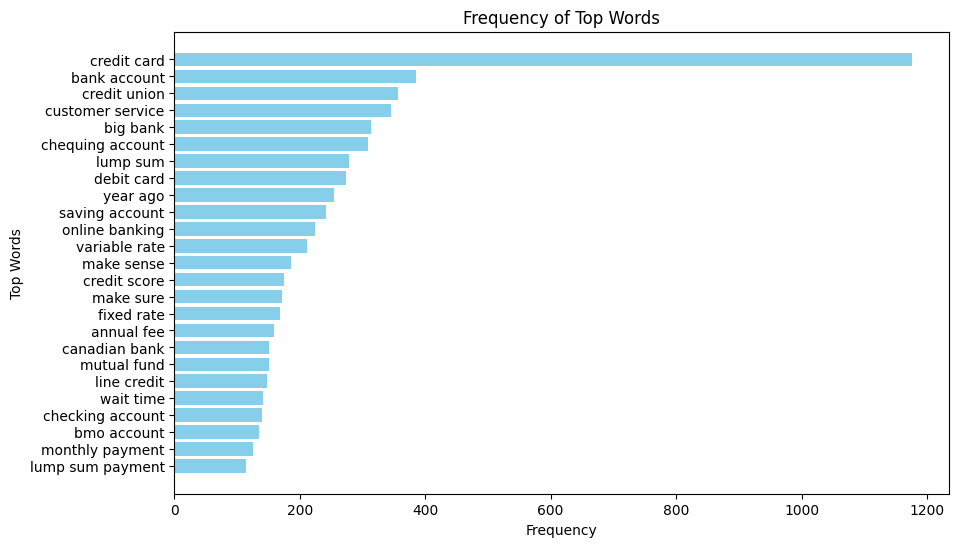

Top Words           Frequency
----------------  -----------
credit card              1177
bank account              385
credit union              357
customer service          346
big bank                  313
chequing account          308
lump sum                  279
debit card                273
year ago                  254
saving account            242
online banking            225
variable rate             211
make sense                186
credit score              175
make sure                 171
fixed rate                169
annual fee                159
canadian bank             151
mutual fund               151
line credit               148
wait time                 141
checking account          139
bmo account               135
monthly payment           125
lump sum payment          114


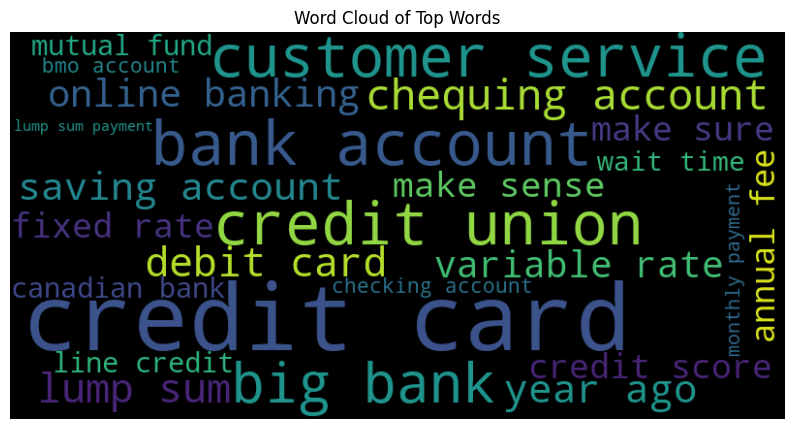

In [192]:
# Sample documents
documents = bmo_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

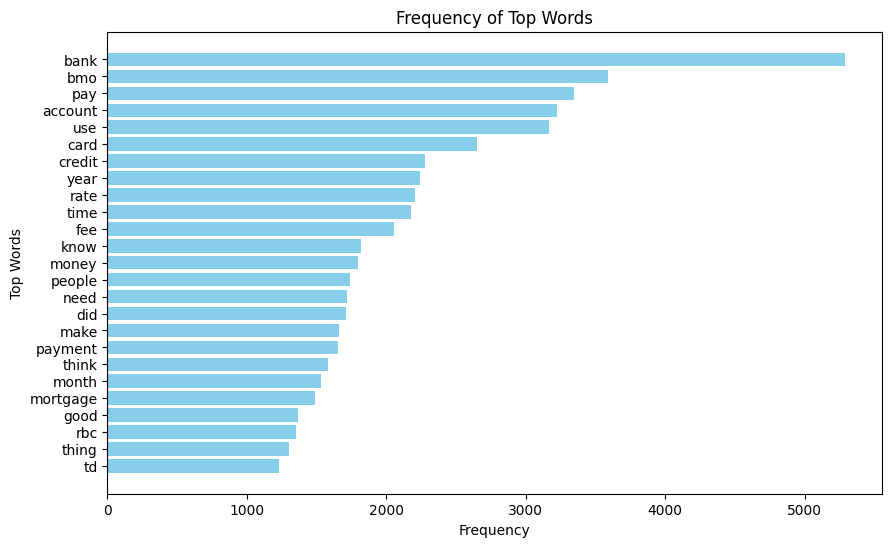

Top Words      Frequency
-----------  -----------
bank                5293
bmo                 3591
pay                 3347
account             3225
use                 3168
card                2652
credit              2274
year                2244
rate                2208
time                2177
fee                 2052
know                1821
money               1798
people              1743
need                1717
did                 1713
make                1663
payment             1657
think               1581
month               1529
mortgage            1489
good                1365
rbc                 1353
thing               1300
td                  1229


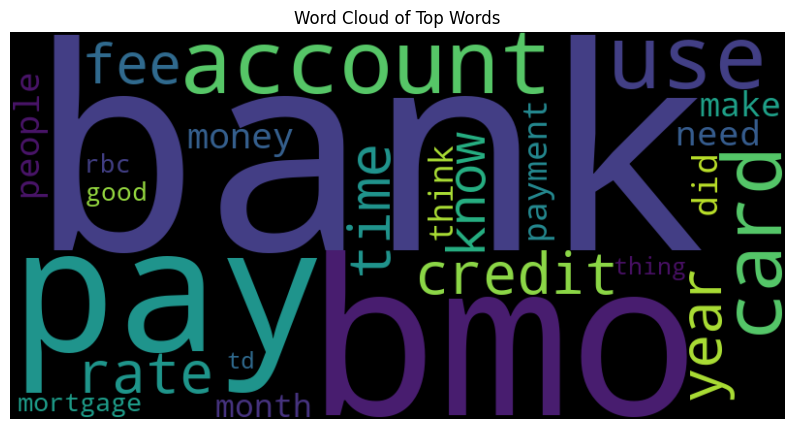

In [193]:
# Sample documents
documents = bmo_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

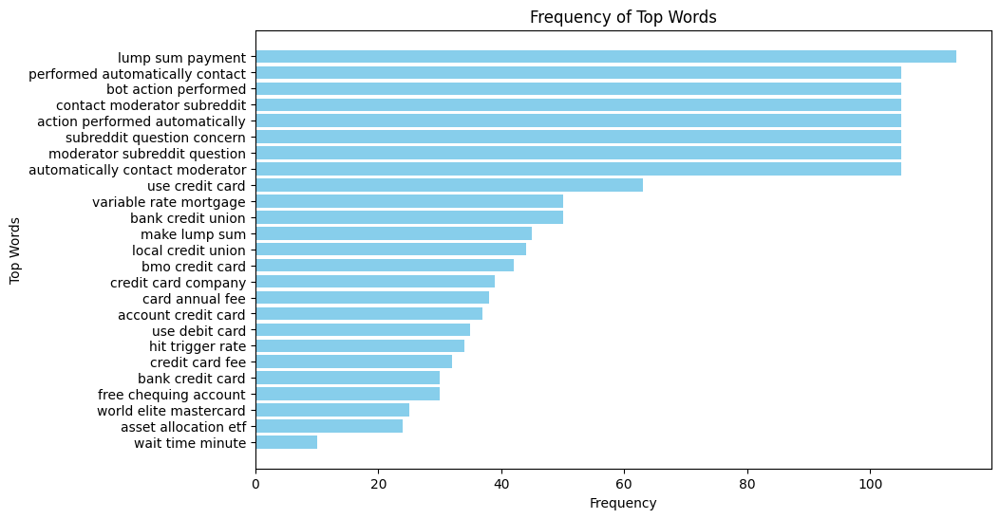

Top Words                          Frequency
-------------------------------  -----------
lump sum payment                         114
performed automatically contact          105
bot action performed                     105
contact moderator subreddit              105
action performed automatically           105
subreddit question concern               105
moderator subreddit question             105
automatically contact moderator          105
use credit card                           63
variable rate mortgage                    50
bank credit union                         50
make lump sum                             45
local credit union                        44
bmo credit card                           42
credit card company                       39
card annual fee                           38
account credit card                       37
use debit card                            35
hit trigger rate                          34
credit card fee                           32
bank credi

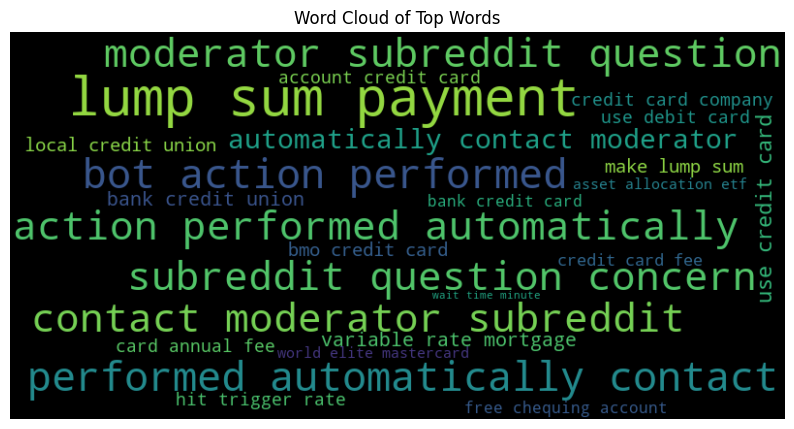

In [194]:
# Sample documents
documents = bmo_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

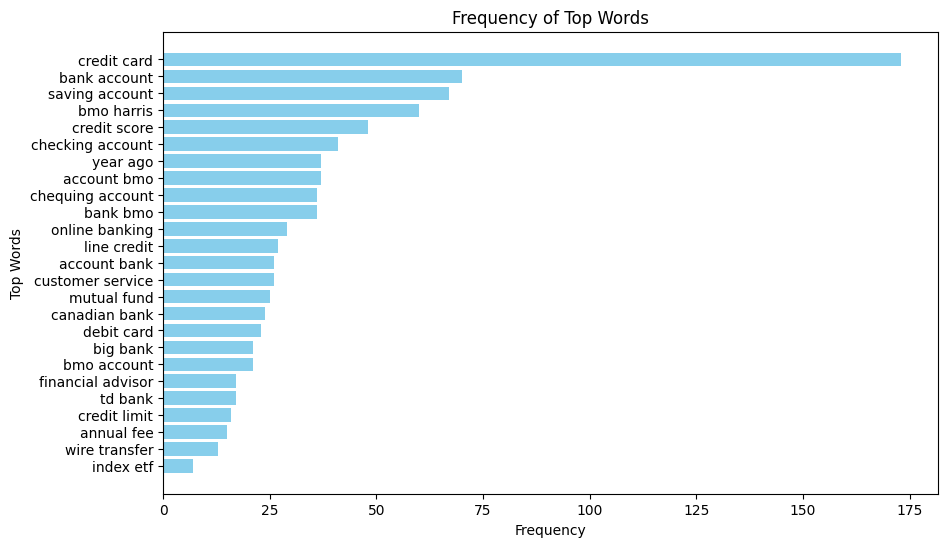

Top Words            Frequency
-----------------  -----------
credit card                173
bank account                70
saving account              67
bmo harris                  60
credit score                48
checking account            41
year ago                    37
account bmo                 37
chequing account            36
bank bmo                    36
online banking              29
line credit                 27
account bank                26
customer service            26
mutual fund                 25
canadian bank               24
debit card                  23
big bank                    21
bmo account                 21
financial advisor           17
td bank                     17
credit limit                16
annual fee                  15
wire transfer               13
index etf                    7


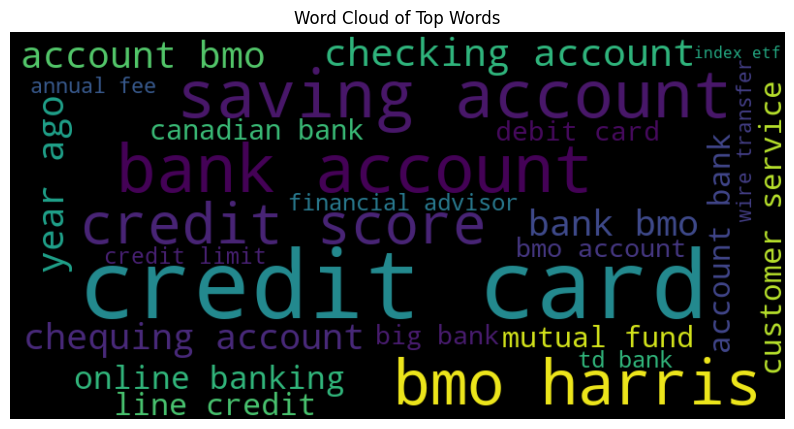

In [195]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'doe'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

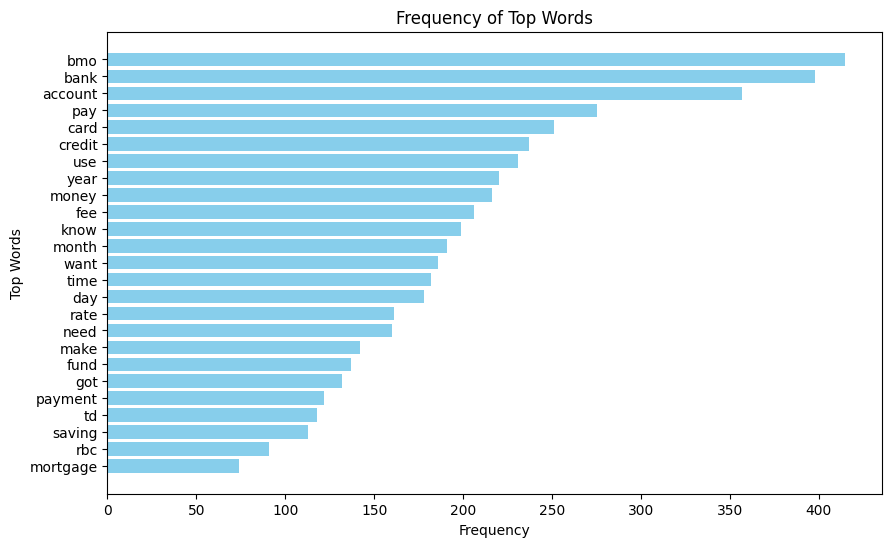

Top Words      Frequency
-----------  -----------
bmo                  415
bank                 398
account              357
pay                  275
card                 251
credit               237
use                  231
year                 220
money                216
fee                  206
know                 199
month                191
want                 186
time                 182
day                  178
rate                 161
need                 160
make                 142
fund                 137
got                  132
payment              122
td                   118
saving               113
rbc                   91
mortgage              74


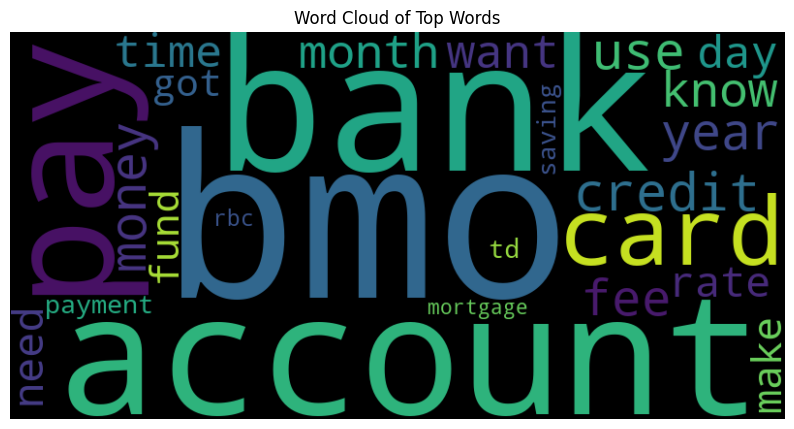

In [196]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'doe'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

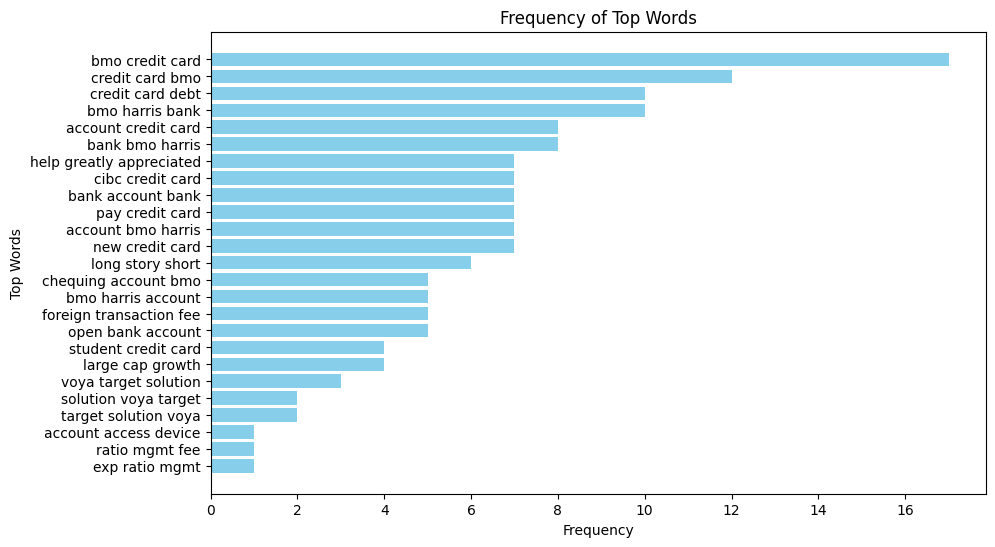

Top Words                   Frequency
------------------------  -----------
bmo credit card                    17
credit card bmo                    12
credit card debt                   10
bmo harris bank                    10
account credit card                 8
bank bmo harris                     8
help greatly appreciated            7
cibc credit card                    7
bank account bank                   7
pay credit card                     7
account bmo harris                  7
new credit card                     7
long story short                    6
chequing account bmo                5
bmo harris account                  5
foreign transaction fee             5
open bank account                   5
student credit card                 4
large cap growth                    4
voya target solution                3
solution voya target                2
target solution voya                2
account access device               1
ratio mgmt fee                      1
exp ratio mg

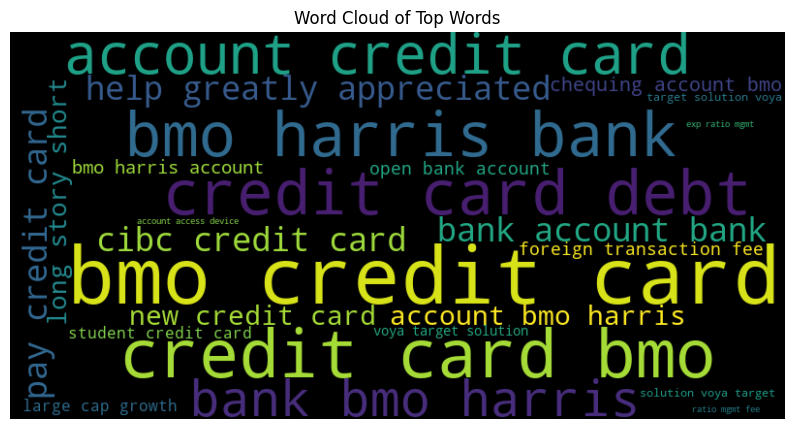

In [197]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'doe'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## Scotiabank Dataset

In [198]:
# Specify the element you want to filter for in the link
target_element = 'scotiabank'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
scotiabank_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
scotiabank_df = df3[scotiabank_values]

# Display the result
scotiabank_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
54,Recent Private Banking experiences - CIBC vs S...,yggt1g,tradinghumble,2022-10-29 07:06:26,11,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,36,1334214,Banking,I was offered CIBC and Scotia Private Banking...,https://www.reddit.com/r/PersonalFinanceCanada...,"Scotiabank is in internal disarray these days,...",3,2022-10-29 12:21:26
62,Recent Private Banking experiences - CIBC vs S...,yggt1g,tradinghumble,2022-10-29 07:06:26,11,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,36,1334214,Banking,I was offered CIBC and Scotia Private Banking...,https://www.reddit.com/r/PersonalFinanceCanada...,As an employee of Scotiabank this statement su...,2,2023-09-24 01:10:34
65,Recent Private Banking experiences - CIBC vs S...,yggt1g,tradinghumble,2022-10-29 07:06:26,11,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,36,1334214,Banking,I was offered CIBC and Scotia Private Banking...,https://www.reddit.com/r/PersonalFinanceCanada...,She was asking that because the [Scotia Prefer...,5,2022-10-29 12:23:23
3128,Inheritance cheque from Ecuador,17pch9l,Federal_Patience7206,2023-11-06 15:41:18,0,0.40,https://www.reddit.com/r/PersonalFinanceCanada...,4,1334214,Banking,My Ecuadorian father passed away this summer a...,https://www.reddit.com/r/PersonalFinanceCanada...,"Get all the paperwork fir the Inheritance, co...",2,2023-11-06 16:11:13
3129,Inheritance cheque from Ecuador,17pch9l,Federal_Patience7206,2023-11-06 15:41:18,0,0.40,https://www.reddit.com/r/PersonalFinanceCanada...,4,1334214,Banking,My Ecuadorian father passed away this summer a...,https://www.reddit.com/r/PersonalFinanceCanada...,Western Union may be an option or some similar...,2,2023-11-07 02:03:09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197218,Scotiabank is closing my account and issuing a...,4sseh2,bankthrowawayy,2016-07-14 05:26:16,175,0.83,https://www.reddit.com/r/personalfinance/comme...,172,18717072,Saving,I bank with Scotiabank in Canada and they deci...,https://www.reddit.com/r/personalfinance/comme...,The BBB is a shady as fuck organization\nhttps...,6,2016-07-14 12:38:48
197219,Scotiabank is closing my account and issuing a...,4sseh2,bankthrowawayy,2016-07-14 05:26:16,175,0.83,https://www.reddit.com/r/personalfinance/comme...,172,18717072,Saving,I bank with Scotiabank in Canada and they deci...,https://www.reddit.com/r/personalfinance/comme...,And you speak Canadian! Put that on your resume.,3,2016-07-14 18:17:46
197220,Scotiabank is closing my account and issuing a...,4sseh2,bankthrowawayy,2016-07-14 05:26:16,175,0.83,https://www.reddit.com/r/personalfinance/comme...,172,18717072,Saving,I bank with Scotiabank in Canada and they deci...,https://www.reddit.com/r/personalfinance/comme...,that is shady as hell :(,2,2016-07-14 12:44:44
197221,Scotiabank is closing my account and issuing a...,4sseh2,bankthrowawayy,2016-07-14 05:26:16,175,0.83,https://www.reddit.com/r/personalfinance/comme...,172,18717072,Saving,I bank with Scotiabank in Canada and they deci...,https://www.reddit.com/r/personalfinance/comme...,"Let's be partners!\n\nI'm a celebrity, what do...",1,2016-07-14 20:48:15


In [199]:
# Sample documents
documents = scotiabank_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,3299
1,Neutral,1673
2,Negative,1154


In [200]:
documents2 = scotiabank_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,355
1,Negative,113
2,Neutral,37


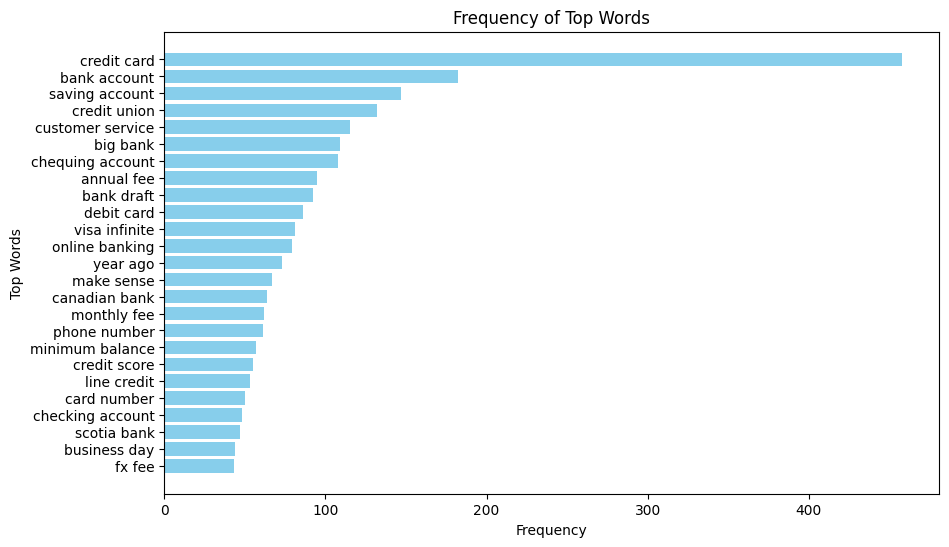

Top Words           Frequency
----------------  -----------
credit card               458
bank account              182
saving account            147
credit union              132
customer service          115
big bank                  109
chequing account          108
annual fee                 95
bank draft                 92
debit card                 86
visa infinite              81
online banking             79
year ago                   73
make sense                 67
canadian bank              64
monthly fee                62
phone number               61
minimum balance            57
credit score               55
line credit                53
card number                50
checking account           48
scotia bank                47
business day               44
fx fee                     43


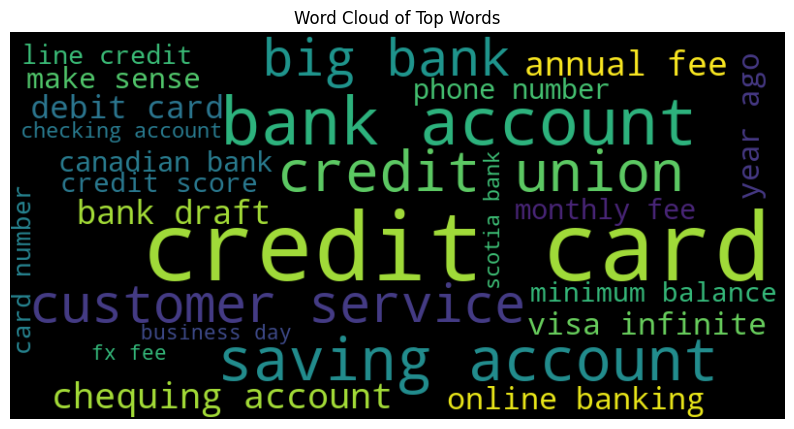

In [201]:
# Sample documents
documents = scotiabank_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sure'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

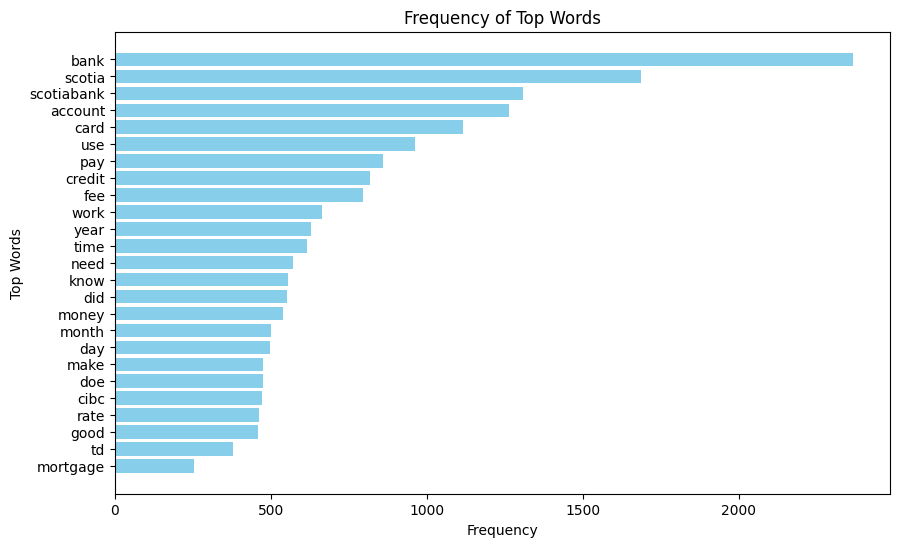

Top Words      Frequency
-----------  -----------
bank                2367
scotia              1687
scotiabank          1310
account             1264
card                1116
use                  963
pay                  859
credit               817
fee                  797
work                 664
year                 628
time                 615
need                 570
know                 555
did                  551
money                540
month                500
day                  497
make                 476
doe                  474
cibc                 473
rate                 461
good                 458
td                   380
mortgage             255


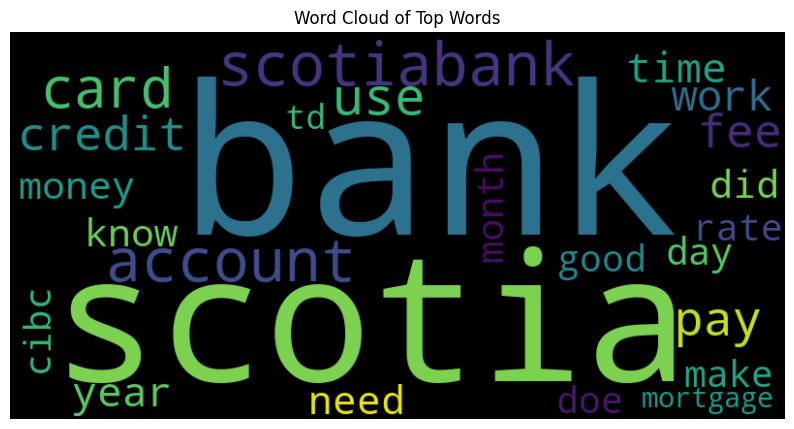

In [202]:
# Sample documents
documents = scotiabank_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sure'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

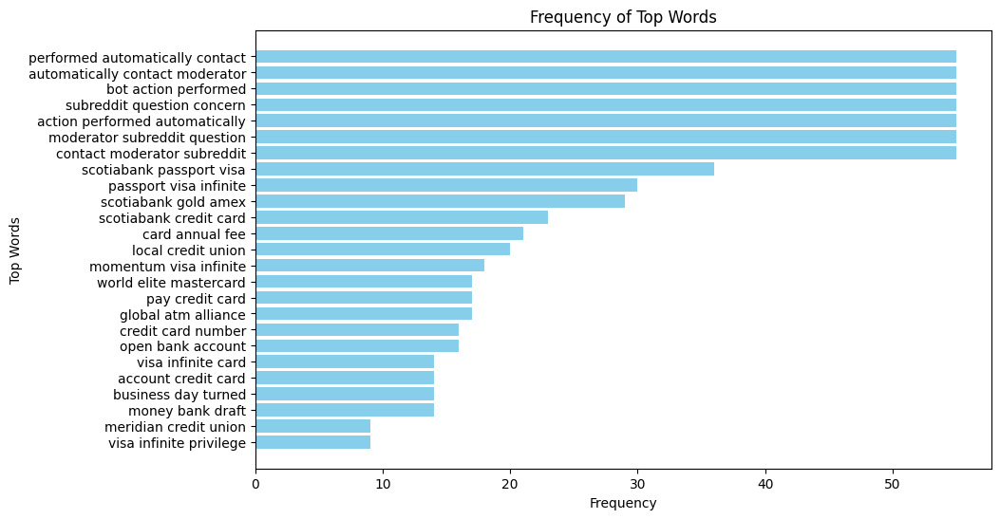

Top Words                          Frequency
-------------------------------  -----------
performed automatically contact           55
automatically contact moderator           55
bot action performed                      55
subreddit question concern                55
action performed automatically            55
moderator subreddit question              55
contact moderator subreddit               55
scotiabank passport visa                  36
passport visa infinite                    30
scotiabank gold amex                      29
scotiabank credit card                    23
card annual fee                           21
local credit union                        20
momentum visa infinite                    18
world elite mastercard                    17
pay credit card                           17
global atm alliance                       17
credit card number                        16
open bank account                         16
visa infinite card                        14
account cr

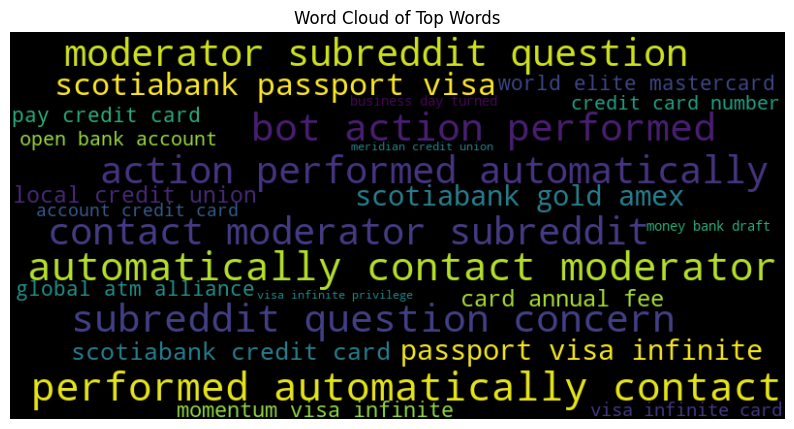

In [203]:
# Sample documents
documents = scotiabank_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sure'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

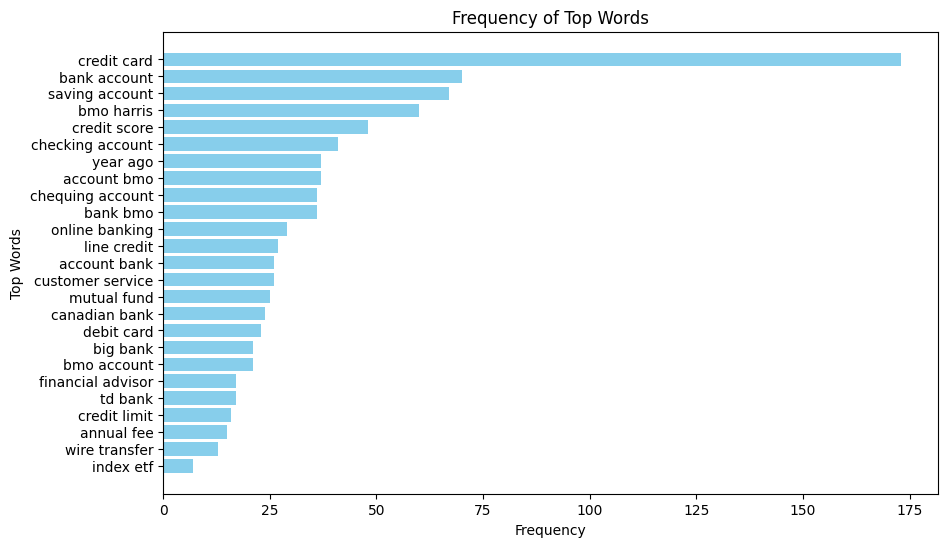

Top Words            Frequency
-----------------  -----------
credit card                173
bank account                70
saving account              67
bmo harris                  60
credit score                48
checking account            41
year ago                    37
account bmo                 37
chequing account            36
bank bmo                    36
online banking              29
line credit                 27
account bank                26
customer service            26
mutual fund                 25
canadian bank               24
debit card                  23
big bank                    21
bmo account                 21
financial advisor           17
td bank                     17
credit limit                16
annual fee                  15
wire transfer               13
index etf                    7


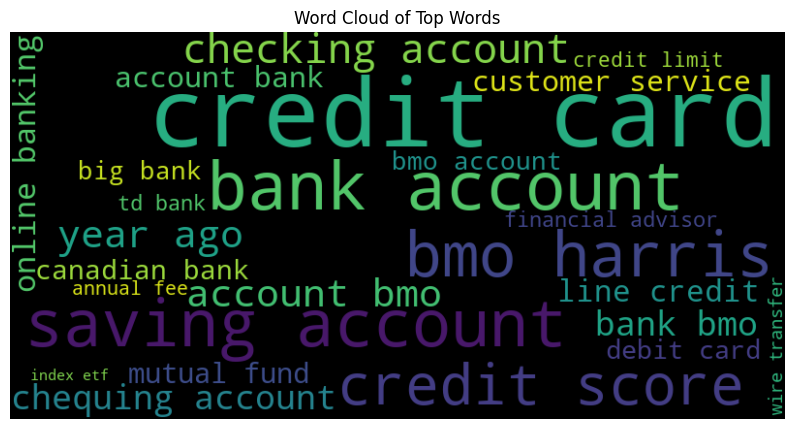

In [204]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'doe'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

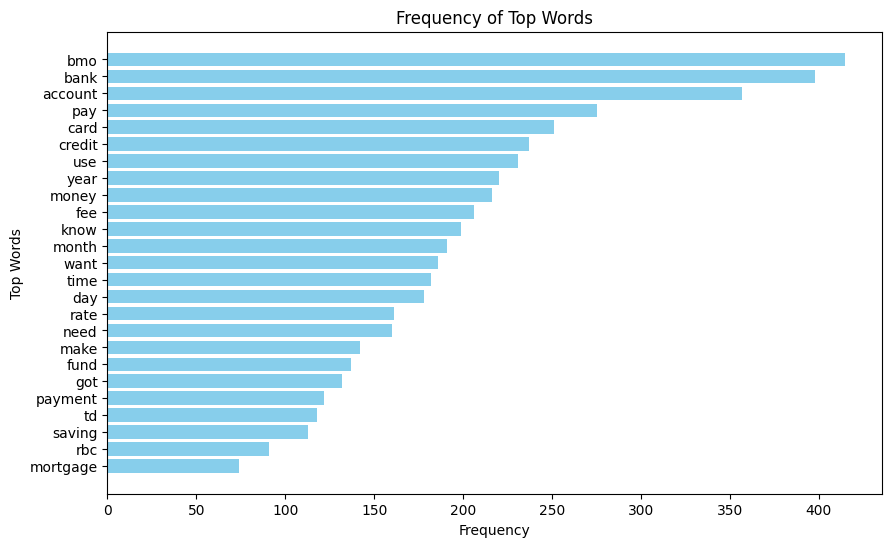

Top Words      Frequency
-----------  -----------
bmo                  415
bank                 398
account              357
pay                  275
card                 251
credit               237
use                  231
year                 220
money                216
fee                  206
know                 199
month                191
want                 186
time                 182
day                  178
rate                 161
need                 160
make                 142
fund                 137
got                  132
payment              122
td                   118
saving               113
rbc                   91
mortgage              74


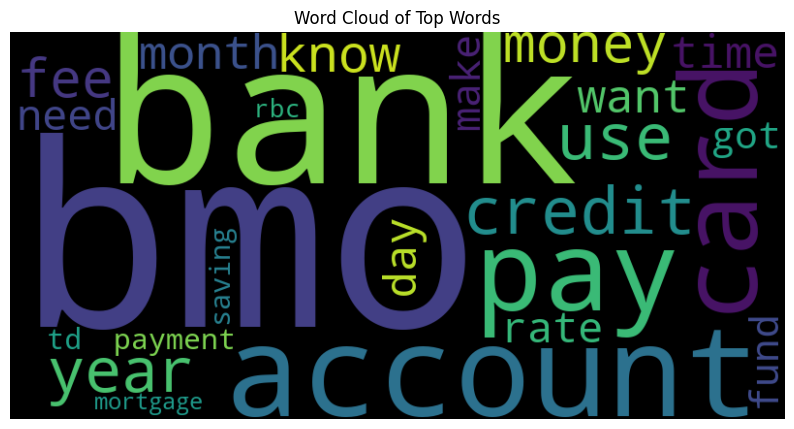

In [205]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'doe'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

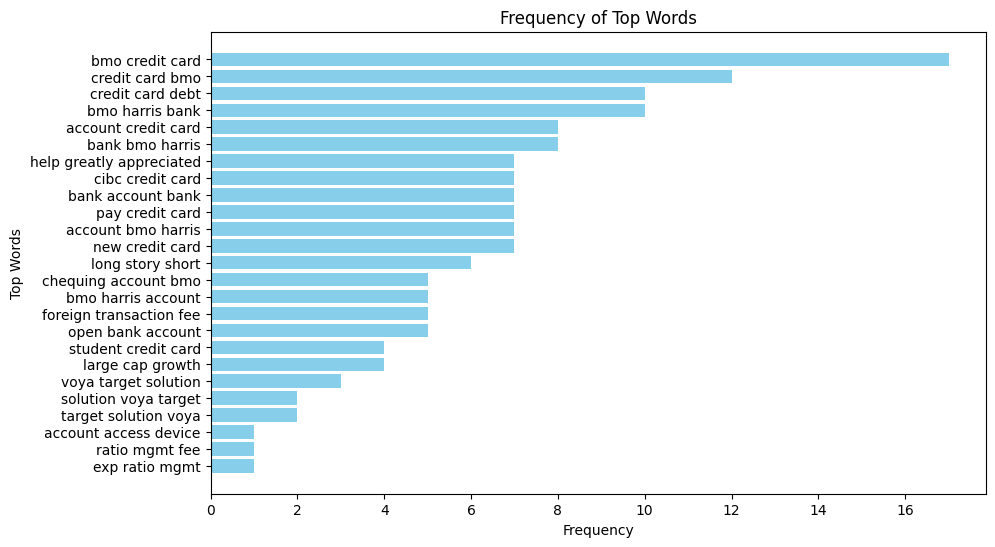

Top Words                   Frequency
------------------------  -----------
bmo credit card                    17
credit card bmo                    12
credit card debt                   10
bmo harris bank                    10
account credit card                 8
bank bmo harris                     8
help greatly appreciated            7
cibc credit card                    7
bank account bank                   7
pay credit card                     7
account bmo harris                  7
new credit card                     7
long story short                    6
chequing account bmo                5
bmo harris account                  5
foreign transaction fee             5
open bank account                   5
student credit card                 4
large cap growth                    4
voya target solution                3
solution voya target                2
target solution voya                2
account access device               1
ratio mgmt fee                      1
exp ratio mg

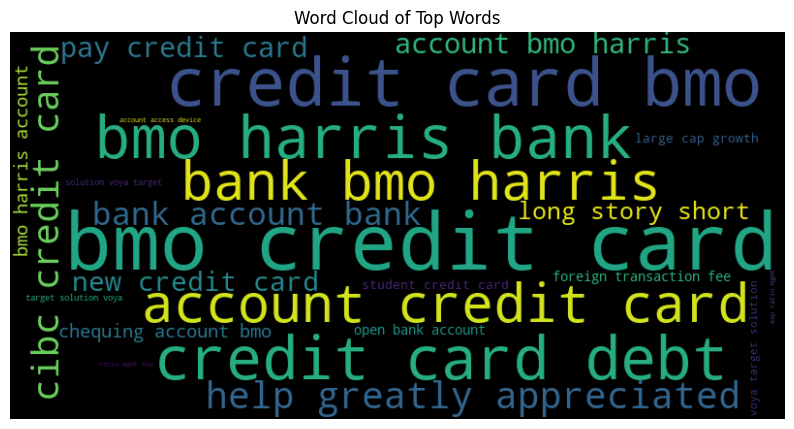

In [206]:
documents2 = bmo_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'doe'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

# Western Bank of Canada

In [207]:
# Specify the element you want to filter for in the link
target_element = 'Western Bank of Canada'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
Western_Bank_of_Canada_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
Western_Bank_of_Canada_df = df3[Western_Bank_of_Canada_values]

# Display the result
Western_Bank_of_Canada_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date


## JPMorganChase Dataset

In [208]:
# Specify the element you want to filter for in the link
target_element = 'jpmorganchase'
target = ['jp','morgan', 'chase', 'jpmorganchase', 'jpm'] 

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

url_mask = df3['url'].str.contains(fr'/r/{target_element}/', case=False)

# Convert the target keywords to lowercase
lowercase_target = [keyword.lower() for keyword in target]

# Use any() to check if any element in the 'target' list is present in 'comment' and 'submission_comment'
comment_mask = df3['comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))
submission_comment_mask = df3['submission_comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))

# Combine the masks using logical OR
JP_values = url_mask | comment_mask | submission_comment_mask

# Apply the mask to subset the DataFrame
JP_df = df3[JP_values]

# Display the result
JP_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
244,Wealthsimple on brink of largest-ever Canadian...,n3yf9x,Rudiger,2021-05-03 11:07:16,945,0.97,https://www.reddit.com/r/PersonalFinanceCanada...,434,1334214,NaN,[Wealthsimple announces landmark $750-million...,https://www.reddit.com/r/PersonalFinanceCanada...,"Honestly google is pretty tame, ~~yahoo~~ ~~oa...",2,2021-05-03 18:58:56
279,Is it worth it? RBC Avion Visa Infinite Privil...,psvxxh,Boltbeam,2021-09-21 20:28:54,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,17,1334214,Banking,I'm currently using the RBC Avion Visa Infinit...,https://www.reddit.com/r/PersonalFinanceCanada...,"When optimally redeemed, RBC points [are worth...",8,2021-09-21 20:47:59
304,Big banks vs private lenders for mortgage,16llby0,BrilliantAdvantage45,2023-09-18 00:09:11,0,0.33,https://www.reddit.com/r/PersonalFinanceCanada...,3,1334214,Housing,Not sure if this is the right sub....\n\nAre t...,https://www.reddit.com/r/PersonalFinanceCanada...,I am a broker and you likely mean a monoline l...,2,2023-09-18 09:48:56
391,Is private crowdfunding for a mortgage an opti...,x8kqsp,GTH10,2022-09-07 20:02:01,0,0.38,https://www.reddit.com/r/PersonalFinanceCanada...,31,1334214,Banking,"Say 5 strangers loaned you 100,000 dollars eac...",https://www.reddit.com/r/PersonalFinanceCanada...,Plus banks have lawyers on staff to chase you ...,1,2022-09-07 23:18:44
403,Bank gave my private account details to my mom,8dovnl,RadlerSnek,2018-04-20 12:23:42,106,0.96,https://www.reddit.com/r/PersonalFinanceCanada...,50,1334214,Banking,I hope this is an appropriate group in which t...,https://www.reddit.com/r/PersonalFinanceCanada...,"Bro. I know you're trying to be nice here, but...",269,2018-04-20 12:41:36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211760,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,I dont think any savings account is paying goo...,1,2022-10-14 05:20:49
211761,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,Follow a personal finance plan or framework. L...,1,2022-10-14 06:43:27
211762,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,Gracias!\nI want to have enough money to buy a...,1,2022-10-14 05:11:48
211763,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,Thanks for the answer man! I will definitely r...,1,2022-10-17 02:45:52


In [209]:
# Sample documents
documents = JP_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,28743
1,Neutral,10511
2,Negative,9257


In [210]:
documents2 = JP_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,1434
1,Negative,260
2,Neutral,62


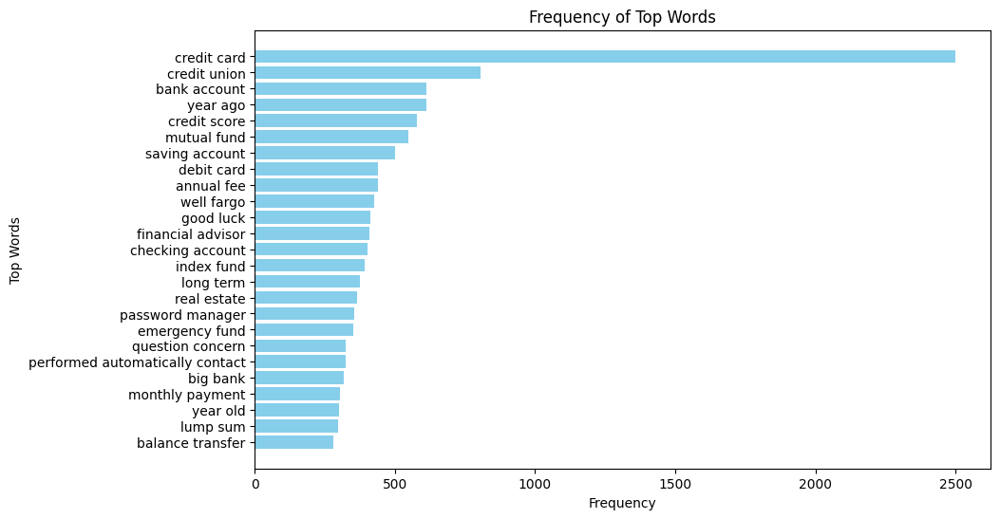

Top Words                          Frequency
-------------------------------  -----------
credit card                             2501
credit union                             807
bank account                             614
year ago                                 611
credit score                             580
mutual fund                              549
saving account                           499
debit card                               439
annual fee                               438
well fargo                               425
good luck                                412
financial advisor                        408
checking account                         403
index fund                               391
long term                                376
real estate                              365
password manager                         355
emergency fund                           350
question concern                         325
performed automatically contact          324
big bank  

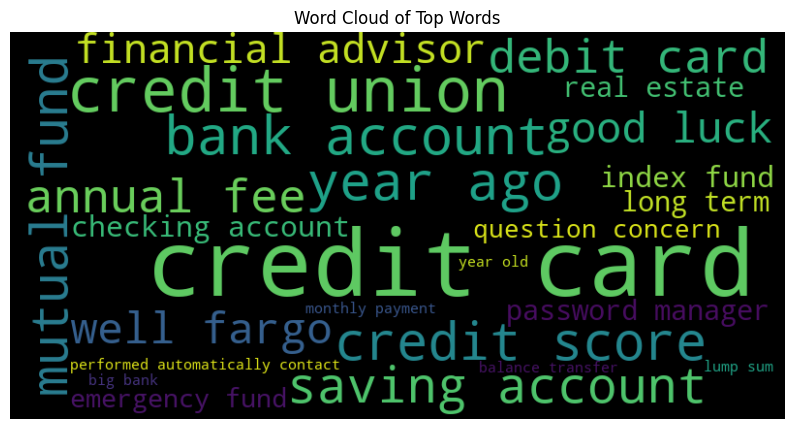

In [211]:
# Sample documents
documents = JP_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'make'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

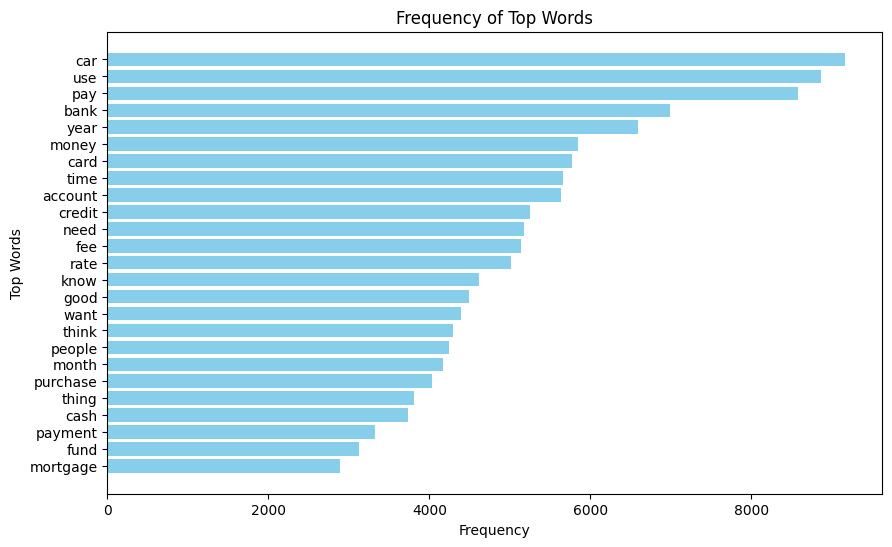

Top Words      Frequency
-----------  -----------
car                 9170
use                 8867
pay                 8585
bank                6989
year                6595
money               5846
card                5777
time                5660
account             5635
credit              5255
need                5179
fee                 5139
rate                5016
know                4614
good                4488
want                4398
think               4291
people              4238
month               4169
purchase            4036
thing               3815
cash                3736
payment             3320
fund                3120
mortgage            2890


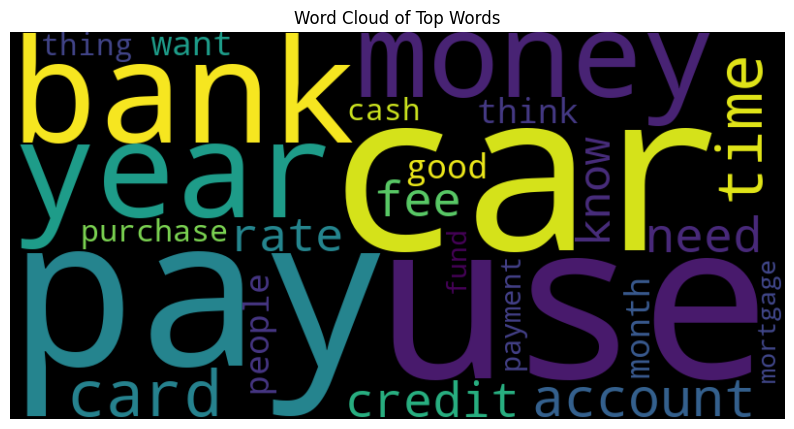

In [212]:
# Sample documents
documents = JP_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'make'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

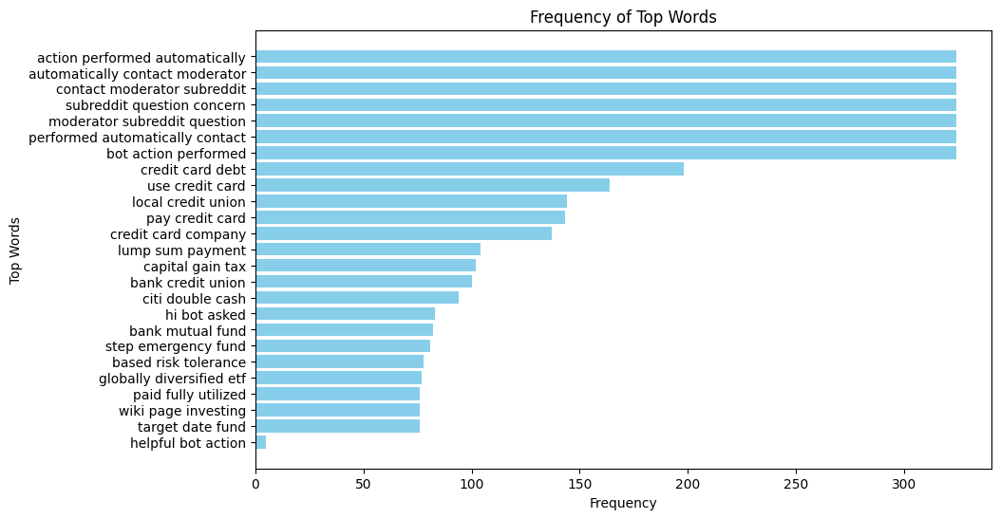

Top Words                          Frequency
-------------------------------  -----------
action performed automatically           324
automatically contact moderator          324
contact moderator subreddit              324
subreddit question concern               324
moderator subreddit question             324
performed automatically contact          324
bot action performed                     324
credit card debt                         198
use credit card                          164
local credit union                       144
pay credit card                          143
credit card company                      137
lump sum payment                         104
capital gain tax                         102
bank credit union                        100
citi double cash                          94
hi bot asked                              83
bank mutual fund                          82
step emergency fund                       81
based risk tolerance                      78
globally d

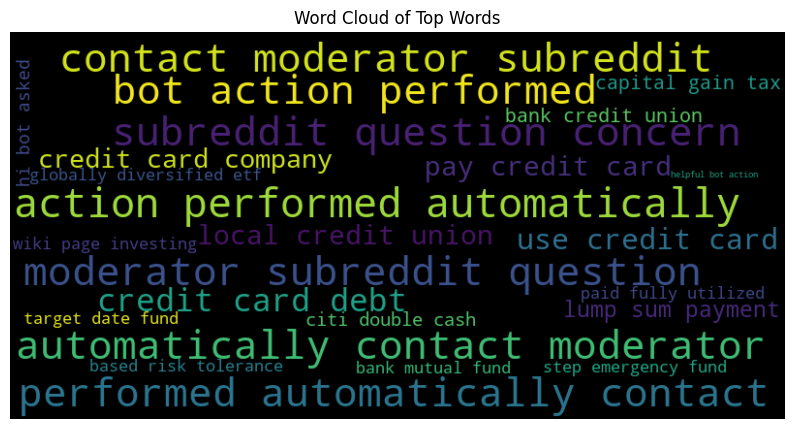

In [213]:
# Sample documents
documents = JP_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'make'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

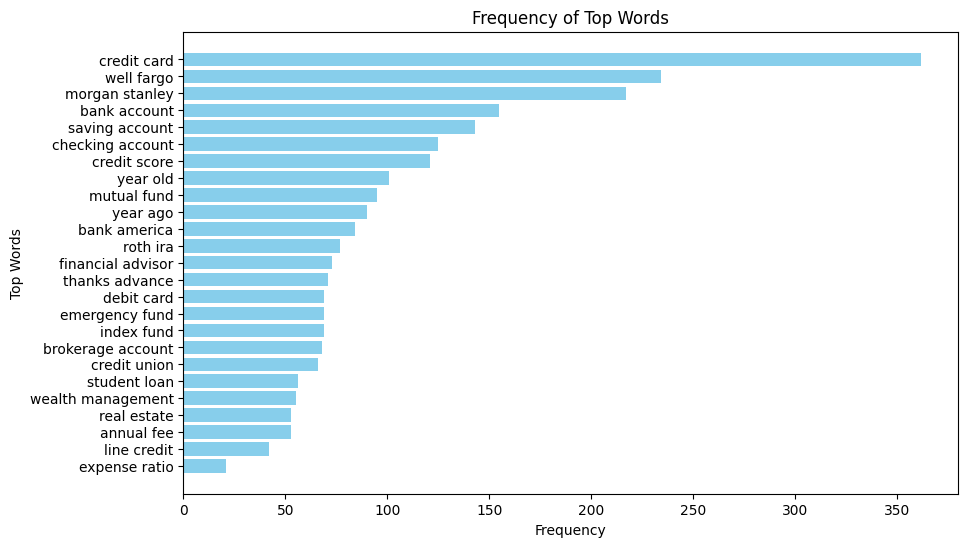

Top Words            Frequency
-----------------  -----------
credit card                362
well fargo                 234
morgan stanley             217
bank account               155
saving account             143
checking account           125
credit score               121
year old                   101
mutual fund                 95
year ago                    90
bank america                84
roth ira                    77
financial advisor           73
thanks advance              71
debit card                  69
emergency fund              69
index fund                  69
brokerage account           68
credit union                66
student loan                56
wealth management           55
real estate                 53
annual fee                  53
line credit                 42
expense ratio               21


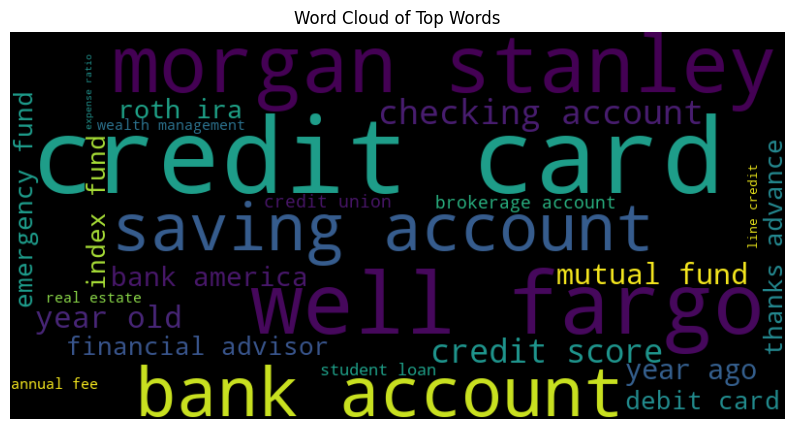

In [214]:
documents2 = JP_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense', 'let'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

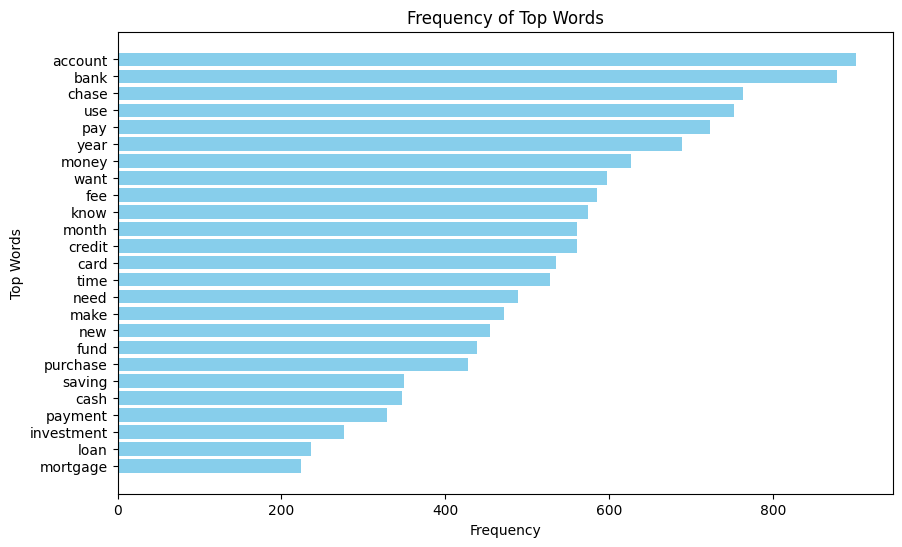

Top Words      Frequency
-----------  -----------
account              901
bank                 878
chase                764
use                  752
pay                  723
year                 689
money                627
want                 598
fee                  585
know                 574
month                561
credit               561
card                 535
time                 528
need                 489
make                 472
new                  455
fund                 439
purchase             428
saving               350
cash                 347
payment              329
investment           276
loan                 236
mortgage             224


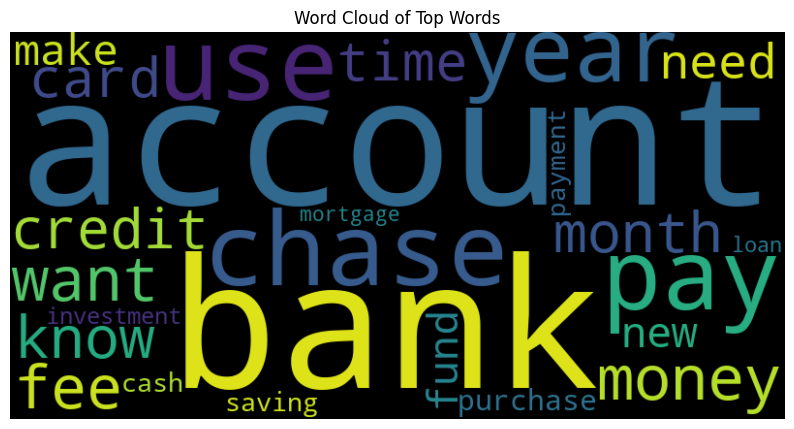

In [215]:
documents2 = JP_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense', 'let'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

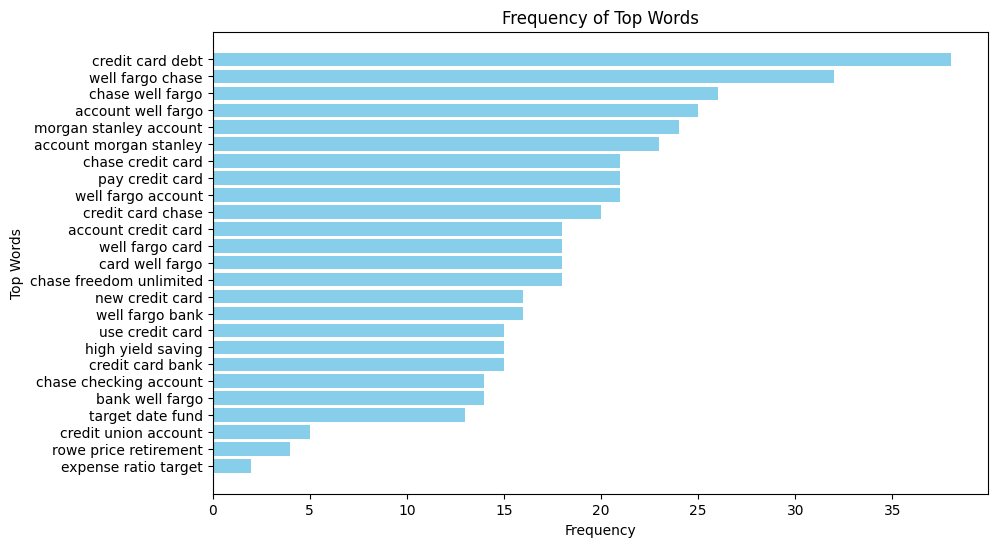

Top Words                  Frequency
-----------------------  -----------
credit card debt                  38
well fargo chase                  32
chase well fargo                  26
account well fargo                25
morgan stanley account            24
account morgan stanley            23
chase credit card                 21
pay credit card                   21
well fargo account                21
credit card chase                 20
account credit card               18
well fargo card                   18
card well fargo                   18
chase freedom unlimited           18
new credit card                   16
well fargo bank                   16
use credit card                   15
high yield saving                 15
credit card bank                  15
chase checking account            14
bank well fargo                   14
target date fund                  13
credit union account               5
rowe price retirement              4
expense ratio target               2


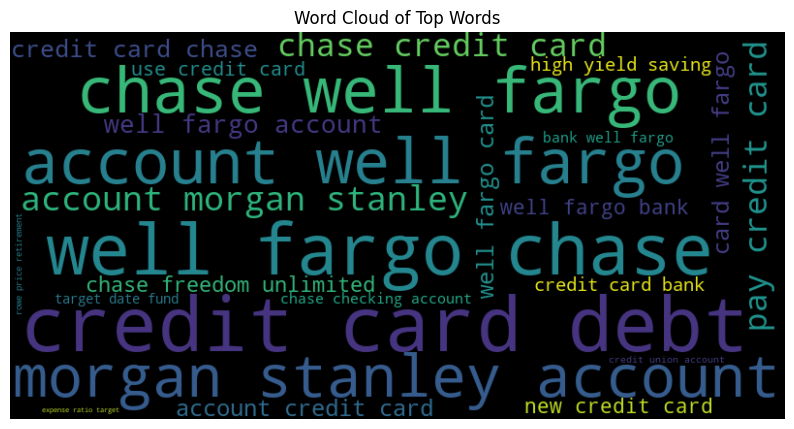

In [216]:
documents2 = JP_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense', 'let'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## WellsFargoChase Dataset

In [217]:
# Specify the element you want to filter for in the link
target_element = 'wellsfargobank'
target_element_2 = 'wellsfargounited'
target = 'WFC'
target_2 = 'WFU'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
WFC_values_1 = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target, case=False) | df3['submission_comment'].str.contains(target, case=False)
WFC_values_2 = df3['url'].str.contains(fr'/r/{target_element_2}/', case=False) | df3['comment'].str.contains(target_2, case=False) | df3['submission_comment'].str.contains(target_2, case=False)

WFC_values = WFC_values_1 + WFC_values_2

# Apply the mask to subset the DataFrame
WFC_df = df3[WFC_values]

# Display the result
WFC_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
424,Bank gave my private account details to my mom,8dovnl,RadlerSnek,2018-04-20 12:23:42,106,0.96,https://www.reddit.com/r/PersonalFinanceCanada...,50,1334214,Banking,I hope this is an appropriate group in which t...,https://www.reddit.com/r/PersonalFinanceCanada...,This is awful and needs to be reported. That ...,1,2018-04-21 12:53:24
799,I 30(f) am planning to divorce my husband. But...,14y81lf,throwin-away-dash,2023-07-12 22:23:34,649,0.83,https://www.reddit.com/r/PersonalFinanceCanada...,466,1334214,Budget,Edit #1: Following some advice in the comments...,https://www.reddit.com/r/PersonalFinanceCanada...,"I hope you get out soon, that sounds like an a...",1,2023-07-14 22:44:22
925,I 30(f) am planning to divorce my husband. But...,14y81lf,throwin-away-dash,2023-07-12 22:23:34,649,0.83,https://www.reddit.com/r/PersonalFinanceCanada...,466,1334214,Budget,Edit #1: Following some advice in the comments...,https://www.reddit.com/r/PersonalFinanceCanada...,It's **really** important to have a safety pla...,1,2023-07-14 08:49:10
1271,Call me stupid but I just found out you can ta...,17n6d3v,lockochain1,2023-11-03 18:03:26,112,0.83,https://www.reddit.com/r/PersonalFinanceCanada...,101,1334214,Auto,Would someone looking to purchase a new vehicl...,https://www.reddit.com/r/PersonalFinanceCanada...,the rates are fucking awful right now. the loa...,2,2023-11-03 18:35:23
1661,Selling my house and the realtor is taking 5%....,sgjj1a,notgettingany69,2022-01-30 16:30:55,829,0.89,https://www.reddit.com/r/PersonalFinanceCanada...,620,1334214,NaN,Edit- ya a week course. I said it. “40 hours t...,https://www.reddit.com/r/PersonalFinanceCanada...,You'd feel awful having 40k more in your pocke...,23,2022-01-30 21:59:57
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210105,ELI5 - IRA vs 401K performance,188fx1n,amarchy,2023-12-01 11:24:16,0,0.33,https://www.reddit.com/r/personalfinance/comme...,21,18717204,Retirement,Can someone explain to me why my employer 401K...,https://www.reddit.com/r/personalfinance/comme...,I'm surprised people didn't pile on more for t...,2,2023-12-01 20:32:56
211015,Do I need to find a new Finacial Advisor?,sdc1vj,KCHank,2022-01-26 12:59:33,2,0.75,https://www.reddit.com/r/personalfinance/comme...,12,18717207,Retirement,I’ve had an account with Morgan Stanley for pr...,https://www.reddit.com/r/personalfinance/comme...,Wow. Your advisor is awful. You need to leave ...,6,2022-01-26 13:07:05
211125,Did I miss out on a lot of returns due to fees...,rgiy4a,question2552,2021-12-14 17:22:36,1,0.60,https://www.reddit.com/r/personalfinance/comme...,6,18717207,Investing,"So about 10 years ago, my father & grandfather...",https://www.reddit.com/r/personalfinance/comme...,"Don't sit on it, it was a fund sold to someone...",2,2021-12-14 17:36:29
211127,Did I miss out on a lot of returns due to fees...,rgiy4a,question2552,2021-12-14 17:22:36,1,0.60,https://www.reddit.com/r/personalfinance/comme...,6,18717207,Investing,"So about 10 years ago, my father & grandfather...",https://www.reddit.com/r/personalfinance/comme...,">Don't sit on it, it was a fund sold to someon...",1,2021-12-14 17:54:11


In [218]:
# Sample documents
documents = WFC_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,1319
1,Negative,680
2,Neutral,467


In [219]:
documents2 = WFC_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,158
1,Negative,38
2,Neutral,10


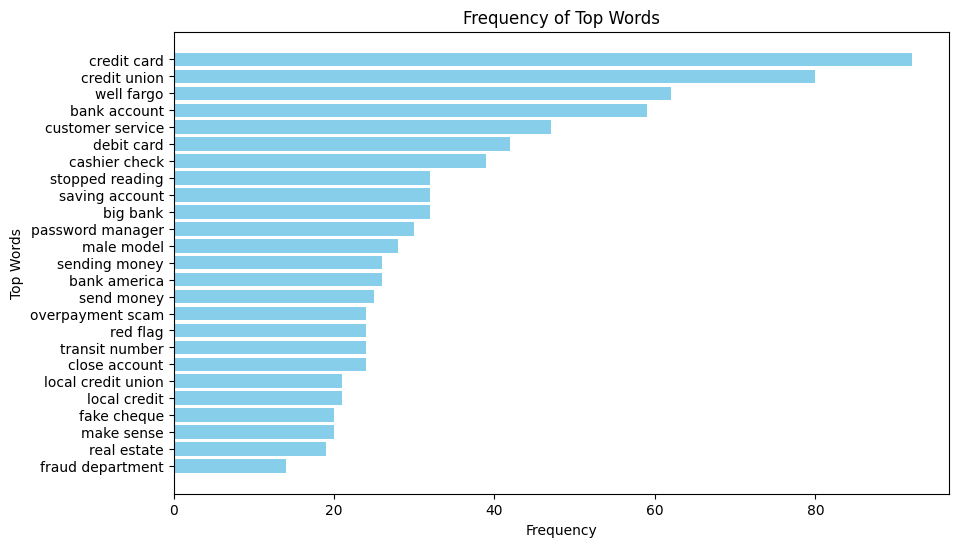

Top Words             Frequency
------------------  -----------
credit card                  92
credit union                 80
well fargo                   62
bank account                 59
customer service             47
debit card                   42
cashier check                39
stopped reading              32
saving account               32
big bank                     32
password manager             30
male model                   28
sending money                26
bank america                 26
send money                   25
overpayment scam             24
red flag                     24
transit number               24
close account                24
local credit union           21
local credit                 21
fake cheque                  20
make sense                   20
real estate                  19
fraud department             14


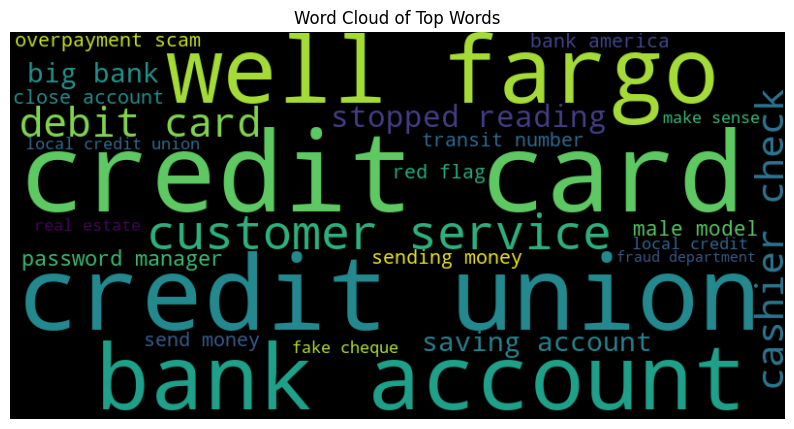

In [220]:
# Sample documents
documents = WFC_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'sure', 'year', 'let', 'doe', 'wood', 'gundy'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

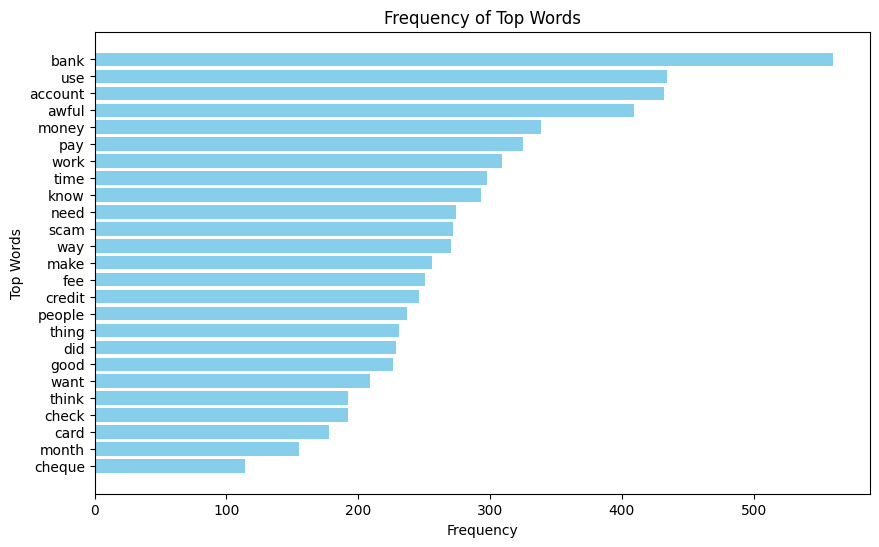

Top Words      Frequency
-----------  -----------
bank                 560
use                  434
account              432
awful                409
money                339
pay                  325
work                 309
time                 298
know                 293
need                 274
scam                 272
way                  270
make                 256
fee                  251
credit               246
people               237
thing                231
did                  229
good                 226
want                 209
think                192
check                192
card                 178
month                155
cheque               114


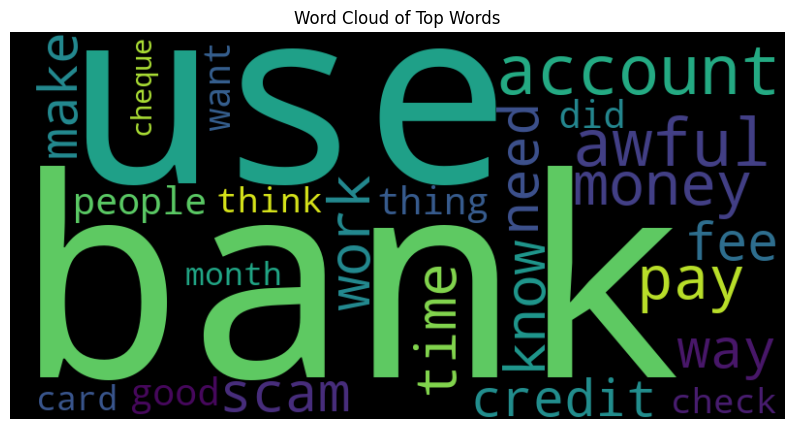

In [221]:
# Sample documents
documents = WFC_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'sure', 'year', 'let', 'doe', 'wood', 'gundy'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

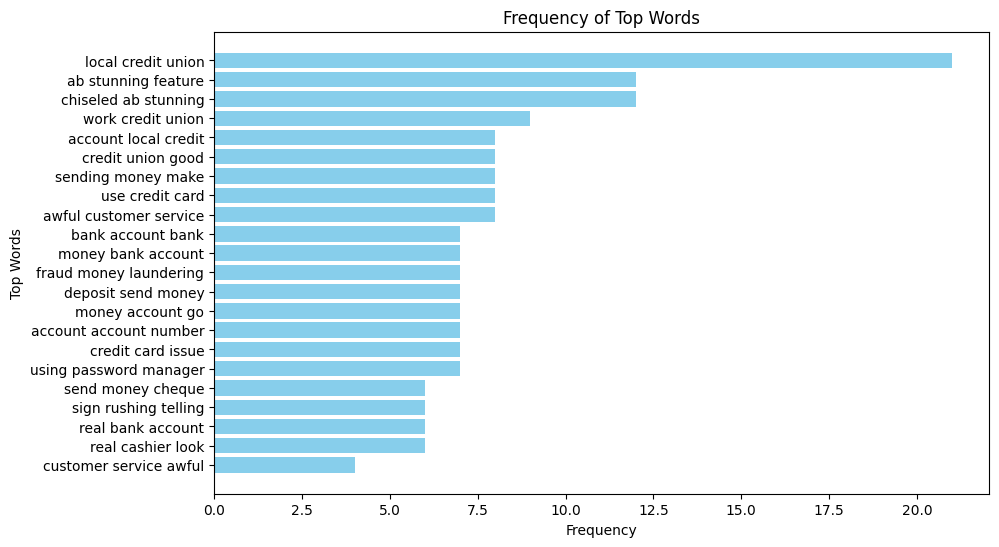

Top Words                 Frequency
----------------------  -----------
local credit union               21
ab stunning feature              12
chiseled ab stunning             12
work credit union                 9
account local credit              8
credit union good                 8
sending money make                8
use credit card                   8
awful customer service            8
bank account bank                 7
money bank account                7
fraud money laundering            7
deposit send money                7
money account go                  7
account account number            7
credit card issue                 7
using password manager            7
send money cheque                 6
sign rushing telling              6
real bank account                 6
real cashier look                 6
customer service awful            4


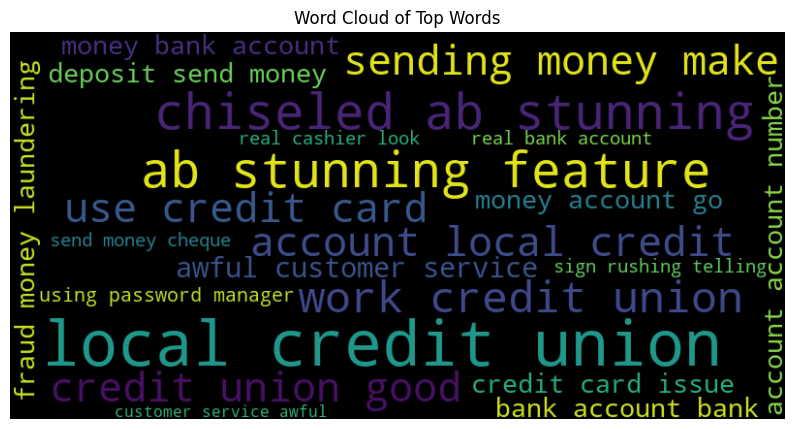

In [222]:
# Sample documents
documents = WFC_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'sure', 'year', 'let', 'doe', 'wood', 'gundy'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

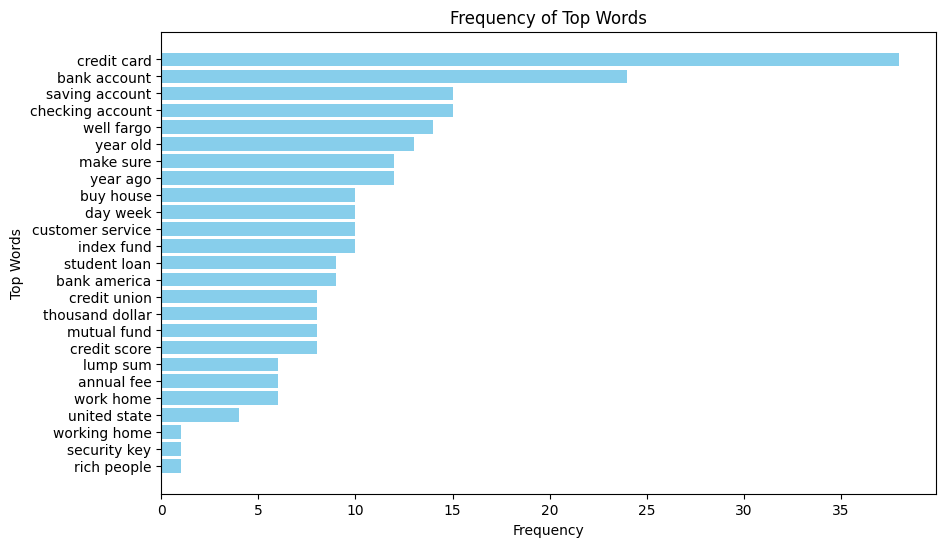

Top Words           Frequency
----------------  -----------
credit card                38
bank account               24
saving account             15
checking account           15
well fargo                 14
year old                   13
make sure                  12
year ago                   12
buy house                  10
day week                   10
customer service           10
index fund                 10
student loan                9
bank america                9
credit union                8
thousand dollar             8
mutual fund                 8
credit score                8
lump sum                    6
annual fee                  6
work home                   6
united state                4
working home                1
security key                1
rich people                 1


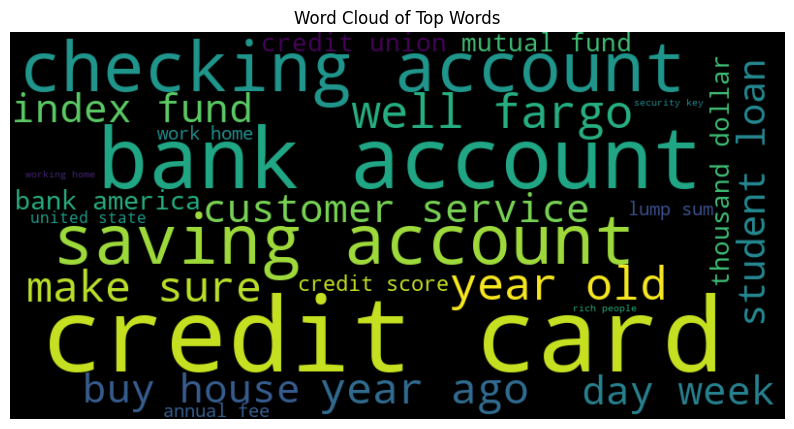

In [223]:
documents2 = WFC_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'let', 'sweet'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

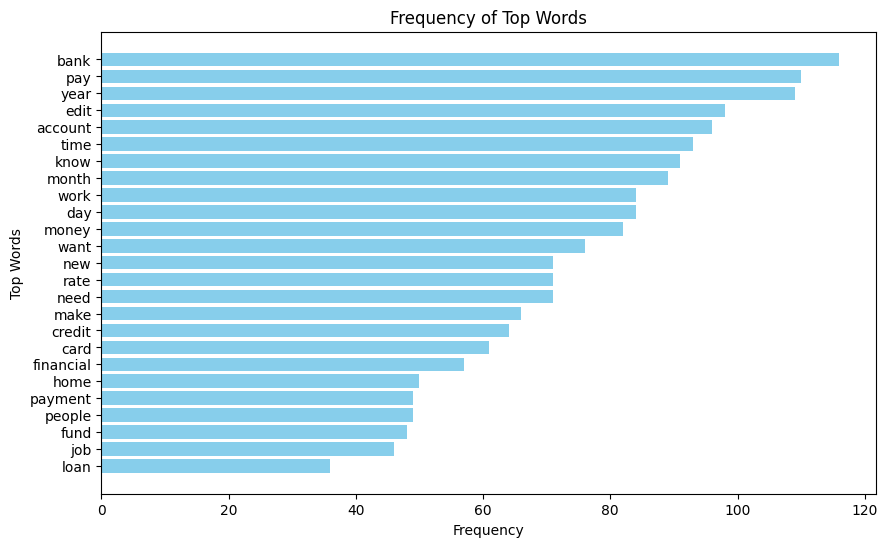

Top Words      Frequency
-----------  -----------
bank                 116
pay                  110
year                 109
edit                  98
account               96
time                  93
know                  91
month                 89
work                  84
day                   84
money                 82
want                  76
new                   71
rate                  71
need                  71
make                  66
credit                64
card                  61
financial             57
home                  50
payment               49
people                49
fund                  48
job                   46
loan                  36


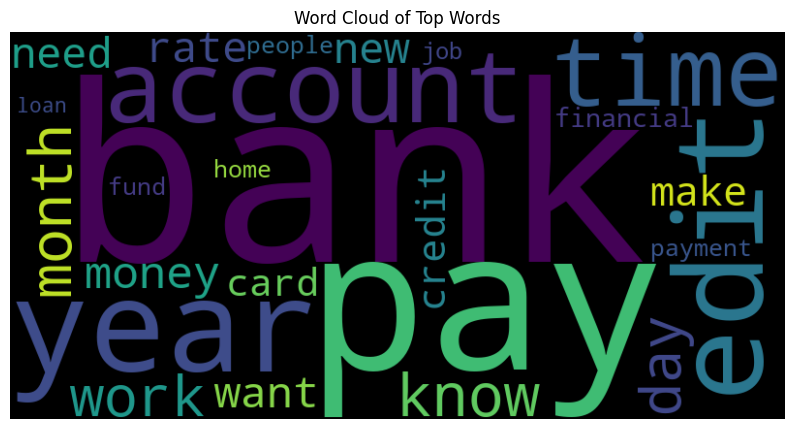

In [224]:
documents2 = WFC_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'let', 'sweet'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

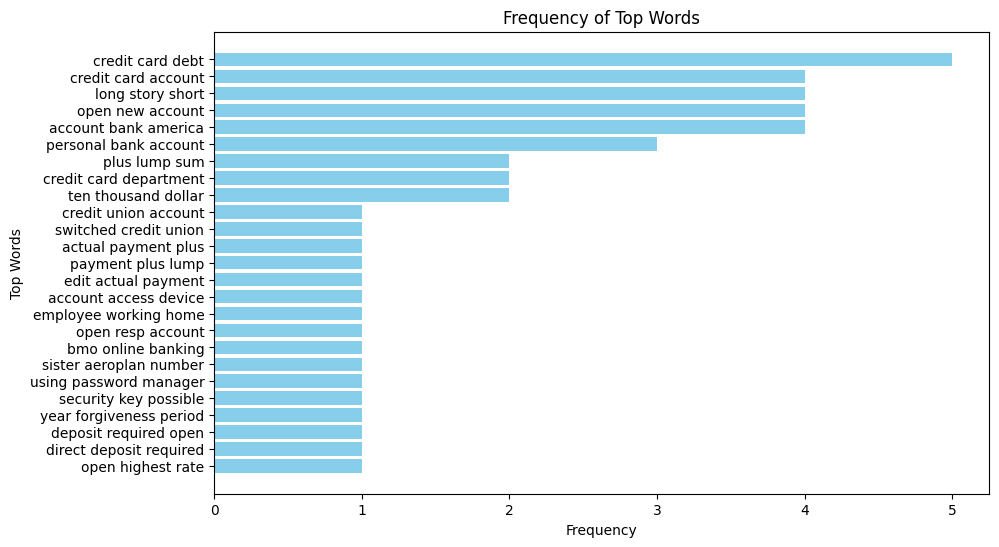

Top Words                  Frequency
-----------------------  -----------
credit card debt                   5
credit card account                4
long story short                   4
open new account                   4
account bank america               4
personal bank account              3
plus lump sum                      2
credit card department             2
ten thousand dollar                2
credit union account               1
switched credit union              1
actual payment plus                1
payment plus lump                  1
edit actual payment                1
account access device              1
employee working home              1
open resp account                  1
bmo online banking                 1
sister aeroplan number             1
using password manager             1
security key possible              1
year forgiveness period            1
deposit required open              1
direct deposit required            1
open highest rate                  1


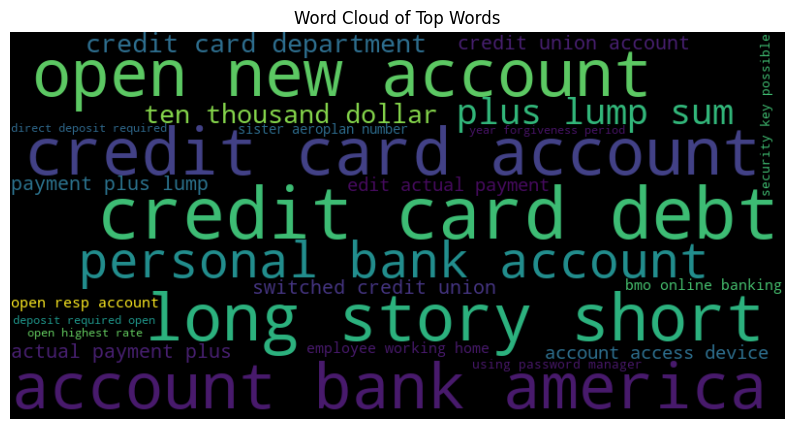

In [225]:
documents2 = WFC_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'let', 'sweet'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## Bank of America Dataset

In [226]:
# Specify the element you want to filter for in the link
target_element = 'bankofamerica_'
target = ['bank of america','BofA', 'BoA'] 

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

url_mask = df3['url'].str.contains(fr'/r/{target_element}/', case=False)

# Convert the target keywords to lowercase
lowercase_target = [keyword.lower() for keyword in target]

# Use any() to check if any element in the 'target' list is present in 'comment' and 'submission_comment'
comment_mask = df3['comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))
submission_comment_mask = df3['submission_comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))

# Combine the masks using logical OR
Bank_of_America_values = url_mask | comment_mask | submission_comment_mask

# Apply the mask to subset the DataFrame
Bank_of_America_df = df3[Bank_of_America_values]

# Display the result
Bank_of_America_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
54,Recent Private Banking experiences - CIBC vs S...,yggt1g,tradinghumble,2022-10-29 07:06:26,11,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,36,1334214,Banking,I was offered CIBC and Scotia Private Banking...,https://www.reddit.com/r/PersonalFinanceCanada...,"Scotiabank is in internal disarray these days,...",3,2022-10-29 12:21:26
70,Big 5 - Private Banking,ycrusv,Super_Toot,2022-10-24 21:02:57,3,0.60,https://www.reddit.com/r/PersonalFinanceCanada...,14,1334214,Banking,Is it worth it? Do you get many perks?\n\nAny...,https://www.reddit.com/r/PersonalFinanceCanada...,Where I work you need to have a net worth of 3...,8,2022-10-25 09:07:39
109,Wealthsimple on brink of largest-ever Canadian...,n3yf9x,Rudiger,2021-05-03 11:07:16,945,0.97,https://www.reddit.com/r/PersonalFinanceCanada...,434,1334214,NaN,[Wealthsimple announces landmark $750-million...,https://www.reddit.com/r/PersonalFinanceCanada...,this is my meme now in billboards pls cımmemt ...,1,2021-05-04 16:07:17
187,Wealthsimple on brink of largest-ever Canadian...,n3yf9x,Rudiger,2021-05-03 11:07:16,945,0.97,https://www.reddit.com/r/PersonalFinanceCanada...,434,1334214,NaN,[Wealthsimple announces landmark $750-million...,https://www.reddit.com/r/PersonalFinanceCanada...,Robinhood makes money from payment for order f...,11,2021-05-03 15:45:33
557,How Much Do You Need to Be Considered Wealthy ...,v5myns,tsarkoba,2022-06-05 17:24:00,37,0.75,https://www.reddit.com/r/PersonalFinanceCanada...,97,1334214,NaN,Saw a bloomberg article in the US about $2.2 m...,https://www.reddit.com/r/PersonalFinanceCanada...,I agree. My brother-in-law makes something lik...,2,2022-06-06 09:03:41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211447,Best place for a traditional IRA?,e3xprp,HapticChange,2019-11-30 10:06:27,1,0.60,https://www.reddit.com/r/personalfinance/comme...,12,18717209,Retirement,"People say Vanguard, Fidelity...I have all our...",https://www.reddit.com/r/personalfinance/comme...,"Their own funds are not your best choice, and ...",2,2019-11-30 10:17:58
211448,Best place for a traditional IRA?,e3xprp,HapticChange,2019-11-30 10:06:27,1,0.60,https://www.reddit.com/r/personalfinance/comme...,12,18717209,Retirement,"People say Vanguard, Fidelity...I have all our...",https://www.reddit.com/r/personalfinance/comme...,The choice between the 3 I listed comes down t...,3,2019-11-30 10:18:19
211555,Live-in boyfriend started at a hedge fund. Can...,75sjjh,fuckinghedgefunds,2017-10-11 18:07:33,69,0.80,https://www.reddit.com/r/personalfinance/comme...,54,18717209,Investing,Hi! Throwaway because I don't like talking abo...,https://www.reddit.com/r/personalfinance/comme...,One thing everyone here is overlooking is that...,2,2017-10-12 09:42:59
211560,Live-in boyfriend started at a hedge fund. Can...,75sjjh,fuckinghedgefunds,2017-10-11 18:07:33,69,0.80,https://www.reddit.com/r/personalfinance/comme...,54,18717209,Investing,Hi! Throwaway because I don't like talking abo...,https://www.reddit.com/r/personalfinance/comme...,Work in the industry. There are two big parts ...,1,2017-10-12 10:33:08


In [227]:
# Sample documents
documents = Bank_of_America_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,10963
1,Neutral,4008
2,Negative,3492


In [228]:
documents2 = Bank_of_America_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,587
1,Negative,96
2,Neutral,29


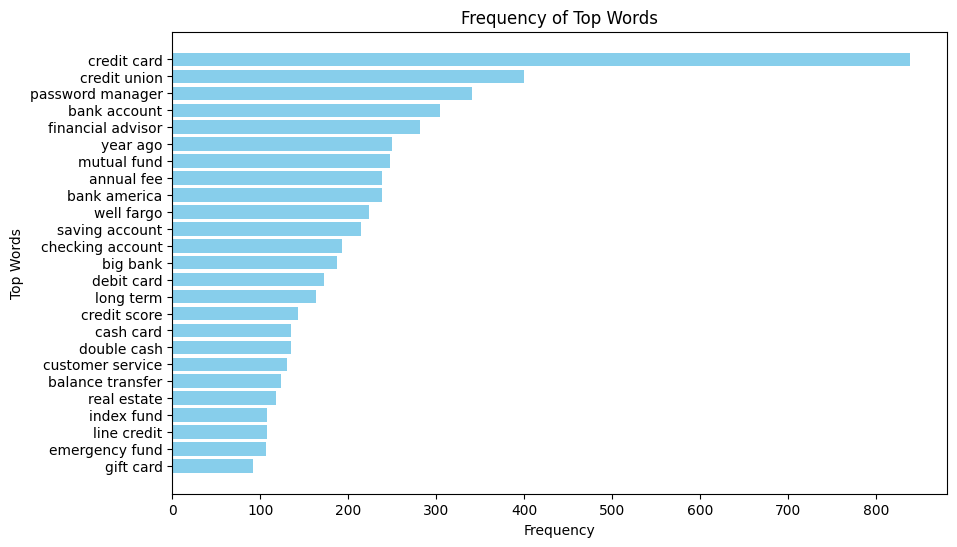

Top Words            Frequency
-----------------  -----------
credit card                839
credit union               400
password manager           341
bank account               304
financial advisor          282
year ago                   250
mutual fund                247
annual fee                 238
bank america               238
well fargo                 224
saving account             215
checking account           193
big bank                   187
debit card                 173
long term                  163
credit score               143
cash card                  135
double cash                135
customer service           130
balance transfer           124
real estate                118
index fund                 108
line credit                108
emergency fund             107
gift card                   92


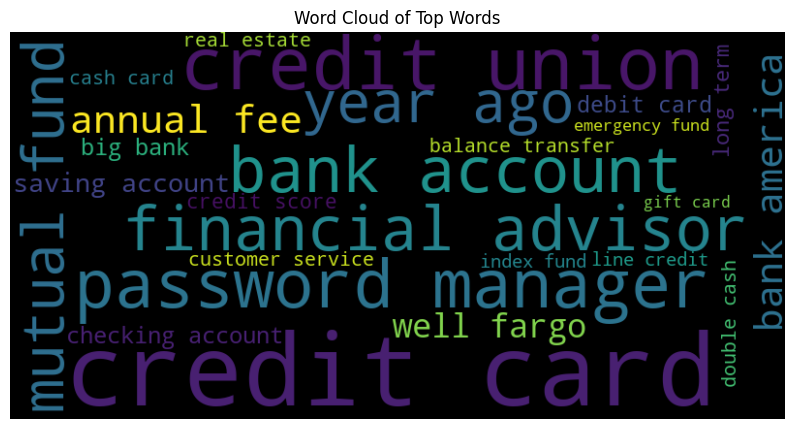

In [229]:
# Sample documents
documents = Bank_of_America_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'make', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

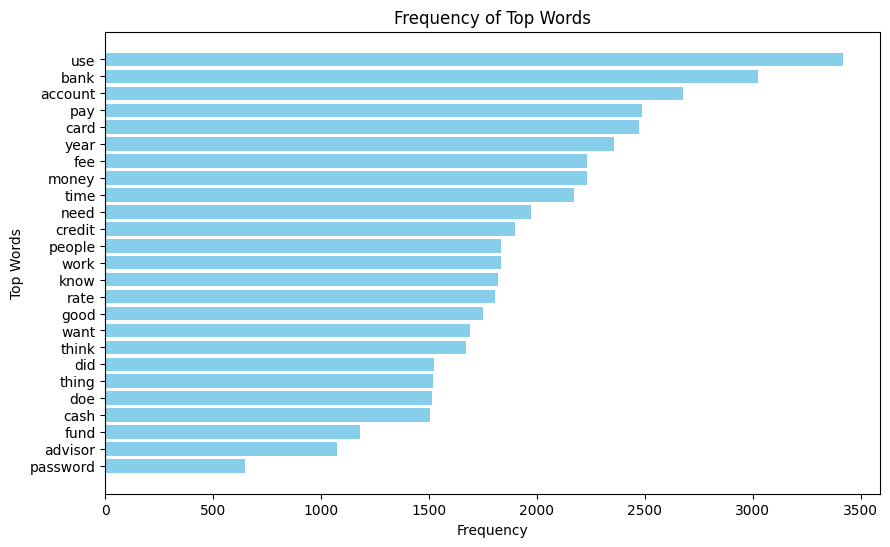

Top Words      Frequency
-----------  -----------
use                 3420
bank                3023
account             2675
pay                 2485
card                2473
year                2359
fee                 2230
money               2230
time                2173
need                1973
credit              1900
people              1835
work                1834
know                1821
rate                1805
good                1750
want                1689
think               1670
did                 1522
thing               1517
doe                 1514
cash                1503
fund                1181
advisor             1074
password             647


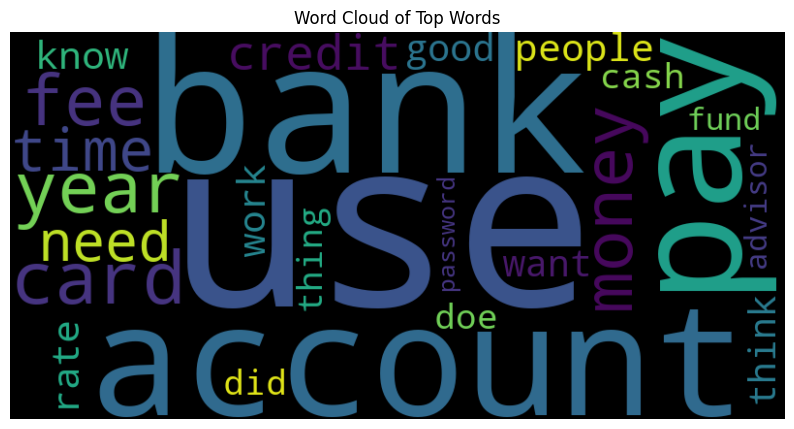

In [230]:
# Sample documents
documents = Bank_of_America_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'make', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

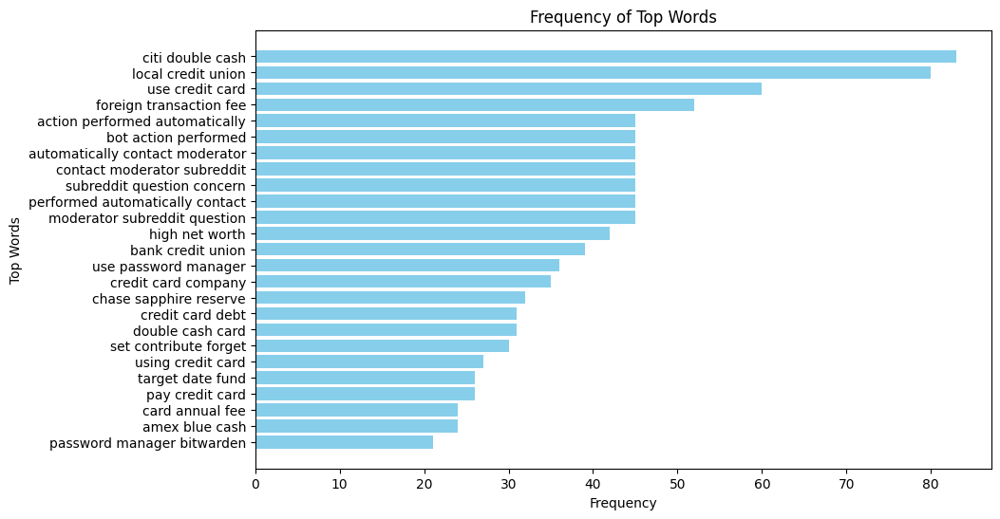

Top Words                          Frequency
-------------------------------  -----------
citi double cash                          83
local credit union                        80
use credit card                           60
foreign transaction fee                   52
action performed automatically            45
bot action performed                      45
automatically contact moderator           45
contact moderator subreddit               45
subreddit question concern                45
performed automatically contact           45
moderator subreddit question              45
high net worth                            42
bank credit union                         39
use password manager                      36
credit card company                       35
chase sapphire reserve                    32
credit card debt                          31
double cash card                          31
set contribute forget                     30
using credit card                         27
target dat

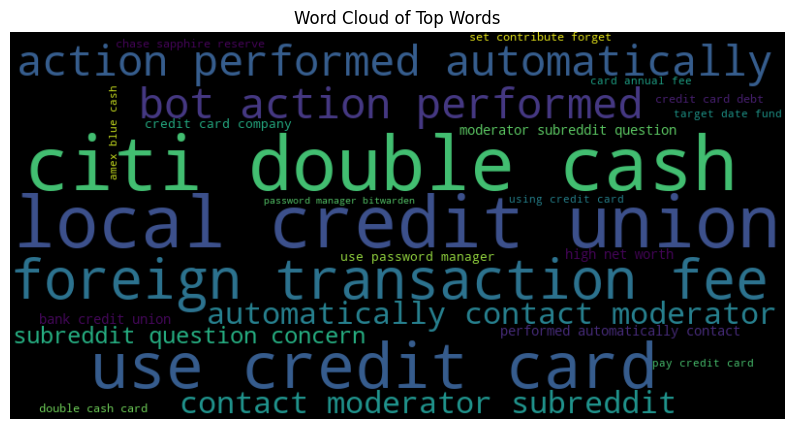

In [231]:
# Sample documents
documents = Bank_of_America_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'make', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

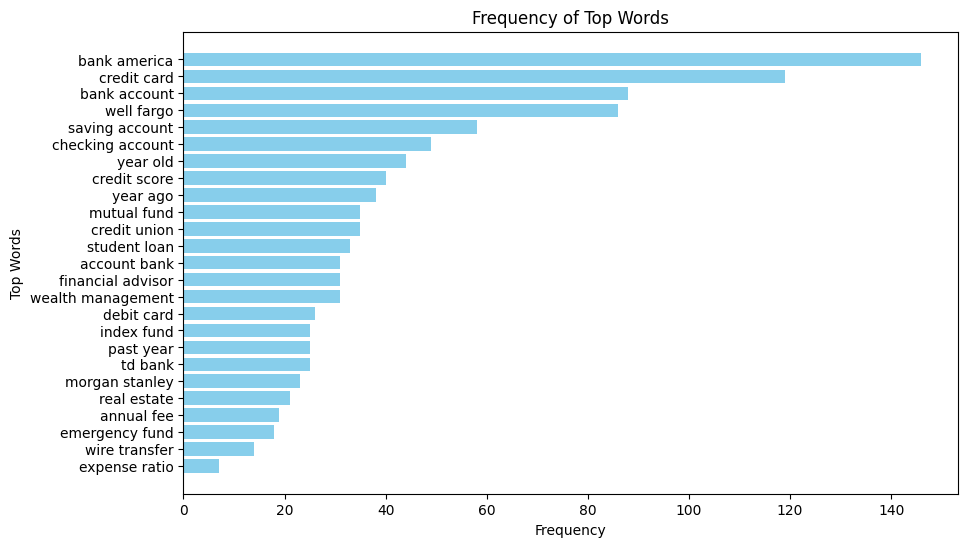

Top Words            Frequency
-----------------  -----------
bank america               146
credit card                119
bank account                88
well fargo                  86
saving account              58
checking account            49
year old                    44
credit score                40
year ago                    38
mutual fund                 35
credit union                35
student loan                33
account bank                31
financial advisor           31
wealth management           31
debit card                  26
index fund                  25
past year                   25
td bank                     25
morgan stanley              23
real estate                 21
annual fee                  19
emergency fund              18
wire transfer               14
expense ratio                7


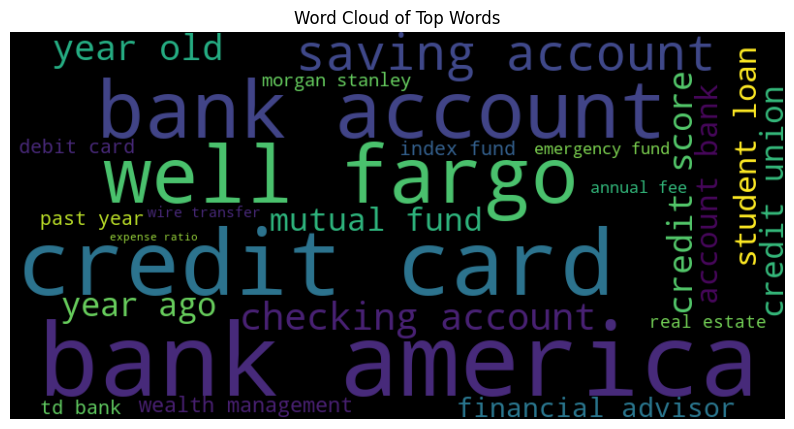

In [232]:
documents2 = Bank_of_America_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

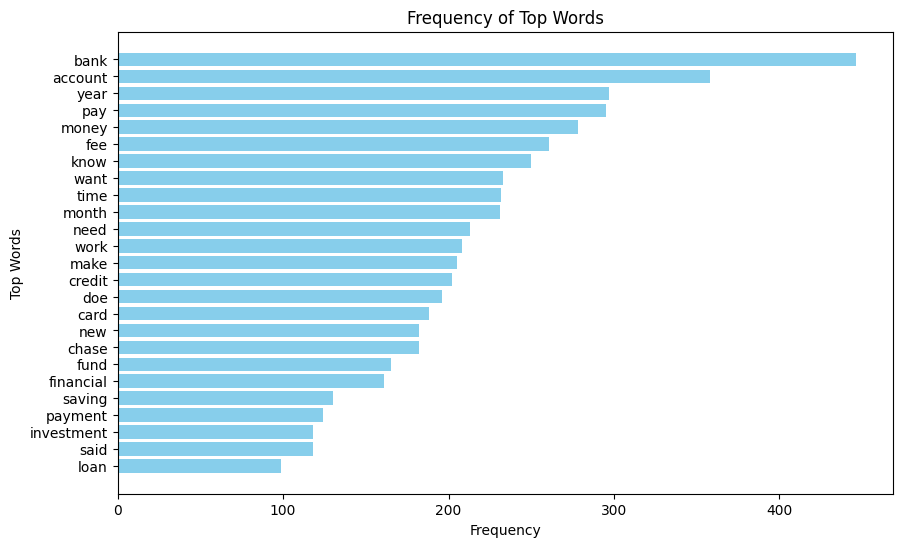

Top Words      Frequency
-----------  -----------
bank                 446
account              358
year                 297
pay                  295
money                278
fee                  261
know                 250
want                 233
time                 232
month                231
need                 213
work                 208
make                 205
credit               202
doe                  196
card                 188
new                  182
chase                182
fund                 165
financial            161
saving               130
payment              124
investment           118
said                 118
loan                  99


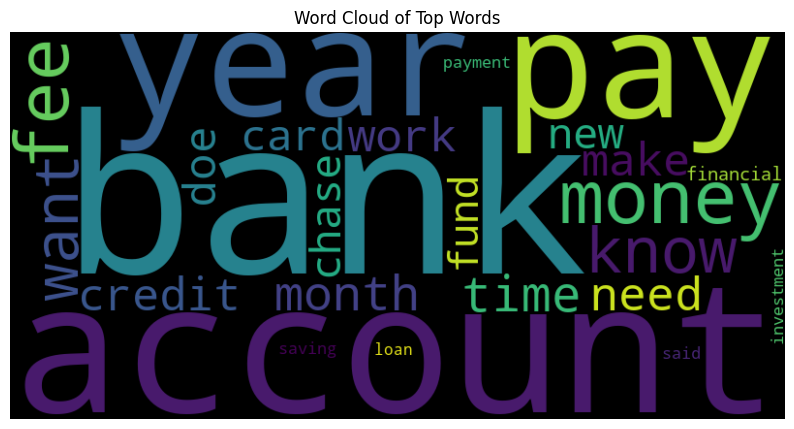

In [233]:
documents2 = Bank_of_America_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

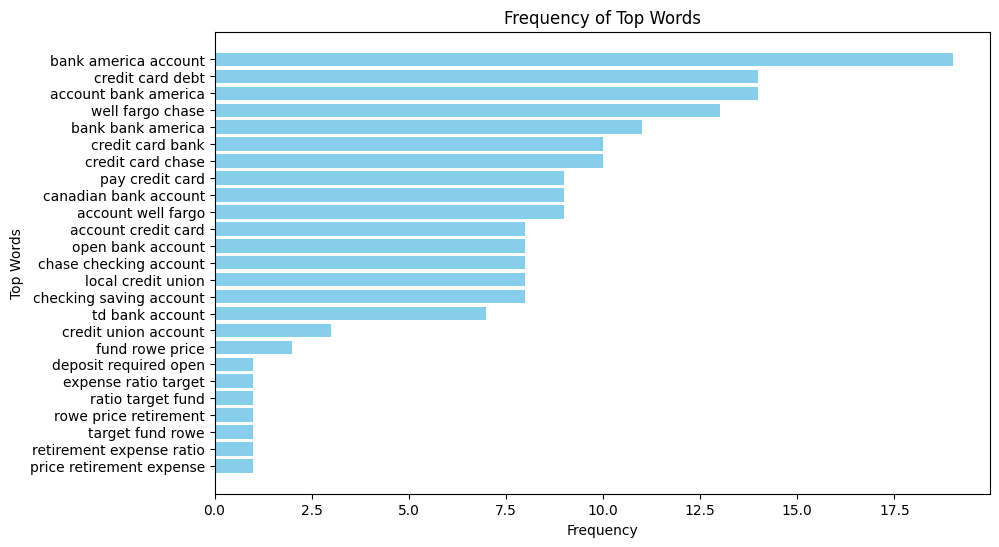

Top Words                   Frequency
------------------------  -----------
bank america account               19
credit card debt                   14
account bank america               14
well fargo chase                   13
bank bank america                  11
credit card bank                   10
credit card chase                  10
pay credit card                     9
canadian bank account               9
account well fargo                  9
account credit card                 8
open bank account                   8
chase checking account              8
local credit union                  8
checking saving account             8
td bank account                     7
credit union account                3
fund rowe price                     2
deposit required open               1
expense ratio target                1
ratio target fund                   1
rowe price retirement               1
target fund rowe                    1
retirement expense ratio            1
price retire

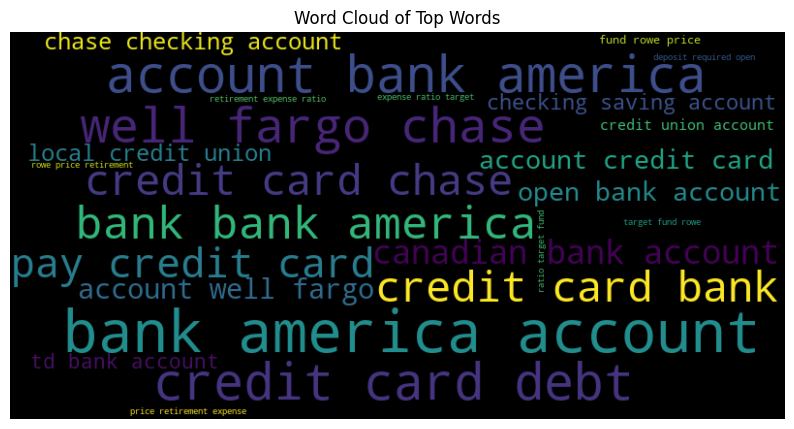

In [234]:
documents2 = Bank_of_America_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## Citigroup Dataset

In [235]:
# Specify the element you want to filter for in the link
target_element = 'citigroup'
target = ['citigroup','citi'] 

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

url_mask = df3['url'].str.contains(fr'/r/{target_element}/', case=False)

# Convert the target keywords to lowercase
lowercase_target = [keyword.lower() for keyword in target]

# Use any() to check if any element in the 'target' list is present in 'comment' and 'submission_comment'
comment_mask = df3['comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))
submission_comment_mask = df3['submission_comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))

# Combine the masks using logical OR
citigroup_values = url_mask | comment_mask | submission_comment_mask

# Apply the mask to subset the DataFrame
citigroup_df = df3[citigroup_values]
citigroup_df.drop_duplicates(inplace=True)

# Display the result
citigroup_df

C:\Users\gabri\AppData\Local\Temp\ipykernel_22852\1641672885.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  citigroup_df.drop_duplicates(inplace=True)


,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
89,Wealthsimple on brink of largest-ever Canadian...,n3yf9x,Rudiger,2021-05-03 11:07:16,945,0.97,https://www.reddit.com/r/PersonalFinanceCanada...,434,1334214,NaN,[Wealthsimple announces landmark $750-million...,https://www.reddit.com/r/PersonalFinanceCanada...,Exciting news! it's great to see an increase ...,29,2021-05-03 12:55:40
110,Wealthsimple on brink of largest-ever Canadian...,n3yf9x,Rudiger,2021-05-03 11:07:16,945,0.97,https://www.reddit.com/r/PersonalFinanceCanada...,434,1334214,NaN,[Wealthsimple announces landmark $750-million...,https://www.reddit.com/r/PersonalFinanceCanada...,Exactly! As a US dual citizen not being able t...,61,2021-05-03 12:45:03
250,Job in Private Banking,9oq5p2,JMSNINETYTHREE,2018-10-16 14:07:36,12,0.88,https://www.reddit.com/r/PersonalFinanceCanada...,22,1334214,Banking,"Hi All,\n\nI hesitated posting this, as I'm no...",https://www.reddit.com/r/PersonalFinanceCanada...,Pretty much we offer loans to people through m...,1,2018-10-16 18:33:21
1221,Daycare won't provide receipt,17wv9pd,ButterlessToast96,2023-11-16 14:30:43,173,0.91,https://www.reddit.com/r/PersonalFinanceCanada...,113,1334214,Taxes,We send our toddler to a private daycare. The ...,https://www.reddit.com/r/PersonalFinanceCanada...,"That is normal in big cities. I paid over $1,5...",7,2023-11-17 07:47:35
1610,Selling my house and the realtor is taking 5%....,sgjj1a,notgettingany69,2022-01-30 16:30:55,829,0.89,https://www.reddit.com/r/PersonalFinanceCanada...,620,1334214,NaN,Edit- ya a week course. I said it. “40 hours t...,https://www.reddit.com/r/PersonalFinanceCanada...,And you don't even need to.\n\nPrivate citizen...,3,2022-01-31 08:12:06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211337,Canada-US tax: can I get an ITIN with an emplo...,vrzs5r,fittyfive9,2022-07-05 10:57:17,2,0.76,https://www.reddit.com/r/personalfinance/comme...,3,18717209,Taxes,I’m buying company stock through ETRADE by Mor...,https://www.reddit.com/r/personalfinance/comme...,Thnx,1,2022-07-05 15:14:40
211368,Question about wire transfers,e6qpqc,Vyce44,2019-12-05 19:42:47,0,0.40,https://www.reddit.com/r/personalfinance/comme...,3,18717209,Other,\nI’ll try to keep this short\n\nI initiated a...,https://www.reddit.com/r/personalfinance/comme...,Wait a while. Stop using wire transfers. You s...,3,2019-12-05 20:50:31
211369,Question about wire transfers,e6qpqc,Vyce44,2019-12-05 19:42:47,0,0.40,https://www.reddit.com/r/personalfinance/comme...,3,18717209,Other,\nI’ll try to keep this short\n\nI initiated a...,https://www.reddit.com/r/personalfinance/comme...,Yeah lesson learned but they only charged $10....,1,2019-12-05 21:15:28
211370,Question about wire transfers,e6qpqc,Vyce44,2019-12-05 19:42:47,0,0.40,https://www.reddit.com/r/personalfinance/comme...,3,18717209,Other,\nI’ll try to keep this short\n\nI initiated a...,https://www.reddit.com/r/personalfinance/comme...,You can always ask if they'll refund the fee. ...,1,2019-12-05 21:26:52


In [236]:
# Sample documents
documents = citigroup_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,7230
1,Neutral,2506
2,Negative,2084


In [237]:
documents2 = citigroup_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,409
1,Negative,58
2,Neutral,14


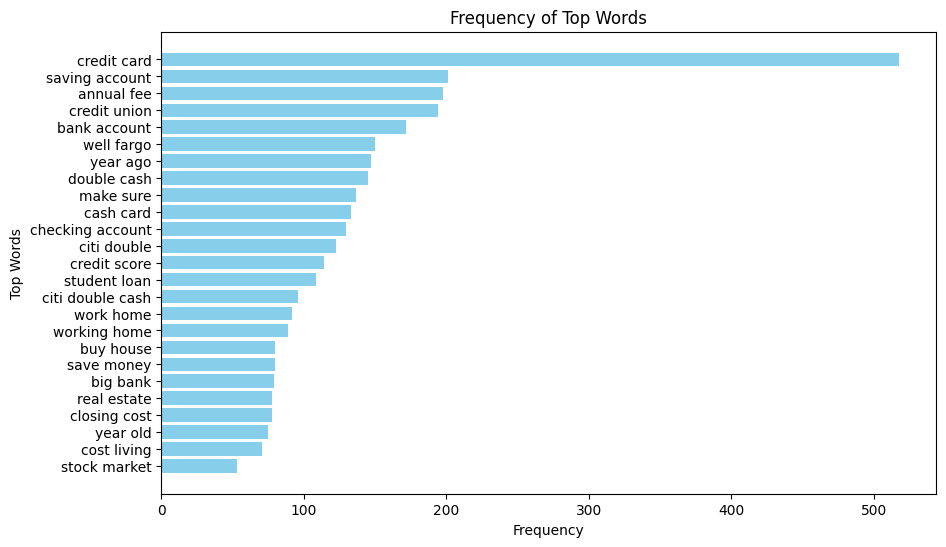

Top Words           Frequency
----------------  -----------
credit card               518
saving account            201
annual fee                198
credit union              194
bank account              172
well fargo                150
year ago                  147
double cash               145
make sure                 137
cash card                 133
checking account          130
citi double               123
credit score              114
student loan              109
citi double cash           96
work home                  92
working home               89
buy house                  80
save money                 80
big bank                   79
real estate                78
closing cost               78
year old                   75
cost living                71
stock market               53


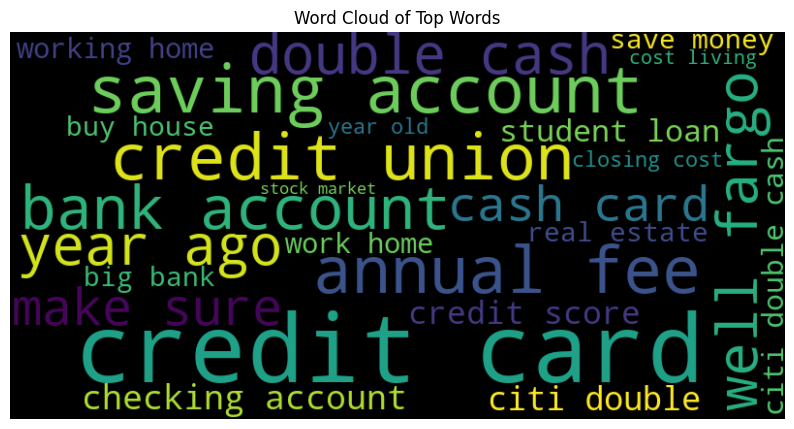

In [238]:
# Sample documents
documents = citigroup_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'sense', 'http', 'gon', 'na'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

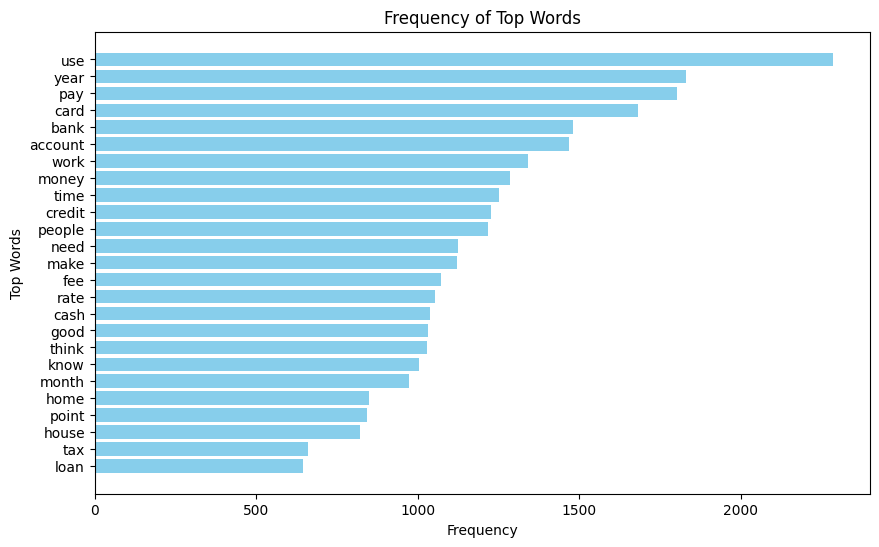

Top Words      Frequency
-----------  -----------
use                 2284
year                1830
pay                 1803
card                1681
bank                1480
account             1467
work                1341
money               1284
time                1250
credit              1225
people              1218
need                1125
make                1120
fee                 1073
rate                1053
cash                1037
good                1033
think               1028
know                1005
month                974
home                 850
point                842
house                820
tax                  659
loan                 644


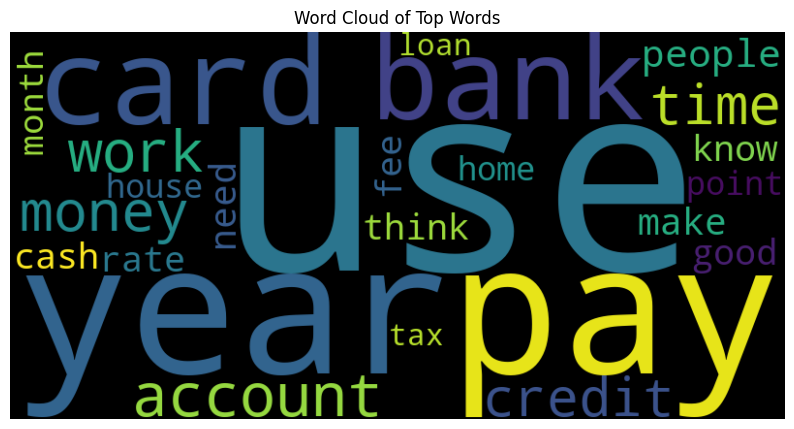

In [239]:
# Sample documents
documents = citigroup_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'sense', 'http', 'gon', 'na'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

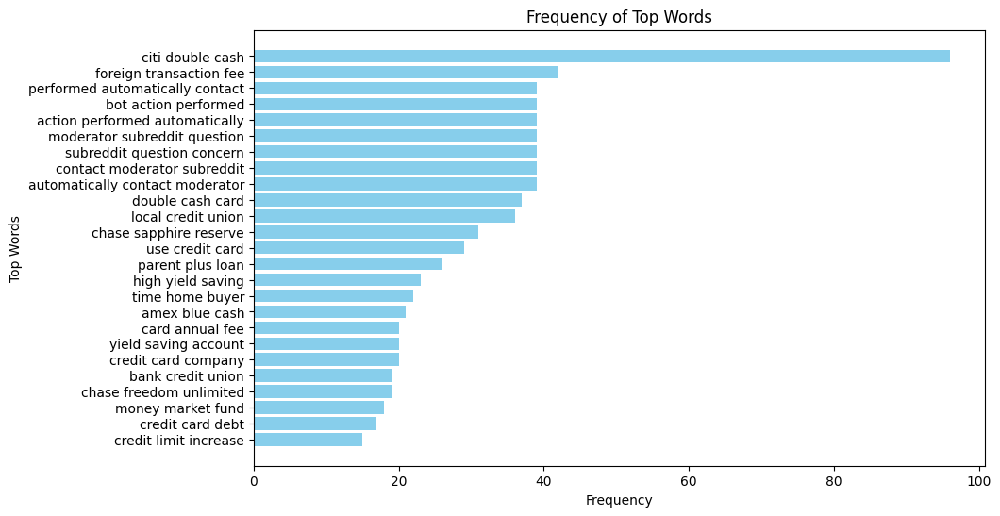

Top Words                          Frequency
-------------------------------  -----------
citi double cash                          96
foreign transaction fee                   42
performed automatically contact           39
bot action performed                      39
action performed automatically            39
moderator subreddit question              39
subreddit question concern                39
contact moderator subreddit               39
automatically contact moderator           39
double cash card                          37
local credit union                        36
chase sapphire reserve                    31
use credit card                           29
parent plus loan                          26
high yield saving                         23
time home buyer                           22
amex blue cash                            21
card annual fee                           20
yield saving account                      20
credit card company                       20
bank credi

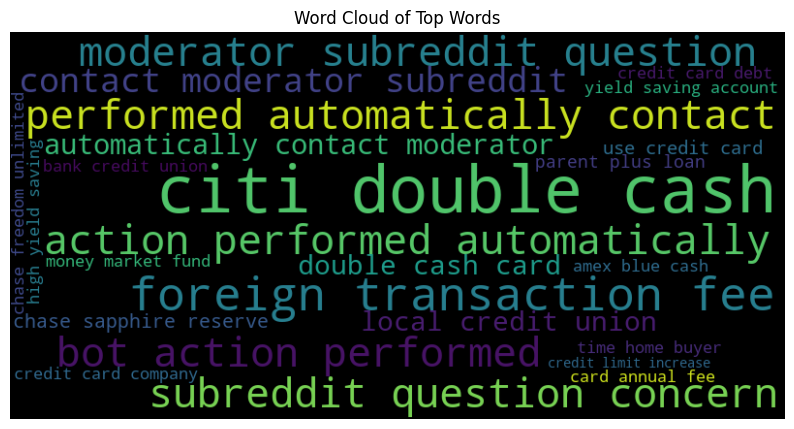

In [240]:
# Sample documents
documents = citigroup_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'sense', 'http', 'gon', 'na'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

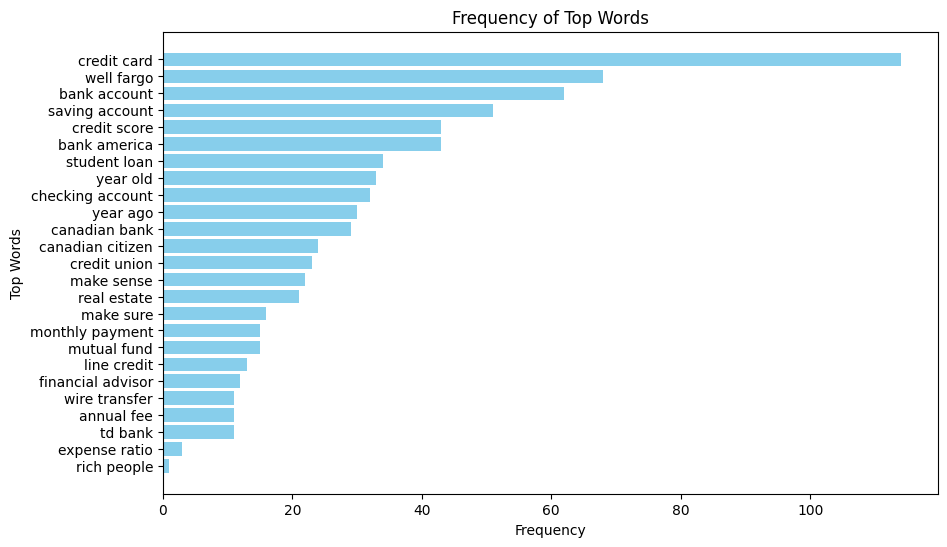

Top Words            Frequency
-----------------  -----------
credit card                114
well fargo                  68
bank account                62
saving account              51
credit score                43
bank america                43
student loan                34
year old                    33
checking account            32
year ago                    30
canadian bank               29
canadian citizen            24
credit union                23
make sense                  22
real estate                 21
make sure                   16
monthly payment             15
mutual fund                 15
line credit                 13
financial advisor           12
wire transfer               11
annual fee                  11
td bank                     11
expense ratio                3
rich people                  1


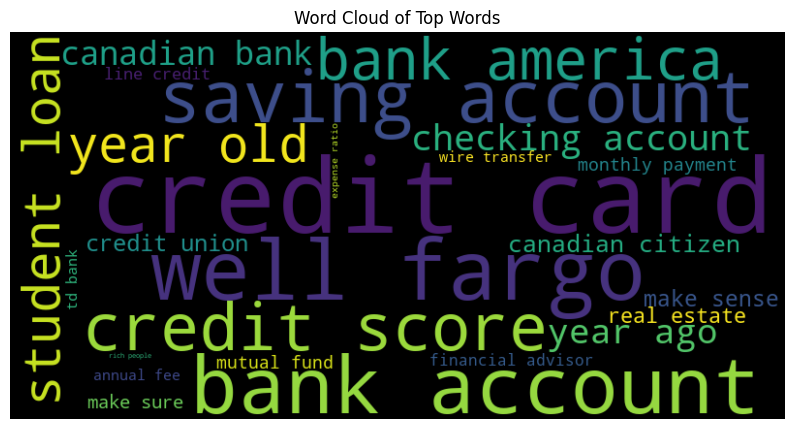

In [241]:
documents2 = citigroup_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

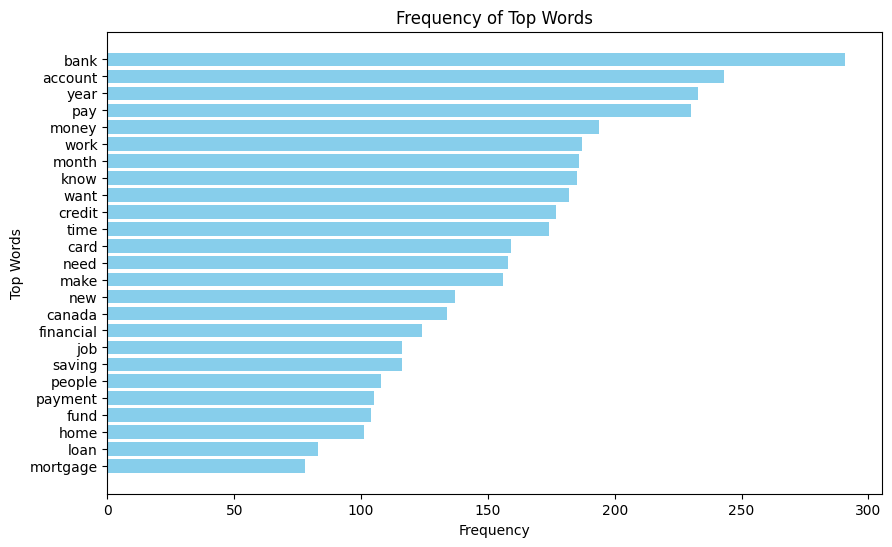

Top Words      Frequency
-----------  -----------
bank                 291
account              243
year                 233
pay                  230
money                194
work                 187
month                186
know                 185
want                 182
credit               177
time                 174
card                 159
need                 158
make                 156
new                  137
canada               134
financial            124
job                  116
saving               116
people               108
payment              105
fund                 104
home                 101
loan                  83
mortgage              78


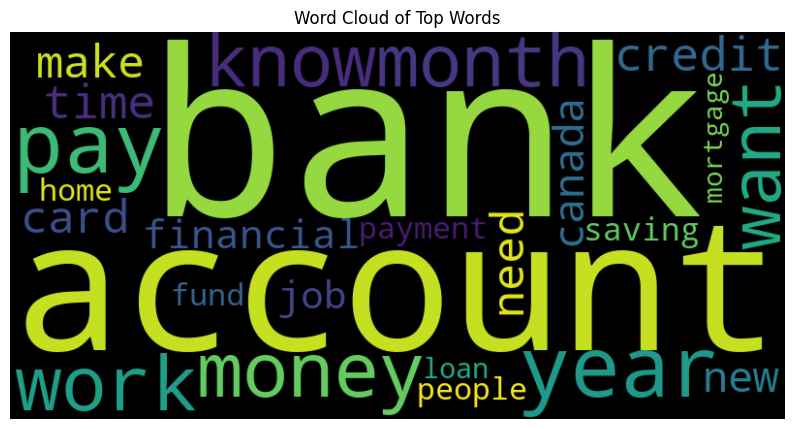

In [242]:
documents2 = citigroup_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

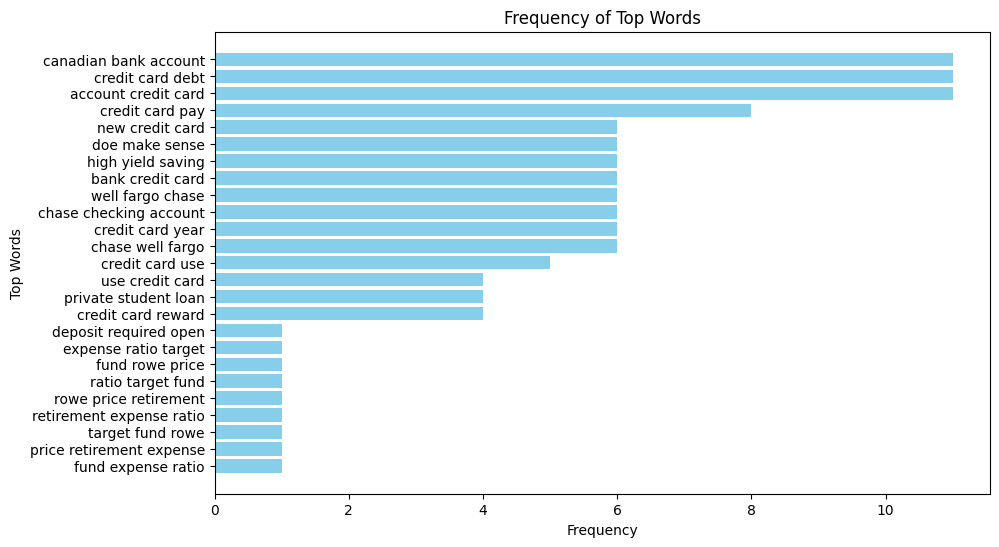

Top Words                   Frequency
------------------------  -----------
canadian bank account              11
credit card debt                   11
account credit card                11
credit card pay                     8
new credit card                     6
doe make sense                      6
high yield saving                   6
bank credit card                    6
well fargo chase                    6
chase checking account              6
credit card year                    6
chase well fargo                    6
credit card use                     5
use credit card                     4
private student loan                4
credit card reward                  4
deposit required open               1
expense ratio target                1
fund rowe price                     1
ratio target fund                   1
rowe price retirement               1
retirement expense ratio            1
target fund rowe                    1
price retirement expense            1
fund expense

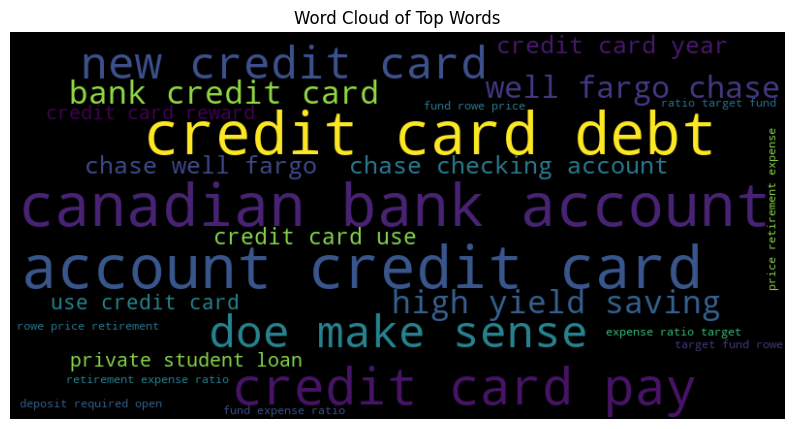

In [243]:
documents2 = citigroup_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## Morgan Stanley Dataset

In [244]:
# Specify the element you want to filter for in the link
target_element = 'Morgan Stanley'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
Morgan_Stanley_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
Morgan_Stanley_df = df3[Morgan_Stanley_values]

# Display the result
Morgan_Stanley_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
147278,Will the Banks Collapse?,hckqtk,YouAreBakwas,2020-06-20 07:30:07,0,0.26,https://www.reddit.com/r/PersonalFinanceCanada...,12,1338527,Debt,Interesting article...\n\nSource: [https://ww...,https://www.reddit.com/r/PersonalFinanceCanada...,[deleted],31,2020-06-20 07:53:29
147279,Will the Banks Collapse?,hckqtk,YouAreBakwas,2020-06-20 07:30:07,0,0.26,https://www.reddit.com/r/PersonalFinanceCanada...,12,1338527,Debt,Interesting article...\n\nSource: [https://ww...,https://www.reddit.com/r/PersonalFinanceCanada...,Sometimes I really only prefer TLDR;,10,2020-06-20 08:20:40
147280,Will the Banks Collapse?,hckqtk,YouAreBakwas,2020-06-20 07:30:07,0,0.26,https://www.reddit.com/r/PersonalFinanceCanada...,12,1338527,Debt,Interesting article...\n\nSource: [https://ww...,https://www.reddit.com/r/PersonalFinanceCanada...,Why am I reading about the US banking system o...,5,2020-06-20 08:05:05
147281,Will the Banks Collapse?,hckqtk,YouAreBakwas,2020-06-20 07:30:07,0,0.26,https://www.reddit.com/r/PersonalFinanceCanada...,12,1338527,Debt,Interesting article...\n\nSource: [https://ww...,https://www.reddit.com/r/PersonalFinanceCanada...,"They will not.\n\nAlso, you posted an article ...",4,2020-06-20 07:40:19
147282,Will the Banks Collapse?,hckqtk,YouAreBakwas,2020-06-20 07:30:07,0,0.26,https://www.reddit.com/r/PersonalFinanceCanada...,12,1338527,Debt,Interesting article...\n\nSource: [https://ww...,https://www.reddit.com/r/PersonalFinanceCanada...,"Excuse me, some of the posts on here have $200...",2,2020-06-20 10:51:43
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211760,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,I dont think any savings account is paying goo...,1,2022-10-14 05:20:49
211761,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,Follow a personal finance plan or framework. L...,1,2022-10-14 06:43:27
211762,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,Gracias!\nI want to have enough money to buy a...,1,2022-10-14 05:11:48
211763,Am I being an Intelligent investor?,y3o5qs,GrauDiego,2022-10-14 04:28:54,0,0.50,https://www.reddit.com/r/personalfinance/comme...,6,18717209,Investing,"Hello Reddit, Im a 21yo Spaniard and I have do...",https://www.reddit.com/r/personalfinance/comme...,Thanks for the answer man! I will definitely r...,1,2022-10-17 02:45:52


In [245]:
# Sample documents
documents = Morgan_Stanley_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,2493
1,Neutral,812
2,Negative,684


In [246]:
documents2 = Morgan_Stanley_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,203
1,Negative,28
2,Neutral,8


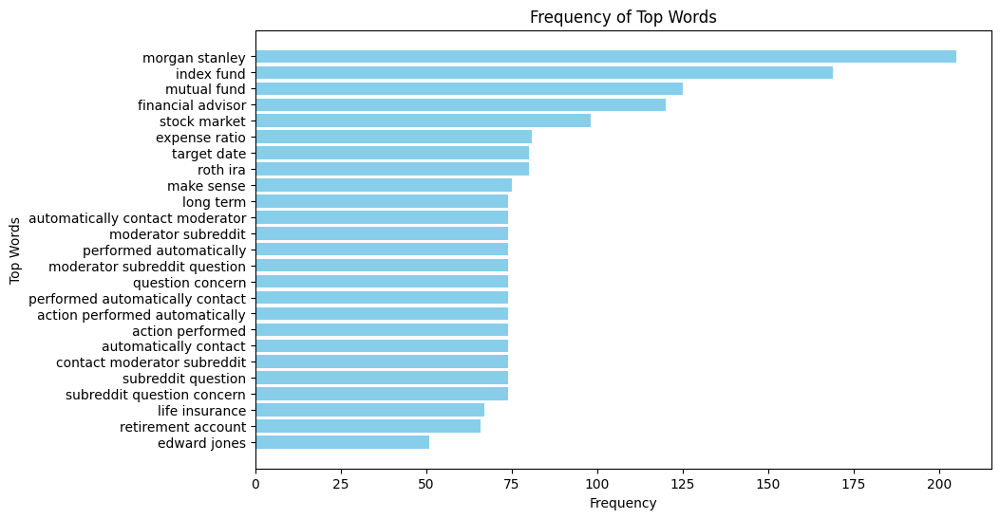

Top Words                          Frequency
-------------------------------  -----------
morgan stanley                           205
index fund                               169
mutual fund                              125
financial advisor                        120
stock market                              98
expense ratio                             81
target date                               80
roth ira                                  80
make sense                                75
long term                                 74
automatically contact moderator           74
moderator subreddit                       74
performed automatically                   74
moderator subreddit question              74
question concern                          74
performed automatically contact           74
action performed automatically            74
action performed                          74
automatically contact                     74
contact moderator subreddit               74
subreddit 

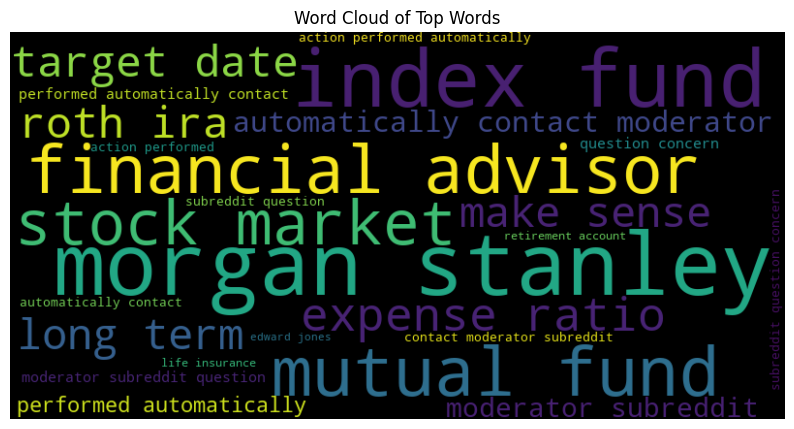

In [247]:
# Sample documents
documents = Morgan_Stanley_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['tldr'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

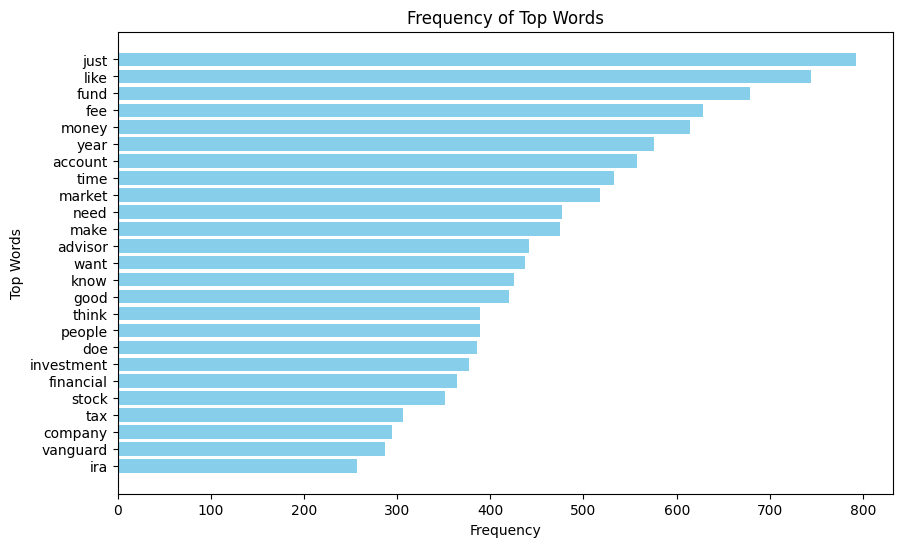

Top Words      Frequency
-----------  -----------
just                 792
like                 744
fund                 679
fee                  628
money                614
year                 576
account              557
time                 533
market               518
need                 477
make                 475
advisor              442
want                 437
know                 425
good                 420
think                389
people               389
doe                  386
investment           377
financial            364
stock                351
tax                  306
company              294
vanguard             287
ira                  257


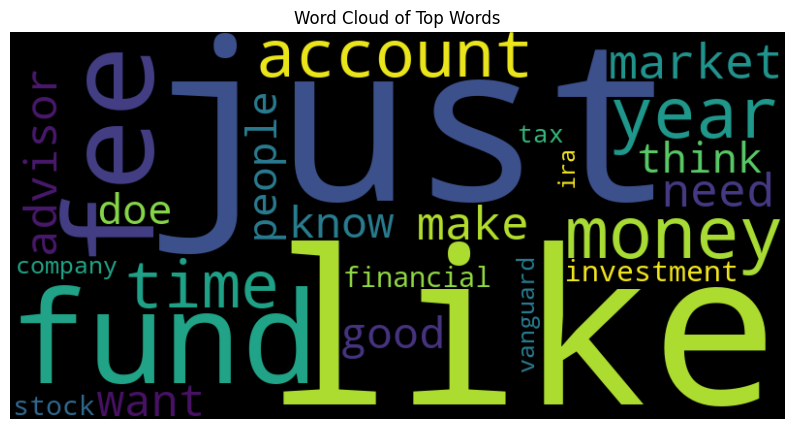

In [248]:
# Sample documents
documents = Morgan_Stanley_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['tldr'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

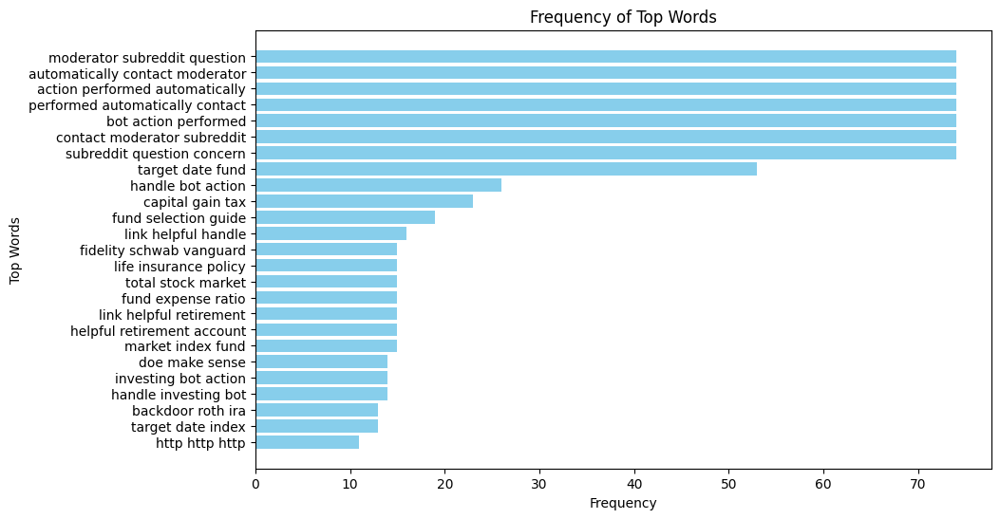

Top Words                          Frequency
-------------------------------  -----------
moderator subreddit question              74
automatically contact moderator           74
action performed automatically            74
performed automatically contact           74
bot action performed                      74
contact moderator subreddit               74
subreddit question concern                74
target date fund                          53
handle bot action                         26
capital gain tax                          23
fund selection guide                      19
link helpful handle                       16
fidelity schwab vanguard                  15
life insurance policy                     15
total stock market                        15
fund expense ratio                        15
link helpful retirement                   15
helpful retirement account                15
market index fund                         15
doe make sense                            14
investing 

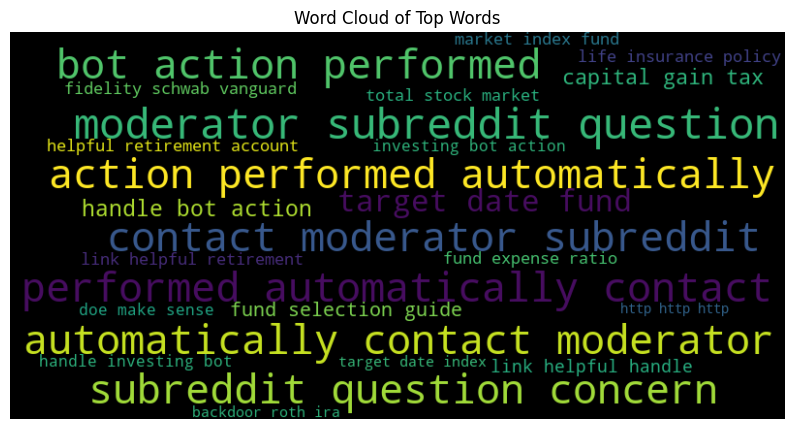

In [249]:
# Sample documents
documents = Morgan_Stanley_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['tldr'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

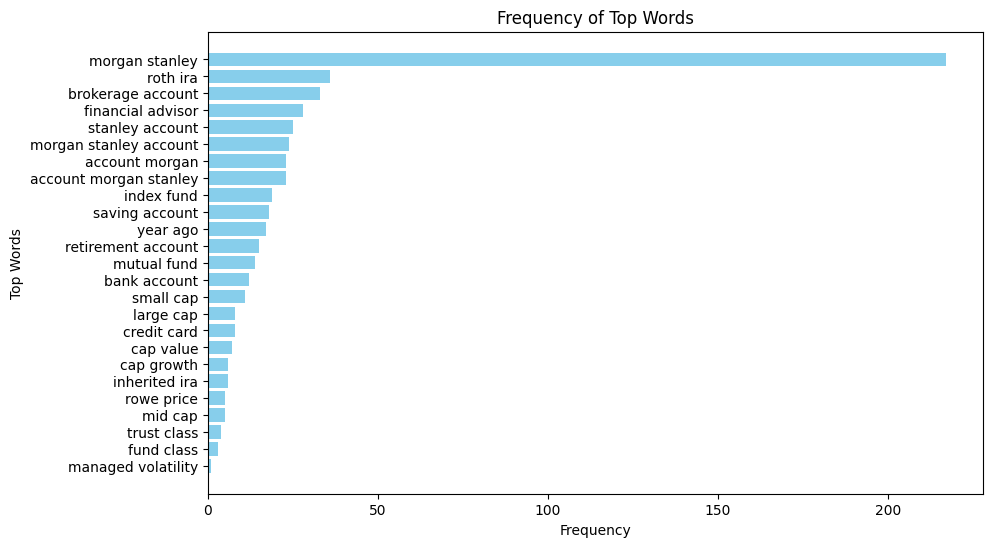

Top Words                 Frequency
----------------------  -----------
morgan stanley                  217
roth ira                         36
brokerage account                33
financial advisor                28
stanley account                  25
morgan stanley account           24
account morgan                   23
account morgan stanley           23
index fund                       19
saving account                   18
year ago                         17
retirement account               15
mutual fund                      14
bank account                     12
small cap                        11
large cap                         8
credit card                       8
cap value                         7
cap growth                        6
inherited ira                     6
rowe price                        5
mid cap                           5
trust class                       4
fund class                        3
managed volatility                1


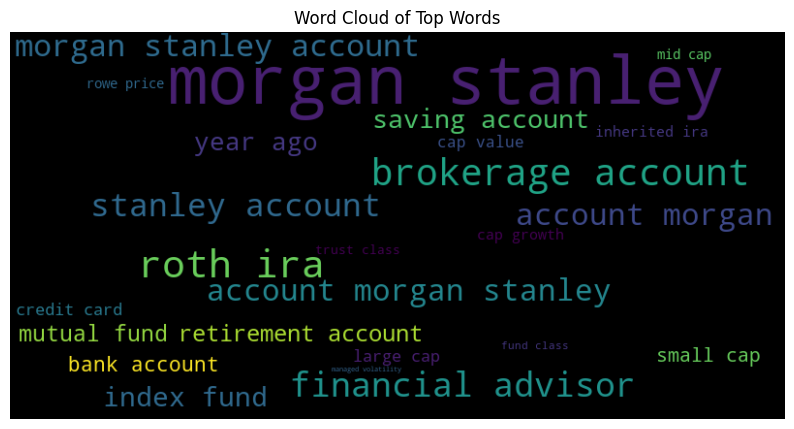

In [250]:
documents2 = Morgan_Stanley_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

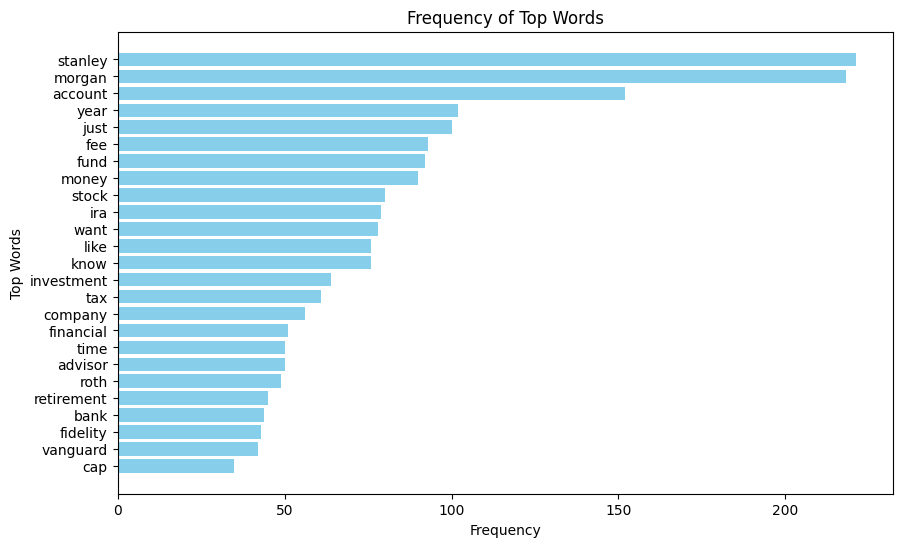

Top Words      Frequency
-----------  -----------
stanley              221
morgan               218
account              152
year                 102
just                 100
fee                   93
fund                  92
money                 90
stock                 80
ira                   79
want                  78
like                  76
know                  76
investment            64
tax                   61
company               56
financial             51
time                  50
advisor               50
roth                  49
retirement            45
bank                  44
fidelity              43
vanguard              42
cap                   35


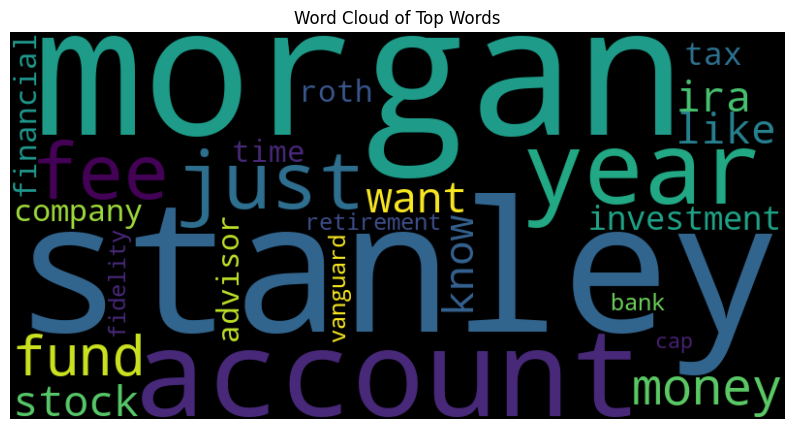

In [251]:
documents2 = Morgan_Stanley_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

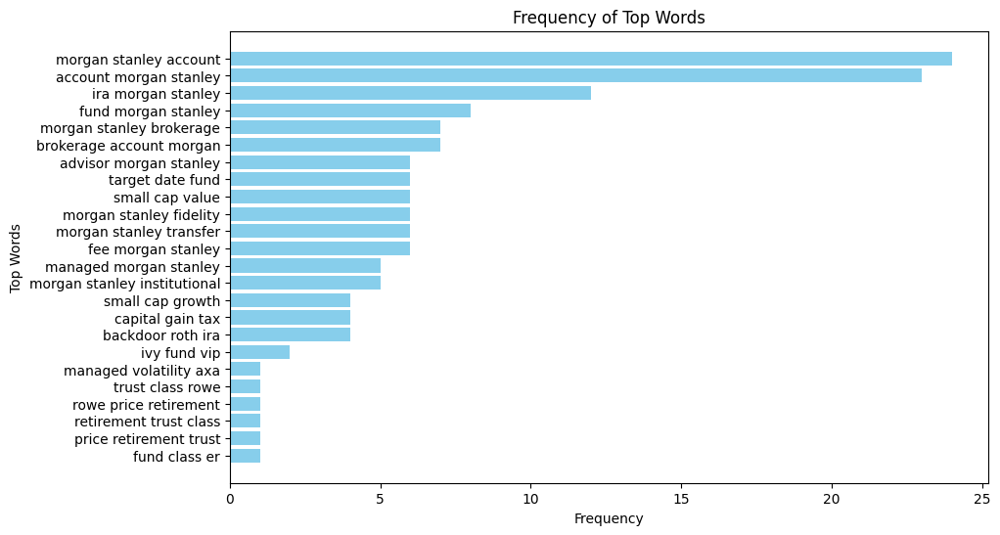

Top Words                       Frequency
----------------------------  -----------
morgan stanley account                 24
account morgan stanley                 23
ira morgan stanley                     12
fund morgan stanley                     8
morgan stanley brokerage                7
brokerage account morgan                7
advisor morgan stanley                  6
target date fund                        6
small cap value                         6
morgan stanley fidelity                 6
morgan stanley transfer                 6
fee morgan stanley                      6
managed morgan stanley                  5
morgan stanley institutional            5
small cap growth                        4
capital gain tax                        4
backdoor roth ira                       4
ivy fund vip                            2
managed volatility axa                  1
trust class rowe                        1
rowe price retirement                   1
retirement trust class            

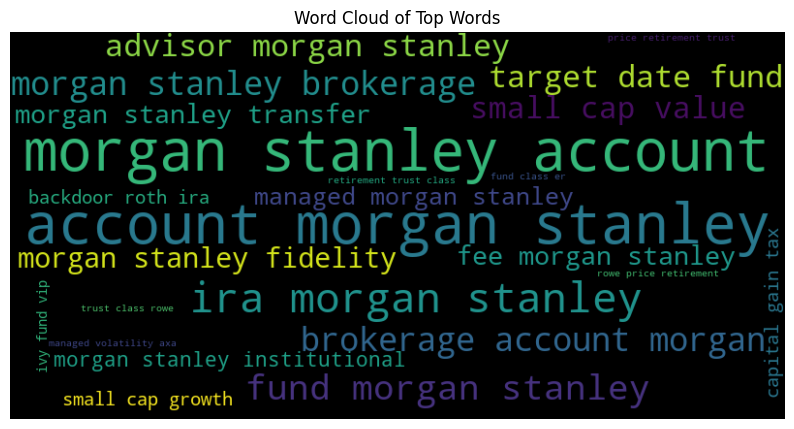

In [252]:
documents2 = Morgan_Stanley_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

## UBS Dataset

In [253]:
# Specify the element you want to filter for in the link
target_element = 'ubs'
target = ['ubs','Union Bank of Switzerland'] 

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

url_mask = df3['url'].str.contains(fr'/r/{target_element}/', case=False)

# Convert the target keywords to lowercase
lowercase_target = [keyword.lower() for keyword in target]

# Use any() to check if any element in the 'target' list is present in 'comment' and 'submission_comment'
comment_mask = df3['comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))
submission_comment_mask = df3['submission_comment'].apply(lambda x: any(keyword in x.lower() for keyword in lowercase_target))

# Combine the masks using logical OR
ubs_values = url_mask | comment_mask | submission_comment_mask

# Apply the mask to subset the DataFrame
ubs_df = df3[ubs_values]
ubs_df.drop_duplicates(inplace=True)

# Display the result
ubs_df

C:\Users\gabri\AppData\Local\Temp\ipykernel_22852\2918986804.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ubs_df.drop_duplicates(inplace=True)


,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
19,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,No Canadian banks have incoming free wire tran...,1,2023-08-01 20:15:08
20,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,RBC. They have online transfers and their priv...,1,2023-08-01 20:29:15
21,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,[Wise.com](https://Wise.com) is your best bet....,1,2023-09-13 02:30:06
22,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,"i dont need free wire transfers, i need the ab...",1,2023-08-01 21:00:58
23,best online banking / private banking options,15fsszh,spdaghost,2023-08-01 19:47:51,0,0.25,https://www.reddit.com/r/PersonalFinanceCanada...,8,1334214,Banking,"Hello, I'm looking for recommendations on who ...",https://www.reddit.com/r/PersonalFinanceCanada...,thanks ill check them out,1,2023-08-01 21:01:11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211008,Unknown Total Cost Basis on 1099-B (How to pro...,stjm7i,vonwaffle,2022-02-15 20:44:35,2,1.00,https://www.reddit.com/r/personalfinance/comme...,6,18717207,Taxes,I've been in my company's Employee Stock Purch...,https://www.reddit.com/r/personalfinance/comme...,Did you get your W-2 yet? ESPP Discounts are r...,2,2022-02-15 21:35:13
211184,What should I do with an investment inheritance?,vzun38,TheMightyZan,2022-07-15 13:45:31,1,0.67,https://www.reddit.com/r/personalfinance/comme...,14,18717207,Investing,I am inheriting investments from my grandmothe...,https://www.reddit.com/r/personalfinance/comme...,"Yes, we are doing fine without this money, and...",1,2022-07-15 14:37:57
211534,"Pursue Bachelor when I have masters, thoughts?",ekphte,edwinawc,2020-01-06 00:30:35,2,1.00,https://www.reddit.com/r/personalfinance/comme...,13,18717209,Other,"\n\nHey guys,\n\nNew here! Just call me Edwin...",https://www.reddit.com/r/personalfinance/comme...,"I think you’ll be fine.\n\nIn Canada, many uni...",2,2020-01-06 07:23:44
211628,Leave IRA or move to secure NYL ACCT?,y1ogx8,DetectiveMental,2022-10-11 19:59:05,1,1.00,https://www.reddit.com/r/personalfinance/comme...,10,18717209,Retirement,"I have an IRA with Morgan Stanley, a proven gu...",https://www.reddit.com/r/personalfinance/comme...,Unless I'm missing something you are paying th...,1,2022-10-11 20:04:42


In [254]:
# Sample documents
documents = ubs_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,8672
1,Neutral,2660
2,Negative,2371


In [255]:
documents2 = ubs_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,499
1,Negative,83
2,Neutral,20


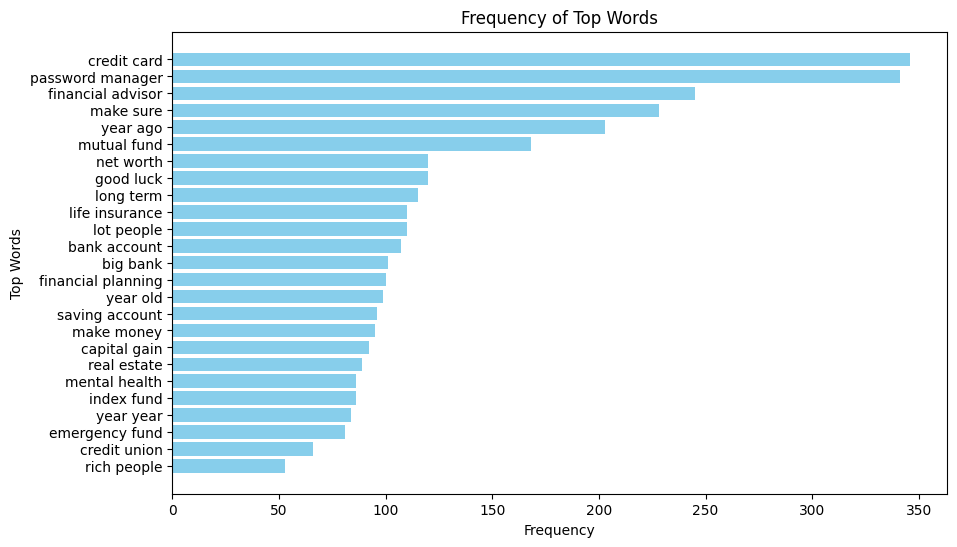

Top Words             Frequency
------------------  -----------
credit card                 346
password manager            341
financial advisor           245
make sure                   228
year ago                    203
mutual fund                 168
net worth                   120
good luck                   120
long term                   115
life insurance              110
lot people                  110
bank account                107
big bank                    101
financial planning          100
year old                     99
saving account               96
make money                   95
capital gain                 92
real estate                  89
mental health                86
index fund                   86
year year                    84
emergency fund               81
credit union                 66
rich people                  53


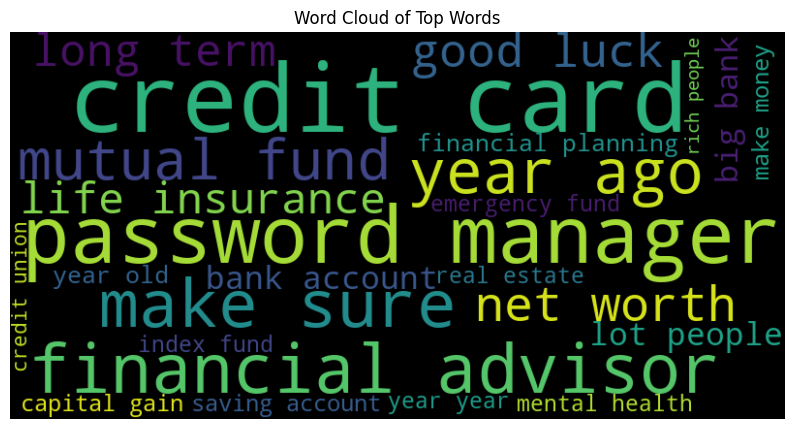

In [256]:
# Sample documents
documents = ubs_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

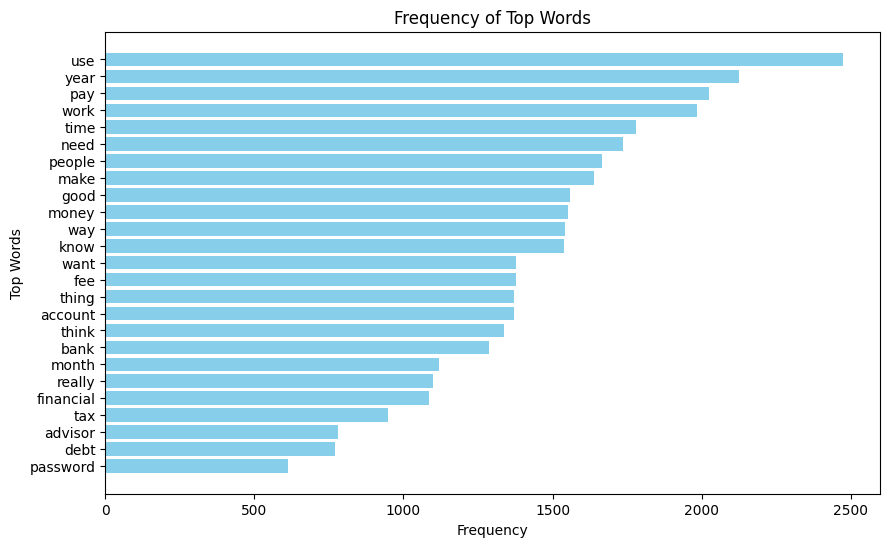

Top Words      Frequency
-----------  -----------
use                 2475
year                2124
pay                 2023
work                1984
time                1781
need                1735
people              1666
make                1640
good                1557
money               1553
way                 1543
know                1539
want                1378
fee                 1377
thing               1370
account             1369
think               1336
bank                1288
month               1118
really              1100
financial           1085
tax                  948
advisor              780
debt                 769
password             612


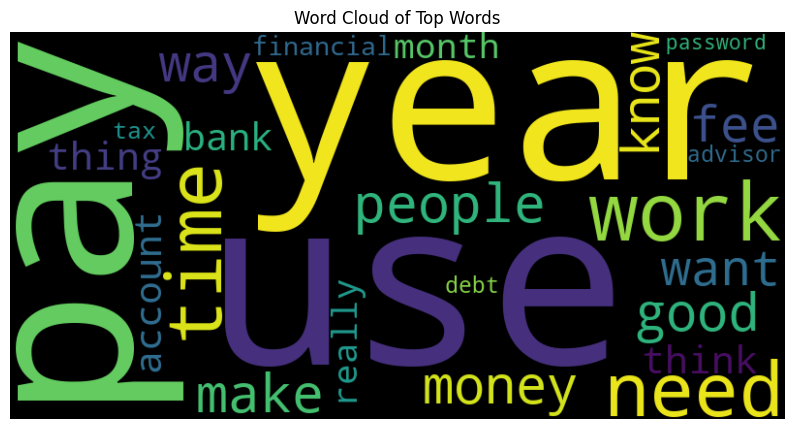

In [257]:
# Sample documents
documents = ubs_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

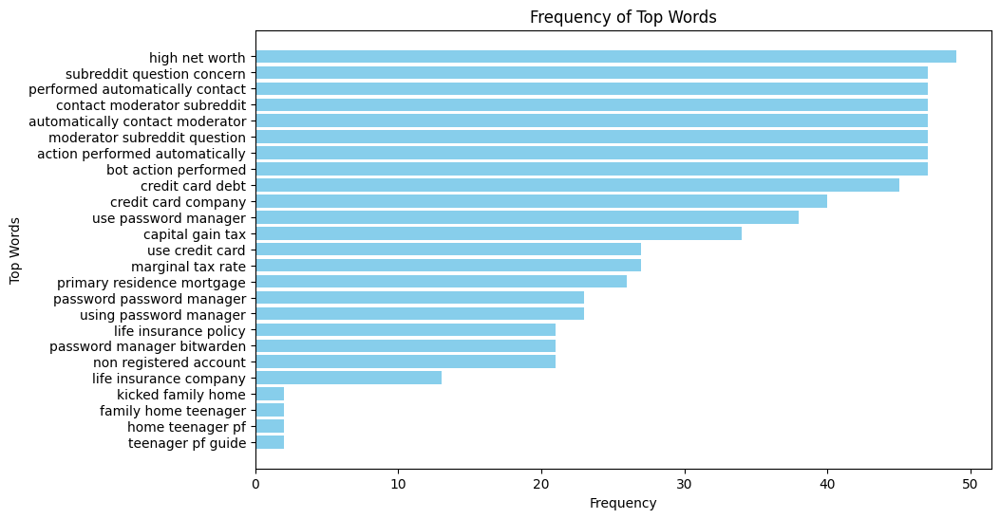

Top Words                          Frequency
-------------------------------  -----------
high net worth                            49
subreddit question concern                47
performed automatically contact           47
contact moderator subreddit               47
automatically contact moderator           47
moderator subreddit question              47
action performed automatically            47
bot action performed                      47
credit card debt                          45
credit card company                       40
use password manager                      38
capital gain tax                          34
use credit card                           27
marginal tax rate                         27
primary residence mortgage                26
password password manager                 23
using password manager                    23
life insurance policy                     21
password manager bitwarden                21
non registered account                    21
life insur

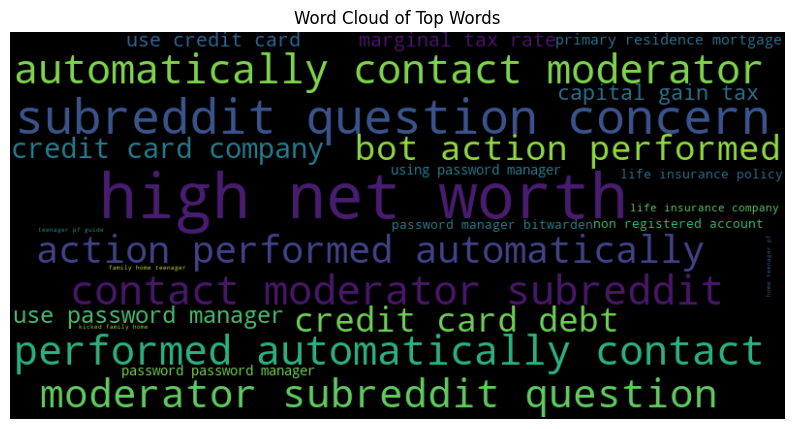

In [258]:
# Sample documents
documents = ubs_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

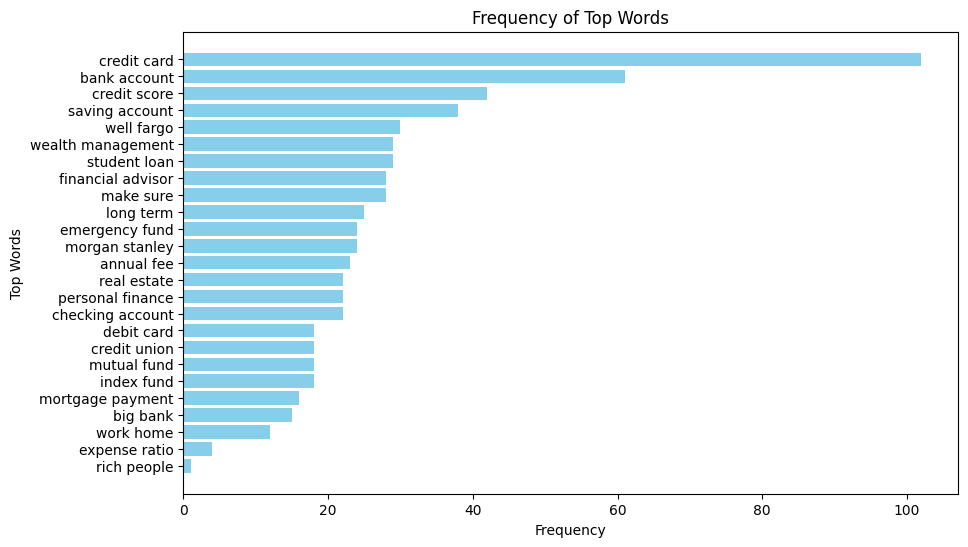

Top Words            Frequency
-----------------  -----------
credit card                102
bank account                61
credit score                42
saving account              38
well fargo                  30
wealth management           29
student loan                29
financial advisor           28
make sure                   28
long term                   25
emergency fund              24
morgan stanley              24
annual fee                  23
real estate                 22
personal finance            22
checking account            22
debit card                  18
credit union                18
mutual fund                 18
index fund                  18
mortgage payment            16
big bank                    15
work home                   12
expense ratio                4
rich people                  1


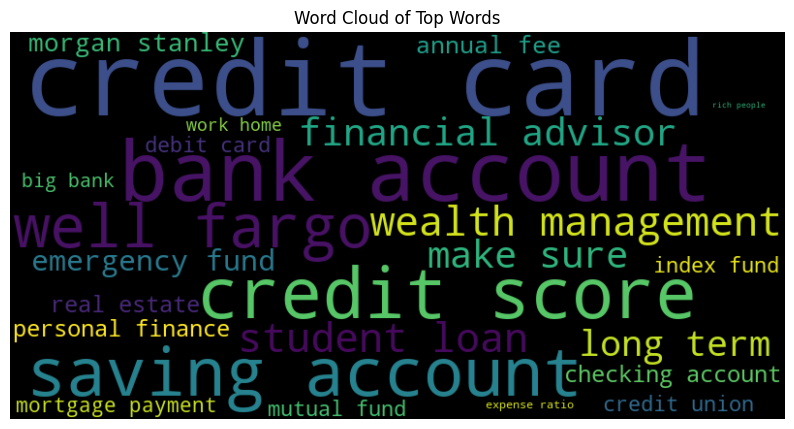

In [259]:
documents2 = ubs_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'year', 'ago', 'let', 'know'], ngram_range=(2, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

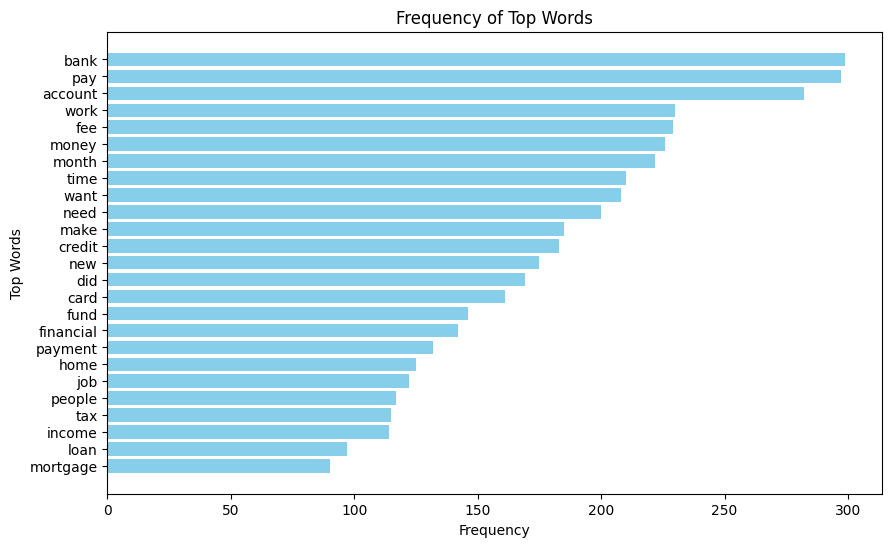

Top Words      Frequency
-----------  -----------
bank                 299
pay                  297
account              282
work                 230
fee                  229
money                226
month                222
time                 210
want                 208
need                 200
make                 185
credit               183
new                  175
did                  169
card                 161
fund                 146
financial            142
payment              132
home                 125
job                  122
people               117
tax                  115
income               114
loan                  97
mortgage              90


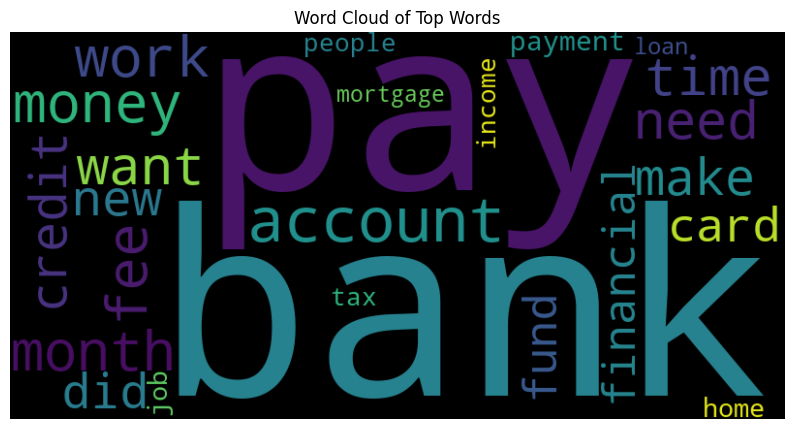

In [260]:
documents2 = ubs_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'year', 'ago', 'let', 'know'], ngram_range=(1, 1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

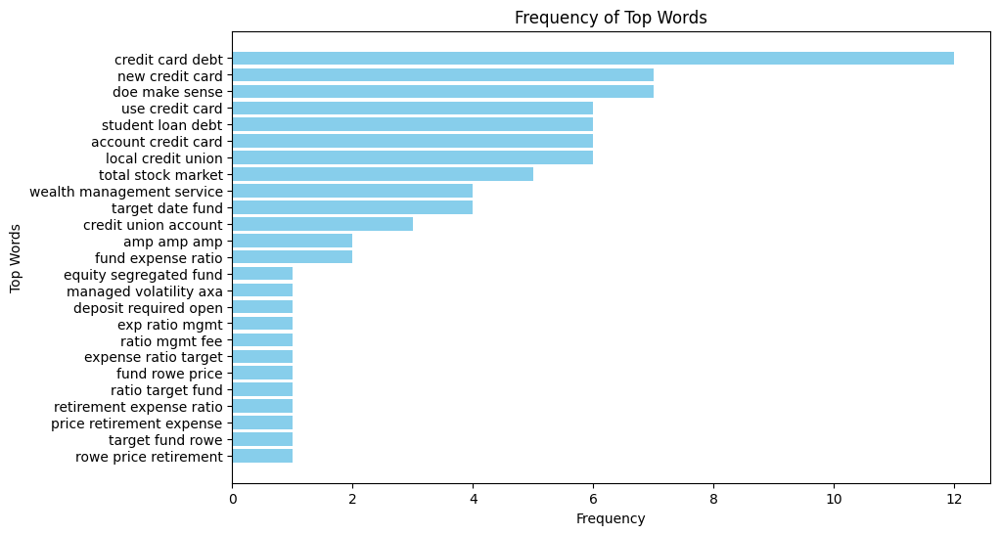

Top Words                    Frequency
-------------------------  -----------
credit card debt                    12
new credit card                      7
doe make sense                       7
use credit card                      6
student loan debt                    6
account credit card                  6
local credit union                   6
total stock market                   5
wealth management service            4
target date fund                     4
credit union account                 3
amp amp amp                          2
fund expense ratio                   2
equity segregated fund               1
managed volatility axa               1
deposit required open                1
exp ratio mgmt                       1
ratio mgmt fee                       1
expense ratio target                 1
fund rowe price                      1
ratio target fund                    1
retirement expense ratio             1
price retirement expense             1
target fund rowe         

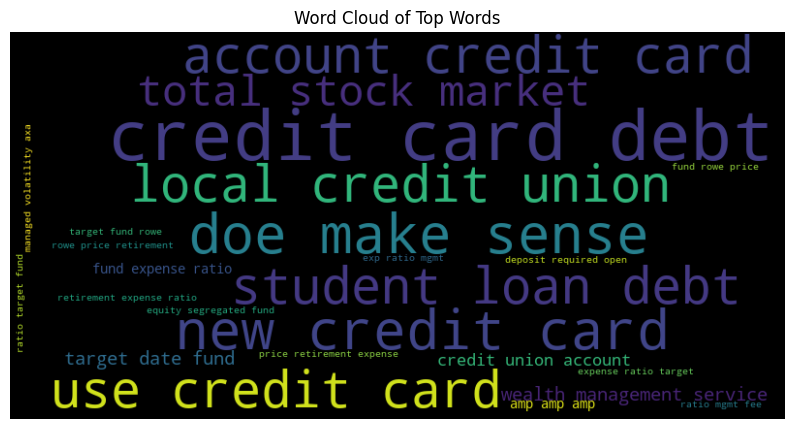

In [261]:
documents2 = ubs_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'year', 'ago', 'let', 'know'], ngram_range=(3, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

# Credit Card

In [262]:
# Specify the element you want to filter for in the link
target_element = 'Credit Card'

# Reset the index to avoid duplicate index labels
df3 = df3.reset_index(drop=True)

# Use str.contains() with a regular expression to create a boolean mask
Credit_Card_values = df3['url'].str.contains(fr'/r/{target_element}/', case=False) | df3['comment'].str.contains(target_element, case=False) | df3['submission_comment'].str.contains(target_element, case=False)

# Apply the mask to subset the DataFrame
Credit_Card_df = df3[Credit_Card_values]

# Display the result
Credit_Card_df

,title,post_id,author,submission_date,score,upvote_ratio,url,num_comments,subreddit_subscribers,link_flair_text,submission_comment,comment_link,comment,comment_score,comment_created_date
0,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,"> I have an 800k mortgage, abt 900k self direc...",21,2024-01-06 19:27:20
1,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Sadly with what you have listed you are not a ...,24,2024-01-06 21:54:10
2,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,It’s worth it for the banks.,6,2024-01-06 20:03:49
3,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,My cousin worked in private banking at Scotia....,6,2024-01-06 19:06:26
4,Private Banking - Is it worth it ?,190dzo1,samTun09,2024-01-06 18:51:52,6,0.69,https://www.reddit.com/r/PersonalFinanceCanada...,20,1334214,Banking,I’m on a private banking plan with RBC. They w...,https://www.reddit.com/r/PersonalFinanceCanada...,Private banking could be free if you have all ...,3,2024-01-06 19:06:50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211727,28 y/o.. Help Me With My Financial Plan & Inhe...,9f0om7,i-need-advice-1,2018-09-11 15:41:38,1,1.00,https://www.reddit.com/r/personalfinance/comme...,13,18717209,Investing,"Hi all,\n\nAfter reading a lot of information ...",https://www.reddit.com/r/personalfinance/comme...,When your income is too high to make direct co...,2,2018-09-12 06:52:16
211728,28 y/o.. Help Me With My Financial Plan & Inhe...,9f0om7,i-need-advice-1,2018-09-11 15:41:38,1,1.00,https://www.reddit.com/r/personalfinance/comme...,13,18717209,Investing,"Hi all,\n\nAfter reading a lot of information ...",https://www.reddit.com/r/personalfinance/comme...,Thanks - I am going to do the following break-...,1,2018-09-12 02:15:03
211729,28 y/o.. Help Me With My Financial Plan & Inhe...,9f0om7,i-need-advice-1,2018-09-11 15:41:38,1,1.00,https://www.reddit.com/r/personalfinance/comme...,13,18717209,Investing,"Hi all,\n\nAfter reading a lot of information ...",https://www.reddit.com/r/personalfinance/comme...,People sometimes analogize paying down debt as...,1,2018-09-12 10:37:23
211730,28 y/o.. Help Me With My Financial Plan & Inhe...,9f0om7,i-need-advice-1,2018-09-11 15:41:38,1,1.00,https://www.reddit.com/r/personalfinance/comme...,13,18717209,Investing,"Hi all,\n\nAfter reading a lot of information ...",https://www.reddit.com/r/personalfinance/comme...,Thanks for the follow-up. I get the explanatio...,1,2018-09-12 12:20:28


In [263]:
# Sample documents
documents = Credit_Card_df['comment'].tolist()

def analyze_sentiment(documents):
    sentiments = []
    for text in documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,22318
1,Neutral,8410
2,Negative,7708


In [264]:
documents2 = Credit_Card_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

def analyze_sentiment(new_documents):
    sentiments = []
    for text in new_documents:
        # Create a TextBlob object for each document
        blob = TextBlob(text)
        # Get the sentiment polarity (-1 to 1 where -1 is negative, 0 is neutral, and 1 is positive)
        sentiment_score = blob.sentiment.polarity
        # Classify sentiment based on the score
        if sentiment_score > 0:
            sentiments.append("Positive")
        elif sentiment_score == 0:
            sentiments.append("Neutral")
        else:
            sentiments.append("Negative")
    return sentiments

sentiments = analyze_sentiment(new_documents)

# Count the occurrences of each sentiment
sentiment_counts = pd.Series(sentiments).value_counts()

# Create a DataFrame to display the counts
sentiment_table = pd.DataFrame({
    'Sentiment': sentiment_counts.index,
    'Count': sentiment_counts.values
})

display(sentiment_table)

,Sentiment,Count
0,Positive,1030
1,Negative,253
2,Neutral,59


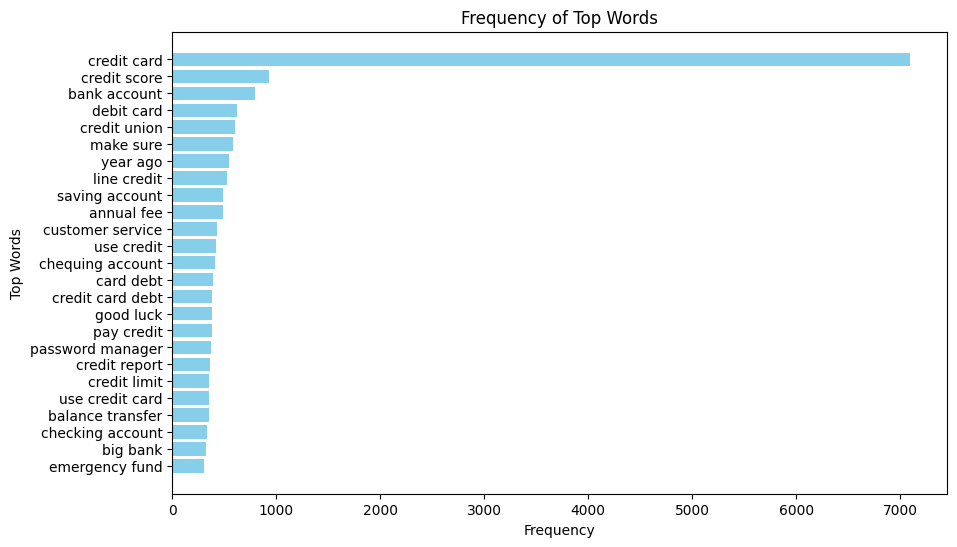

Top Words           Frequency
----------------  -----------
credit card              7099
credit score              932
bank account              792
debit card                627
credit union              601
make sure                 588
year ago                  541
line credit               523
saving account            485
annual fee                485
customer service          429
use credit                420
chequing account          410
card debt                 396
credit card debt          384
good luck                 383
pay credit                381
password manager          373
credit report             366
credit limit              356
use credit card           355
balance transfer          350
checking account          334
big bank                  327
emergency fund            305


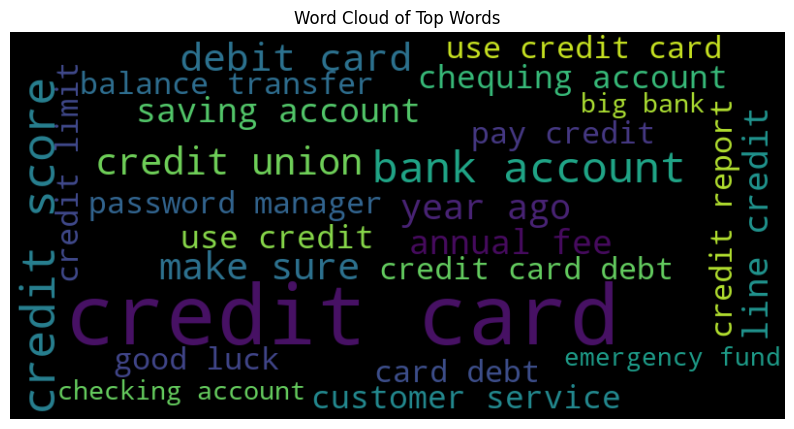

In [265]:
# Sample documents
documents = Credit_Card_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(2,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

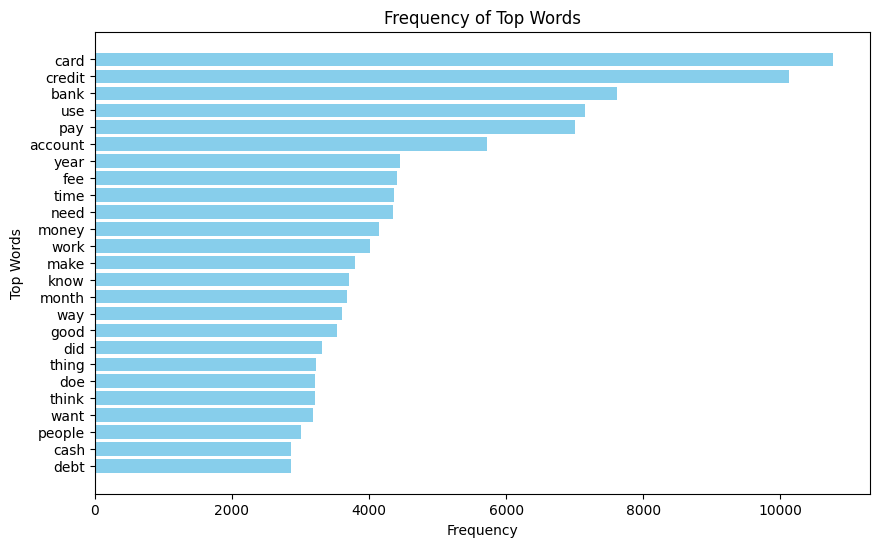

Top Words      Frequency
-----------  -----------
card               10763
credit             10126
bank                7616
use                 7151
pay                 7009
account             5721
year                4453
fee                 4402
time                4366
need                4347
money               4140
work                4022
make                3791
know                3706
month               3677
way                 3606
good                3537
did                 3318
thing               3230
doe                 3218
think               3208
want                3189
people              3002
cash                2868
debt                2864


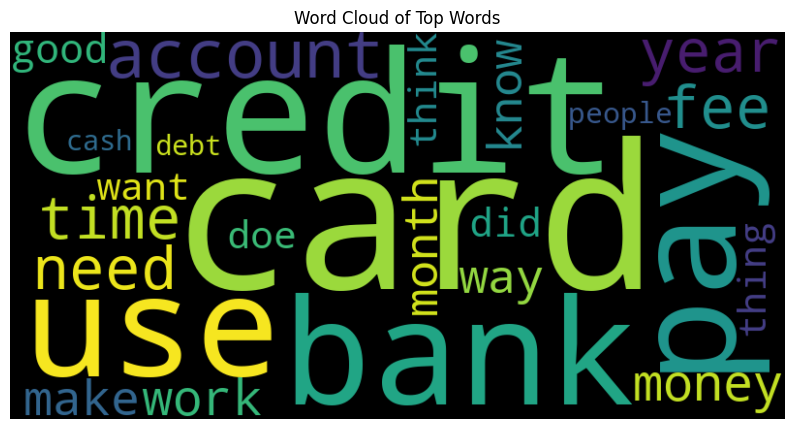

In [266]:
# Sample documents
documents = Credit_Card_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(1,1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

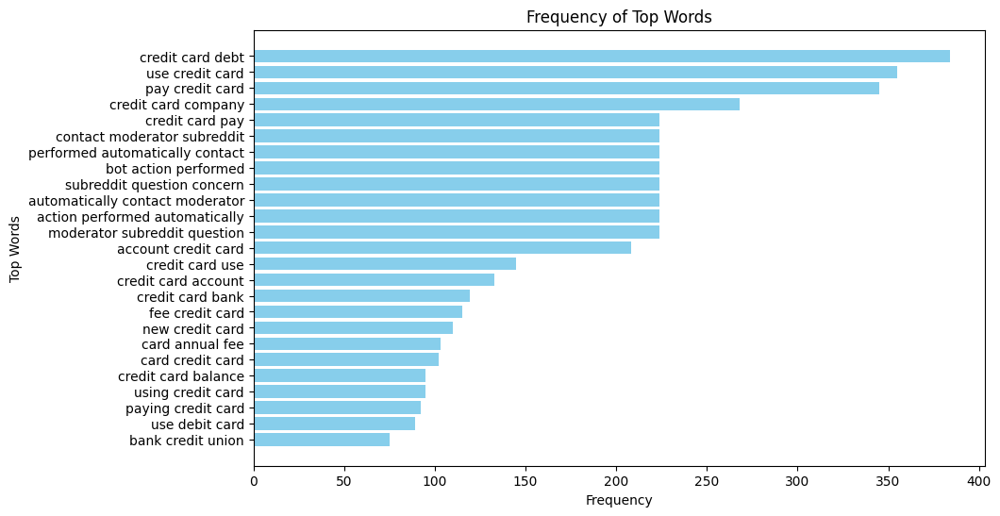

Top Words                          Frequency
-------------------------------  -----------
credit card debt                         384
use credit card                          355
pay credit card                          345
credit card company                      268
credit card pay                          224
contact moderator subreddit              224
performed automatically contact          224
bot action performed                     224
subreddit question concern               224
automatically contact moderator          224
action performed automatically           224
moderator subreddit question             224
account credit card                      208
credit card use                          145
credit card account                      133
credit card bank                         119
fee credit card                          115
new credit card                          110
card annual fee                          103
card credit card                         102
credit car

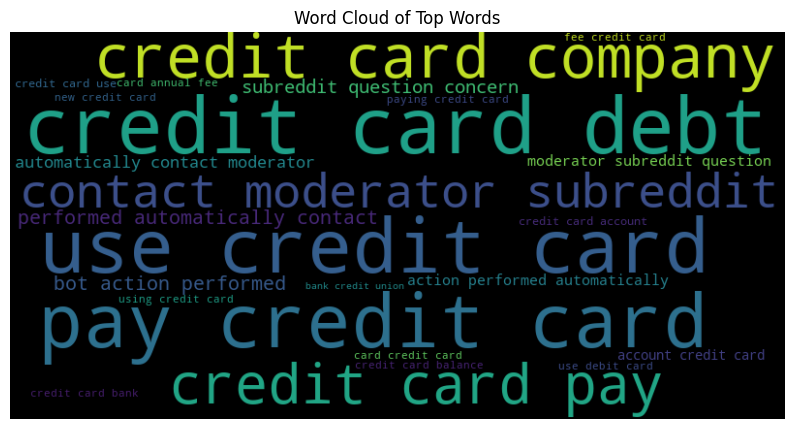

In [267]:
# Sample documents
documents = Credit_Card_df['comment'].tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['just', 'like', 'http', 'sense'], ngram_range=(3,3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

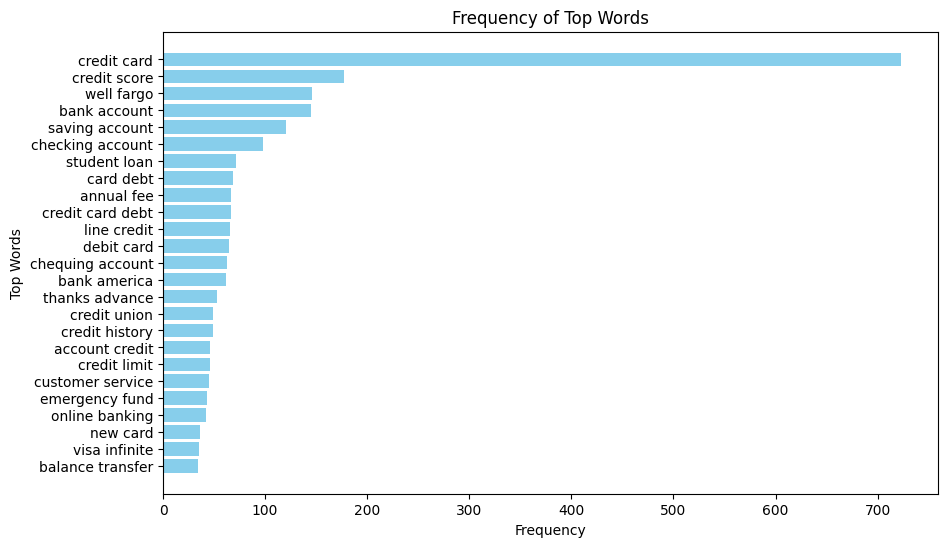

Top Words           Frequency
----------------  -----------
credit card               723
credit score              177
well fargo                146
bank account              145
saving account            120
checking account           98
student loan               71
card debt                  69
annual fee                 67
credit card debt           67
line credit                66
debit card                 65
chequing account           63
bank america               62
thanks advance             53
credit union               49
credit history             49
account credit             46
credit limit               46
customer service           45
emergency fund             43
online banking             42
new card                   36
visa infinite              35
balance transfer           34


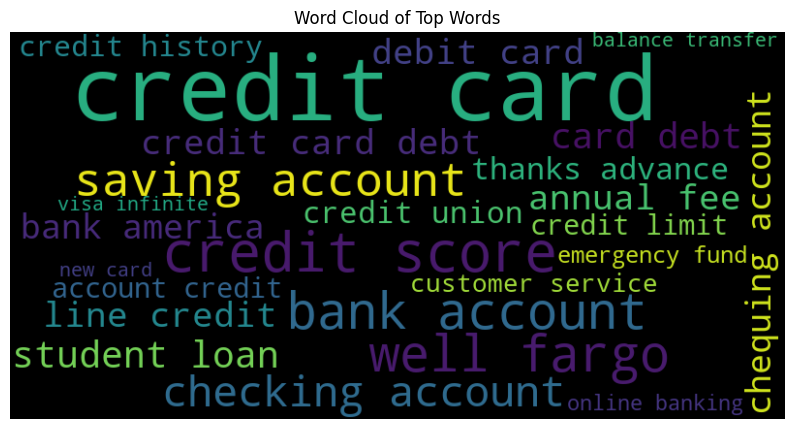

In [268]:
documents2 = Credit_Card_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'year', 'ago', 'let', 'know'], ngram_range=(2, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

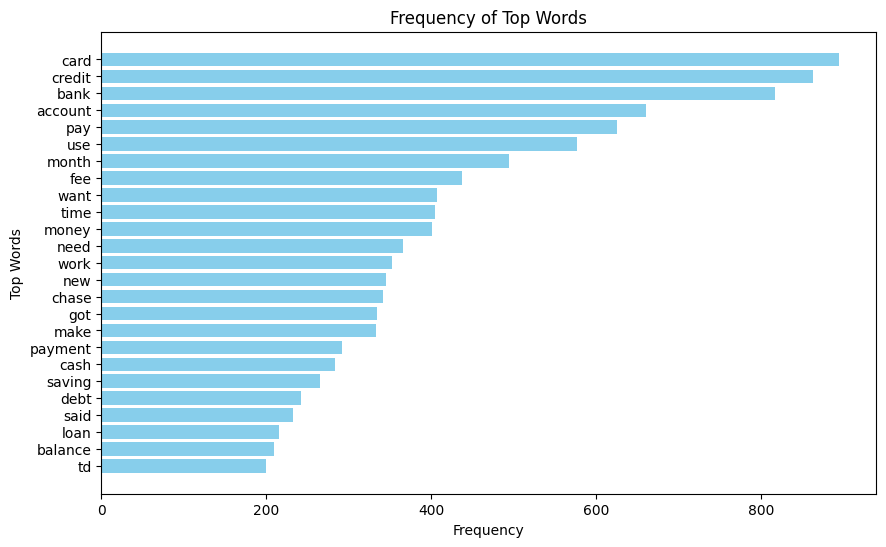

Top Words      Frequency
-----------  -----------
card                 895
credit               863
bank                 817
account              661
pay                  625
use                  577
month                494
fee                  437
want                 407
time                 405
money                401
need                 366
work                 352
new                  345
chase                342
got                  334
make                 333
payment              292
cash                 283
saving               265
debt                 242
said                 233
loan                 216
balance              210
td                   200


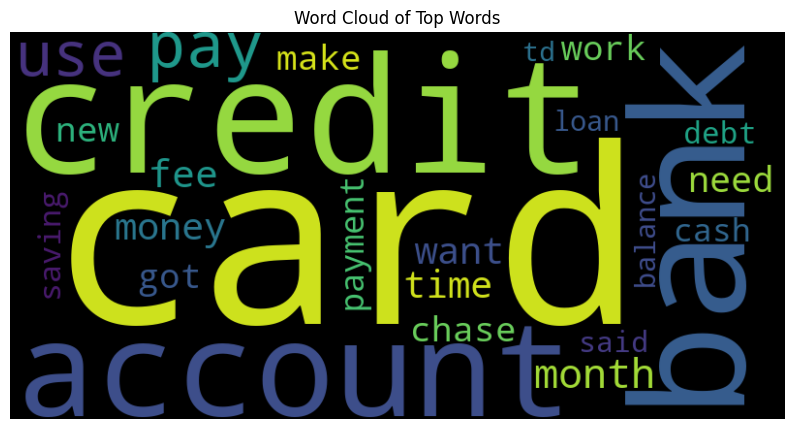

In [269]:
documents2 = Credit_Card_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'year', 'ago', 'let', 'know'], ngram_range=(1, 1))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()

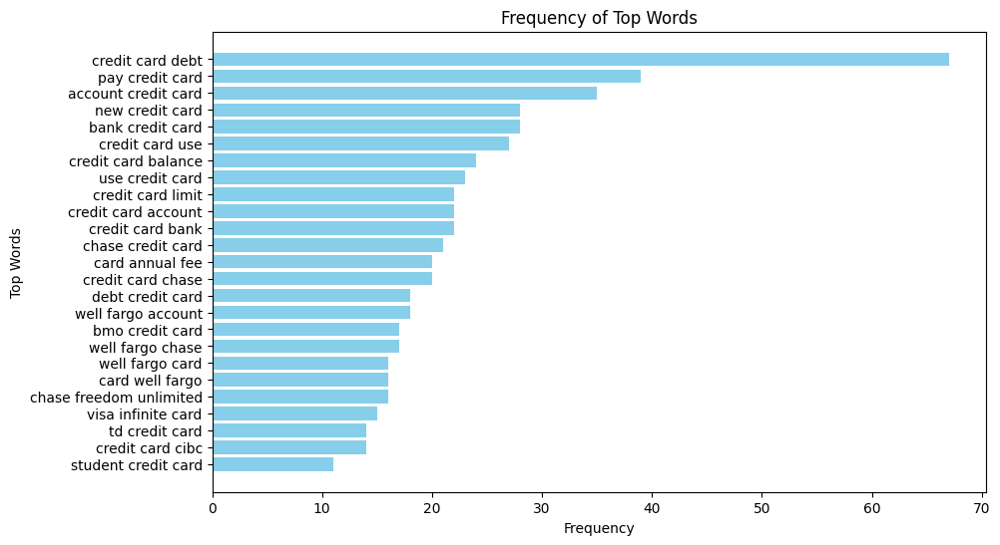

Top Words                  Frequency
-----------------------  -----------
credit card debt                  67
pay credit card                   39
account credit card               35
new credit card                   28
bank credit card                  28
credit card use                   27
credit card balance               24
use credit card                   23
credit card limit                 22
credit card account               22
credit card bank                  22
chase credit card                 21
card annual fee                   20
credit card chase                 20
debt credit card                  18
well fargo account                18
bmo credit card                   17
well fargo chase                  17
well fargo card                   16
card well fargo                   16
chase freedom unlimited           16
visa infinite card                15
td credit card                    14
credit card cibc                  14
student credit card               11


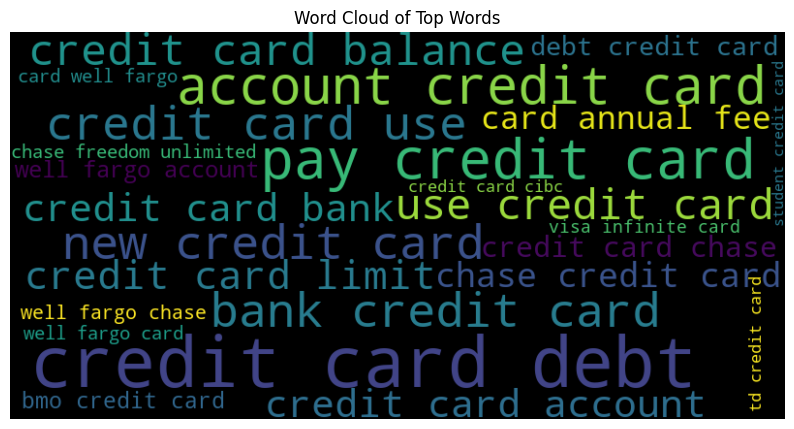

In [270]:
documents2 = Credit_Card_df['submission_comment']
documents2_unique = documents2.drop_duplicates()

# Sample documents
new_documents = documents2_unique.tolist()

# Text preprocessing function
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    
    # Removing punctuation and lowercasing
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Removing stop words
    stop_words = set(ENGLISH_STOP_WORDS)
    tokens = [word for word in tokens if word not in stop_words]
    
    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]
    
    return ' '.join(tokens)

# Preprocess the documents
preprocessed_documents = [preprocess_text(doc) for doc in new_documents]

# Create a pipeline with CountVectorizer and LatentDirichletAllocation
num_topics = 1
pipeline = Pipeline([
    ('vect', CountVectorizer(stop_words=['like', 'just', 'http', 'year', 'ago', 'let', 'know'], ngram_range=(3, 3))),
    ('lda', LatentDirichletAllocation(n_components=num_topics, random_state=42)),
])

# Fit the pipeline on the preprocessed data
pipeline.fit(preprocessed_documents)

# Get the top words for each topic
feature_names = pipeline.named_steps['vect'].get_feature_names_out()
lda_components = pipeline.named_steps['lda'].components_
top_words_per_topic = []

for topic_weights in lda_components:
    top_word_indices = topic_weights.argsort()[-25:][::-1]
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

# Count the frequency of each top word within each document
top_word_counts = {}

for doc in preprocessed_documents:
    for top_words in top_words_per_topic:
        for word in top_words:
            if word in doc:
                if word in top_word_counts:
                    top_word_counts[word] += 1
                else:
                    top_word_counts[word] = 1

# Sort the top words by frequency
sorted_top_words = sorted(top_word_counts.items(), key=lambda x: x[1], reverse=True)

# Extract top words and their frequencies
top_words = [word for word, count in sorted_top_words]
word_frequencies = [count for word, count in sorted_top_words]

# Plot the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(top_words)), word_frequencies, color='skyblue')
plt.yticks(range(len(top_words)), labels=top_words)
plt.xlabel('Frequency')
plt.ylabel('Top Words')
plt.title('Frequency of Top Words')
plt.gca().invert_yaxis()  # Invert y-axis to have the most frequent word on top
plt.show()

# Create a table
table_data = [(word, freq) for word, freq in zip(top_words, word_frequencies)]

# Print the table
print(tabulate(table_data, headers=['Top Words', 'Frequency']))

# Combine top words and their frequencies into a dictionary
word_freq_dict = {word: freq for word, freq in zip(top_words, word_frequencies)}

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Top Words')
plt.show()